In [94]:
import pandas as pd

In [95]:
AD_panda = pd.read_csv('../../Data/GRN_output/AD/output_panda_df.csv')

In [96]:
AD_panda

,tf,gene,motif,force
0,ENSG00000153879,ENSG00000153132,1.0,29.401874
1,ENSG00000221869,ENSG00000153132,1.0,29.280419
2,ENSG00000153879,ENSG00000130770,1.0,29.234309
3,ENSG00000153879,ENSG00000083307,1.0,29.130140
4,ENSG00000221869,ENSG00000130770,1.0,29.105434
...,...,...,...,...
12192825,ENSG00000180855,ENSG00000092148,0.0,-3.078133
12192826,ENSG00000197841,ENSG00000153823,0.0,-3.099024
12192827,ENSG00000162714,ENSG00000153823,0.0,-3.118035
12192828,ENSG00000180855,ENSG00000105983,0.0,-3.126562


In [97]:
AD_panda.sort_values(by = 'force', ascending=False)

,tf,gene,motif,force
0,ENSG00000153879,ENSG00000153132,1.0,29.401874
1,ENSG00000221869,ENSG00000153132,1.0,29.280419
2,ENSG00000153879,ENSG00000130770,1.0,29.234309
3,ENSG00000153879,ENSG00000083307,1.0,29.130140
4,ENSG00000221869,ENSG00000130770,1.0,29.105434
...,...,...,...,...
12192825,ENSG00000180855,ENSG00000092148,0.0,-3.078133
12192826,ENSG00000197841,ENSG00000153823,0.0,-3.099024
12192827,ENSG00000162714,ENSG00000153823,0.0,-3.118035
12192828,ENSG00000180855,ENSG00000105983,0.0,-3.126562


In [98]:
len(set(AD_panda.tf))

710

In [99]:
len(set(AD_panda.gene))

17173

/Users/anwer/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/anwer/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


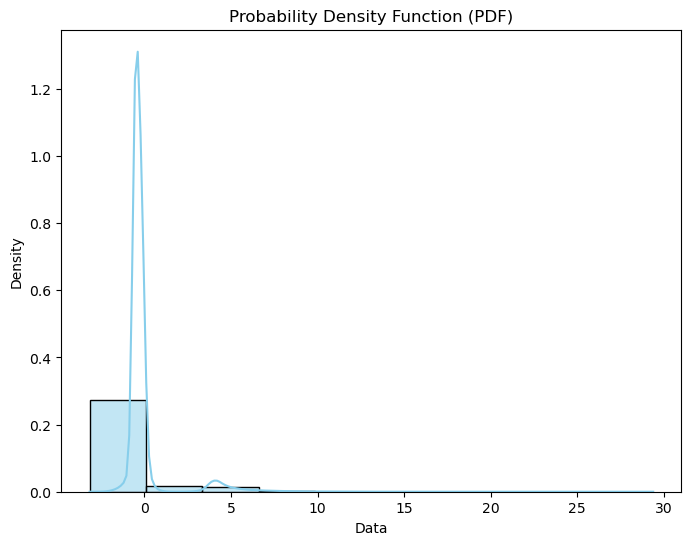

In [100]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))

# Plot PDF using seaborn
sns.histplot(AD_panda['force'], kde=True, stat='density', bins=10, color='skyblue')

# Display the plot
plt.title('Probability Density Function (PDF)')
plt.xlabel('Data')
plt.ylabel('Density')
plt.show()


/Users/anwer/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/anwer/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


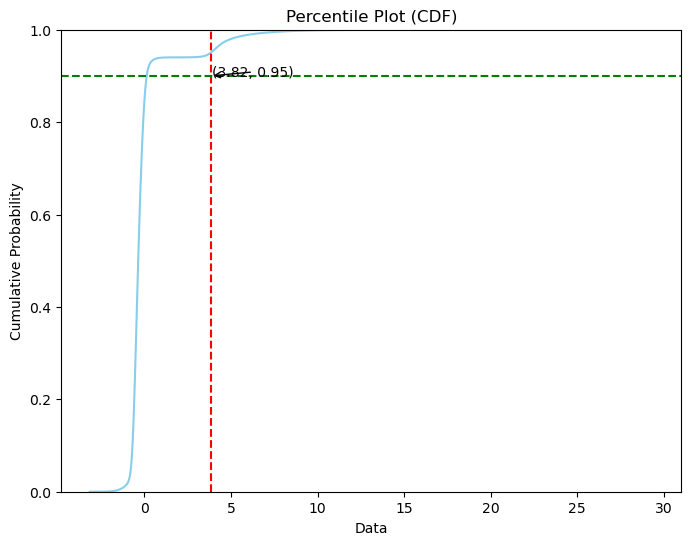

In [101]:

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import numpy as np
# Set the plot size
plt.figure(figsize=(8, 6))

# Plot percentile plot using seaborn
sns.ecdfplot(AD_panda['force'], color='skyblue')


percentile_95 = np.percentile(AD_panda['force'], 95)

plt.axvline(x=percentile_95, color='red', linestyle='--', label='90th Percentile')
plt.axhline(y=0.9, color='green', linestyle='--')

# Annotate the point on the plot
plt.annotate(f'({percentile_95:.2f}, 0.95)', xy=(percentile_95, 0.9), xytext=(percentile_95 + 0.1, 0.9),
             arrowprops=dict(facecolor='black', arrowstyle='->'))
# Display the plot
plt.title('Percentile Plot (CDF)')
plt.xlabel('Data')
plt.ylabel('Cumulative Probability')
plt.show()

In [102]:
percentile_95 

3.8211130468668886

In [103]:
AD_panda_top_5 = AD_panda[AD_panda.force>=3.82111]
AD_panda_top_5

,tf,gene,motif,force
0,ENSG00000153879,ENSG00000153132,1.0,29.401874
1,ENSG00000221869,ENSG00000153132,1.0,29.280419
2,ENSG00000153879,ENSG00000130770,1.0,29.234309
3,ENSG00000153879,ENSG00000083307,1.0,29.130140
4,ENSG00000221869,ENSG00000130770,1.0,29.105434
...,...,...,...,...
609637,ENSG00000185947,ENSG00000106462,1.0,3.821121
609638,ENSG00000162702,ENSG00000248489,1.0,3.821120
609639,ENSG00000181666,ENSG00000240370,1.0,3.821120
609640,ENSG00000181666,ENSG00000132793,1.0,3.821116


In [105]:
len(set(AD_panda_top_5.tf).intersection(set(AD_panda_top_5.gene)))

710

In [129]:
'ENSG00000084093' in set(AD_panda_top_5.tf)

True

In [109]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from tqdm import tqdm


# Create a weighted bipartite graph
AD_BG = nx.Graph()
AD_BG.add_nodes_from(AD_panda_top_5['tf'])
AD_BG.add_nodes_from(AD_panda_top_5['gene'])

# Add weighted edges
edges = [(row['tf'], row['gene'], {'weight': row['force']}) for idx, row in tqdm(AD_panda_top_5.iterrows())]
AD_BG.add_edges_from(edges)

609642it [00:08, 69481.47it/s]


In [113]:
# Plot the weighted bipartite graph
edges

[('ENSG00000153879', 'ENSG00000153132', {'weight': 29.40187386129232}),
 ('ENSG00000221869', 'ENSG00000153132', {'weight': 29.280419485688753}),
 ('ENSG00000153879', 'ENSG00000130770', {'weight': 29.234308508386817}),
 ('ENSG00000153879', 'ENSG00000083307', {'weight': 29.1301402415962}),
 ('ENSG00000221869', 'ENSG00000130770', {'weight': 29.105434372887757}),
 ('ENSG00000221869', 'ENSG00000083307', {'weight': 29.01021331129794}),
 ('ENSG00000153879', 'ENSG00000196951', {'weight': 28.517844813653927}),
 ('ENSG00000221869', 'ENSG00000196951', {'weight': 28.502299565266696}),
 ('ENSG00000172216', 'ENSG00000042980', {'weight': 28.33756398768611}),
 ('ENSG00000153879', 'ENSG00000145088', {'weight': 28.20017674729682}),
 ('ENSG00000153879', 'ENSG00000103152', {'weight': 28.119266967424753}),
 ('ENSG00000221869', 'ENSG00000145088', {'weight': 28.11724473621259}),
 ('ENSG00000153879', 'ENSG00000198626', {'weight': 28.08279968703651}),
 ('ENSG00000221869', 'ENSG00000103152', {'weight': 28.04783

In [111]:
AD_panda_top_5

,tf,gene,motif,force
0,ENSG00000153879,ENSG00000153132,1.0,29.401874
1,ENSG00000221869,ENSG00000153132,1.0,29.280419
2,ENSG00000153879,ENSG00000130770,1.0,29.234309
3,ENSG00000153879,ENSG00000083307,1.0,29.130140
4,ENSG00000221869,ENSG00000130770,1.0,29.105434
...,...,...,...,...
609637,ENSG00000185947,ENSG00000106462,1.0,3.821121
609638,ENSG00000162702,ENSG00000248489,1.0,3.821120
609639,ENSG00000181666,ENSG00000240370,1.0,3.821120
609640,ENSG00000181666,ENSG00000132793,1.0,3.821116


In [114]:
AD_BG.edges()

EdgeView([('ENSG00000153879', 'ENSG00000153132'), ('ENSG00000153879', 'ENSG00000130770'), ('ENSG00000153879', 'ENSG00000083307'), ('ENSG00000153879', 'ENSG00000196951'), ('ENSG00000153879', 'ENSG00000145088'), ('ENSG00000153879', 'ENSG00000103152'), ('ENSG00000153879', 'ENSG00000198626'), ('ENSG00000153879', 'ENSG00000271869'), ('ENSG00000153879', 'ENSG00000011376'), ('ENSG00000153879', 'ENSG00000100321'), ('ENSG00000153879', 'ENSG00000112033'), ('ENSG00000153879', 'ENSG00000128604'), ('ENSG00000153879', 'ENSG00000172273'), ('ENSG00000153879', 'ENSG00000171291'), ('ENSG00000153879', 'ENSG00000173258'), ('ENSG00000153879', 'ENSG00000100811'), ('ENSG00000153879', 'ENSG00000197020'), ('ENSG00000153879', 'ENSG00000066136'), ('ENSG00000153879', 'ENSG00000130816'), ('ENSG00000153879', 'ENSG00000182318'), ('ENSG00000153879', 'ENSG00000167384'), ('ENSG00000153879', 'ENSG00000180884'), ('ENSG00000153879', 'ENSG00000198081'), ('ENSG00000153879', 'ENSG00000120693'), ('ENSG00000153879', 'ENSG00000

In [116]:
nx.average_clustering(AD_BG)

0.24048739737417618

In [118]:
list_of_tf = list(set(AD_panda_top_5.tf))

In [119]:
AD_panda_top_5_bipartite_complete = AD_panda_top_5[~AD_panda_top_5.gene.isin(list_of_tf)]

In [159]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from tqdm import tqdm


# Create a weighted bipartite graph
AD_BG_bipartite = nx.Graph()
AD_BG_bipartite.add_nodes_from(AD_panda_top_5_bipartite_complete['tf'], bipartite = 0)
AD_BG_bipartite.add_nodes_from(AD_panda_top_5_bipartite_complete['gene'], bipartite = 1)

# Add weighted edges
edges = [(row['tf'], row['gene'], {'weight': row['force']}) for idx, row in tqdm(AD_panda_top_5_bipartite_complete.iterrows())]
AD_BG_bipartite.add_edges_from(edges)

# Sample DataFrame

582668it [00:07, 74209.30it/s]


In [162]:
AD_BG_degree_weights = dict(AD_BG_bipartite.degree(weight = 'weight'))

In [163]:

print(AD_BG_bipartite.degree(weight = 'weight')['ENSG00000142192'])

211.84339959447797


In [164]:
sorted_dict = dict(sorted(AD_BG_degree_weights.items(), key=lambda item: item[1], reverse=True))

In [165]:
sorted_dict 

{'ENSG00000131845': 26700.10982224767,
 'ENSG00000160685': 26199.987440114903,
 'ENSG00000180479': 25716.855706470444,
 'ENSG00000131061': 25510.023310497785,
 'ENSG00000186020': 25470.212306186924,
 'ENSG00000167384': 24937.67115448487,
 'ENSG00000188283': 23705.76131961148,
 'ENSG00000105866': 23215.251693446586,
 'ENSG00000163848': 23017.521702874456,
 'ENSG00000180884': 22108.224814589892,
 'ENSG00000185591': 21638.197873851866,
 'ENSG00000196391': 20972.721923139106,
 'ENSG00000221923': 20650.23619049132,
 'ENSG00000006194': 19592.624716815513,
 'ENSG00000167637': 19375.339022452834,
 'ENSG00000188785': 19250.059512378928,
 'ENSG00000198146': 19199.60897851663,
 'ENSG00000180855': 19102.54703626981,
 'ENSG00000185947': 19097.823705592284,
 'ENSG00000184635': 19040.758611993202,
 'ENSG00000162702': 19023.655754176718,
 'ENSG00000197841': 18937.105480024322,
 'ENSG00000181666': 18844.52308154126,
 'ENSG00000118263': 18252.451745733262,
 'ENSG00000197961': 17877.58493454949,
 'ENSG00

In [143]:
NCI_panda = pd.read_csv('../../Data/GRN_output/NCI//output_panda_df.csv')

In [145]:
NCI_panda.sort_values(by = 'force', ascending=False)

,tf,gene,motif,force
0,ENSG00000153879,ENSG00000153132,1.0,29.413633
1,ENSG00000221869,ENSG00000153132,1.0,29.293011
2,ENSG00000153879,ENSG00000130770,1.0,29.262514
3,ENSG00000153879,ENSG00000083307,1.0,29.144643
4,ENSG00000221869,ENSG00000130770,1.0,29.133114
...,...,...,...,...
12192825,ENSG00000162714,ENSG00000091129,0.0,-3.477625
12192826,ENSG00000180855,ENSG00000105983,0.0,-3.499434
12192827,ENSG00000180855,ENSG00000163512,0.0,-3.499739
12192828,ENSG00000180855,ENSG00000091129,0.0,-3.514830


/Users/anwer/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/anwer/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


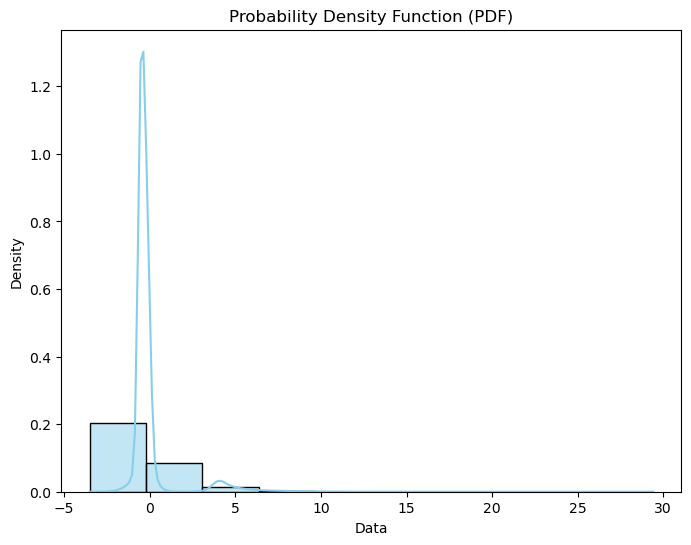

In [147]:
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

plt.figure(figsize=(8, 6))

# Plot PDF using seaborn
sns.histplot(NCI_panda['force'], kde=True, stat='density', bins=10, color='skyblue')

# Display the plot
plt.title('Probability Density Function (PDF)')
plt.xlabel('Data')
plt.ylabel('Density')
plt.show()


/Users/anwer/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1498: FutureWarning: is_categorical_dtype is deprecated and will be removed in a future version. Use isinstance(dtype, CategoricalDtype) instead
  if pd.api.types.is_categorical_dtype(vector):
/Users/anwer/anaconda3/lib/python3.11/site-packages/seaborn/_oldcore.py:1119: FutureWarning: use_inf_as_na option is deprecated and will be removed in a future version. Convert inf values to NaN before operating instead.
  with pd.option_context('mode.use_inf_as_na', True):


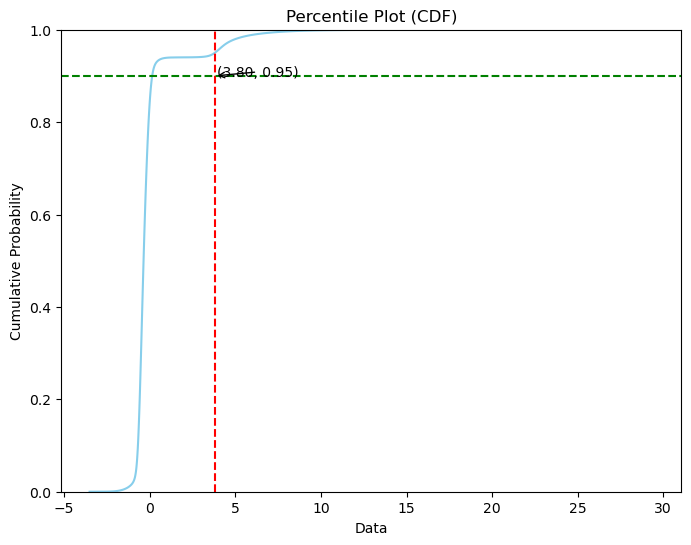

In [150]:

import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

import numpy as np
# Set the plot size
plt.figure(figsize=(8, 6))

# Plot percentile plot using seaborn
sns.ecdfplot(NCI_panda['force'], color='skyblue')


percentile_95 = np.percentile(NCI_panda['force'], 95)

plt.axvline(x=percentile_95, color='red', linestyle='--', label='90th Percentile')
plt.axhline(y=0.9, color='green', linestyle='--')

# Annotate the point on the plot
plt.annotate(f'({percentile_95:.2f}, 0.95)', xy=(percentile_95, 0.9), xytext=(percentile_95 + 0.1, 0.9),
             arrowprops=dict(facecolor='black', arrowstyle='->'))
# Display the plot
plt.title('Percentile Plot (CDF)')
plt.xlabel('Data')
plt.ylabel('Cumulative Probability')
plt.show()

In [151]:
percentile_95

3.7989957921478537

In [152]:
NCI_panda_top_5 = NCI_panda[NCI_panda.force>=3.79899]
NCI_panda_top_5

,tf,gene,motif,force
0,ENSG00000153879,ENSG00000153132,1.0,29.413633
1,ENSG00000221869,ENSG00000153132,1.0,29.293011
2,ENSG00000153879,ENSG00000130770,1.0,29.262514
3,ENSG00000153879,ENSG00000083307,1.0,29.144643
4,ENSG00000221869,ENSG00000130770,1.0,29.133114
...,...,...,...,...
609638,ENSG00000185129,ENSG00000073712,1.0,3.799004
609639,ENSG00000180479,ENSG00000107897,1.0,3.799001
609640,ENSG00000197020,ENSG00000165716,1.0,3.799000
609641,ENSG00000186020,ENSG00000154511,1.0,3.798996


In [153]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from tqdm import tqdm


# Create a weighted bipartite graph
NCI_BG = nx.Graph()
NCI_BG.add_nodes_from(NCI_panda_top_5['tf'])
NCI_BG.add_nodes_from(NCI_panda_top_5['gene'])

# Add weighted edges
edges = [(row['tf'], row['gene'], {'weight': row['force']}) for idx, row in tqdm(NCI_panda_top_5.iterrows())]
NCI_BG.add_edges_from(edges)

609643it [00:08, 71387.19it/s]


In [154]:
nx.average_clustering(NCI_BG)

0.24672738110201595

In [155]:
list_of_tf = list(set(NCI_panda_top_5.tf))
NCI_panda_top_5_bipartite_complete = NCI_panda_top_5[~NCI_panda_top_5.gene.isin(list_of_tf)]

In [156]:
import pandas as pd
import networkx as nx
import matplotlib.pyplot as plt
from tqdm import tqdm


# Create a weighted bipartite graph
NCI_BG_bipartite = nx.Graph()
NCI_BG_bipartite.add_nodes_from(NCI_panda_top_5_bipartite_complete['tf'], bipartite = 0)
NCI_BG_bipartite.add_nodes_from(NCI_panda_top_5_bipartite_complete['gene'], bipartite = 1)
# Add weighted edges
edges = [(row['tf'], row['gene'], {'weight': row['force']}) for idx, row in tqdm(NCI_panda_top_5_bipartite_complete.iterrows())]
NCI_BG_bipartite.add_edges_from(edges)

# Sample DataFrame

582967it [00:06, 83666.60it/s]


In [166]:
NCI_BG_degree_weights = dict(NCI_BG_bipartite.degree(weight = 'weight'))

In [170]:
NCI_BG_degree_weights = dict(sorted(NCI_BG_degree_weights.items(), key=lambda item: item[1], reverse=False))
NCI_BG_degree_weights

{'ENSG00000272316': 19.525624216482807,
 'ENSG00000228828': 19.954373405227685,
 'ENSG00000105983': 20.437516168346,
 'ENSG00000261478': 20.836997235787084,
 'ENSG00000047365': 22.574870380738876,
 'ENSG00000112031': 23.964032812158077,
 'ENSG00000145416': 29.404976699635164,
 'ENSG00000265579': 30.011492866444392,
 'ENSG00000164117': 31.60674602887545,
 'ENSG00000138050': 33.74090758497715,
 'ENSG00000121964': 34.78880976558442,
 'ENSG00000260916': 35.04847688906106,
 'ENSG00000232811': 35.30304396749593,
 'ENSG00000157869': 36.00386654030385,
 'ENSG00000272750': 36.633264671417706,
 'ENSG00000259146': 37.936684811023426,
 'ENSG00000258441': 38.036319567208295,
 'ENSG00000205482': 38.44410967987188,
 'ENSG00000138796': 38.95656834243031,
 'ENSG00000281026': 39.246624026861134,
 'ENSG00000141076': 39.630711355907934,
 'ENSG00000122591': 43.04141937218755,
 'ENSG00000122482': 43.7887266432792,
 'ENSG00000279519': 43.83204679235966,
 'ENSG00000139116': 43.95939225112727,
 'ENSG0000025154

In [171]:
AD_BG_degree_weights = dict(sorted(AD_BG_degree_weights.items(), key=lambda item: item[1], reverse=False))
AD_BG_degree_weights

{'ENSG00000272316': 19.259192956450946,
 'ENSG00000228828': 20.13070114795697,
 'ENSG00000105983': 20.42066302903931,
 'ENSG00000261478': 20.820801863183085,
 'ENSG00000047365': 22.56135070998972,
 'ENSG00000112031': 23.87439704044262,
 'ENSG00000145416': 29.458597745389945,
 'ENSG00000265579': 30.261366115791006,
 'ENSG00000164117': 31.176307860551514,
 'ENSG00000138050': 33.80970933273488,
 'ENSG00000260916': 34.38757541708647,
 'ENSG00000121964': 34.608644638587435,
 'ENSG00000232811': 35.102543511357695,
 'ENSG00000157869': 36.40557045385404,
 'ENSG00000272750': 37.22464044842987,
 'ENSG00000259146': 37.95589638089396,
 'ENSG00000258441': 37.959450617822,
 'ENSG00000205482': 38.45593533913971,
 'ENSG00000281026': 39.069340671500264,
 'ENSG00000138796': 39.29923618690407,
 'ENSG00000141076': 39.48913500709324,
 'ENSG00000122591': 42.81588561969575,
 'ENSG00000122482': 43.44104485016941,
 'ENSG00000139116': 43.963963426462556,
 'ENSG00000251544': 44.486659600882874,
 'ENSG00000170917

In [174]:
import numpy as np
dc = dict()
for i in AD_BG_degree_weights.keys():
    dc[i] = np.abs(AD_BG_degree_weights[i]- NCI_BG_degree_weights[i])/np.abs(AD_BG_degree_weights[i])

In [181]:
dc = dict(sorted(dc.items(), key=lambda item: item[1], reverse=True))
dc

{'ENSG00000280832': 2.7490573507798812,
 'ENSG00000228801': 1.584581223539786,
 'ENSG00000186615': 1.4491308639430411,
 'ENSG00000162415': 1.3618055826191935,
 'ENSG00000184194': 1.2531488950204352,
 'ENSG00000260572': 1.232606632721173,
 'ENSG00000144026': 1.2278947576044008,
 'ENSG00000231050': 1.1803917796867973,
 'ENSG00000114656': 1.1722493323620309,
 'ENSG00000223768': 1.159509476161349,
 'ENSG00000189050': 1.1571506585035187,
 'ENSG00000196810': 1.1249452125823614,
 'ENSG00000130508': 1.1135128570619193,
 'ENSG00000245317': 1.0938619216980914,
 'ENSG00000203727': 1.065223618886472,
 'ENSG00000135083': 1.0282243628981667,
 'ENSG00000112234': 1.0182525622965695,
 'ENSG00000231160': 1.0146564697324112,
 'ENSG00000134326': 1.008257827365125,
 'ENSG00000247796': 0.9694342664853692,
 'ENSG00000253477': 0.9656958397292265,
 'ENSG00000102924': 0.9627743490448196,
 'ENSG00000125378': 0.961122236307521,
 'ENSG00000173218': 0.9539765733288952,
 'ENSG00000262155': 0.9442783504229217,
 'ENSG

In [182]:
list_of_genes = list(set(dc.keys()))
list_of_genes

['ENSG00000177098',
 'ENSG00000087510',
 'ENSG00000141741',
 'ENSG00000144228',
 'ENSG00000139180',
 'ENSG00000231760',
 'ENSG00000063761',
 'ENSG00000261652',
 'ENSG00000111364',
 'ENSG00000077522',
 'ENSG00000203900',
 'ENSG00000180900',
 'ENSG00000149295',
 'ENSG00000126775',
 'ENSG00000167994',
 'ENSG00000135622',
 'ENSG00000164620',
 'ENSG00000237636',
 'ENSG00000168970',
 'ENSG00000181619',
 'ENSG00000237399',
 'ENSG00000175287',
 'ENSG00000066248',
 'ENSG00000135953',
 'ENSG00000134317',
 'ENSG00000130826',
 'ENSG00000264278',
 'ENSG00000112319',
 'ENSG00000114956',
 'ENSG00000129038',
 'ENSG00000186660',
 'ENSG00000166734',
 'ENSG00000156587',
 'ENSG00000119514',
 'ENSG00000129295',
 'ENSG00000235445',
 'ENSG00000143891',
 'ENSG00000080493',
 'ENSG00000114423',
 'ENSG00000172795',
 'ENSG00000161558',
 'ENSG00000091592',
 'ENSG00000154096',
 'ENSG00000216863',
 'ENSG00000122756',
 'ENSG00000181274',
 'ENSG00000136273',
 'ENSG00000159147',
 'ENSG00000129315',
 'ENSG00000213398',


In [206]:
import requests

def get_gene_name_from_ensembl_id(ensembl_id):
    base_url = "https://rest.ensembl.org/"
    endpoint = f"lookup/id/{ensembl_id}?expand=1"

    response = requests.get(base_url + endpoint, headers={"Content-Type": "application/json"})

    if response.status_code == 200:
        data = response.json()
        gene_name = data.get('display_name', 'Gene name not found')
        return gene_name
    else:
        print(f"Error: Unable to retrieve gene name for Ensembl ID {ensembl_id}. Status code: {response.status_code}")
        return None

# Example list of Ensembl IDs
ensembl_ids = list_of_genes
gene_names = []
l = []
# Apply the function to each Ensembl ID using a list comprehension
for ensembl_id in tqdm(ensembl_ids):
    
    
    l.append(ensembl_id)
    gene_names.append(get_gene_name_from_ensembl_id(ensembl_id)) 

# Print the results
for ensembl_id, gene_name in zip(ensembl_ids, gene_names):
    print(f"Gene name for Ensembl ID {ensembl_id}: {gene_name}")
    







  0%|                                                                                                                                           | 0/17173 [00:00<?, ?it/s]




  0%|                                                                                                                                 | 1/17173 [00:00<2:27:44,  1.94it/s]




  0%|                                                                                                                                 | 2/17173 [00:00<1:47:00,  2.67it/s]




  0%|                                                                                                                                 | 3/17173 [00:01<1:50:04,  2.60it/s]




  0%|                                                                                                                                 | 4/17173 [00:01<1:54:37,  2.50it/s]




  0%|                                                                                                                   

  0%|▎                                                                                                                               | 43/17173 [00:22<4:13:20,  1.13it/s]




  0%|▎                                                                                                                               | 44/17173 [00:22<3:26:21,  1.38it/s]




  0%|▎                                                                                                                               | 45/17173 [00:23<2:58:01,  1.60it/s]




  0%|▎                                                                                                                               | 46/17173 [00:23<2:27:36,  1.93it/s]




  0%|▎                                                                                                                               | 47/17173 [00:23<2:12:04,  2.16it/s]




  0%|▎                                                                                                                       

Error: Unable to retrieve gene name for Ensembl ID ENSG00000260461. Status code: 400







  0%|▍                                                                                                                               | 56/17173 [00:29<2:33:20,  1.86it/s]




  0%|▍                                                                                                                               | 57/17173 [00:30<2:58:30,  1.60it/s]




  0%|▍                                                                                                                               | 58/17173 [00:30<2:36:48,  1.82it/s]




  0%|▍                                                                                                                               | 59/17173 [00:30<2:13:11,  2.14it/s]




  0%|▍                                                                                                                               | 60/17173 [00:31<3:06:10,  1.53it/s]




  0%|▍                                                                                                                  

  1%|▋                                                                                                                               | 99/17173 [00:53<1:41:32,  2.80it/s]




  1%|▋                                                                                                                              | 100/17173 [00:53<2:08:27,  2.22it/s]




  1%|▋                                                                                                                              | 101/17173 [00:54<2:03:39,  2.30it/s]




  1%|▊                                                                                                                              | 102/17173 [00:54<1:56:43,  2.44it/s]




  1%|▊                                                                                                                              | 103/17173 [00:54<1:57:17,  2.43it/s]




  1%|▊                                                                                                                       

  1%|█                                                                                                                              | 142/17173 [01:15<1:48:42,  2.61it/s]




  1%|█                                                                                                                              | 143/17173 [01:16<2:14:50,  2.11it/s]




  1%|█                                                                                                                              | 144/17173 [01:16<2:14:10,  2.12it/s]




  1%|█                                                                                                                              | 145/17173 [01:17<1:59:51,  2.37it/s]




  1%|█                                                                                                                              | 146/17173 [01:17<2:15:08,  2.10it/s]




  1%|█                                                                                                                       

  1%|█▎                                                                                                                             | 185/17173 [01:36<1:58:23,  2.39it/s]




  1%|█▍                                                                                                                             | 186/17173 [01:37<1:54:16,  2.48it/s]




  1%|█▍                                                                                                                             | 187/17173 [01:37<1:39:49,  2.84it/s]




  1%|█▍                                                                                                                             | 188/17173 [01:37<1:38:01,  2.89it/s]




  1%|█▍                                                                                                                             | 189/17173 [01:38<1:39:15,  2.85it/s]




  1%|█▍                                                                                                                      

  1%|█▋                                                                                                                             | 228/17173 [01:57<1:41:54,  2.77it/s]




  1%|█▋                                                                                                                             | 229/17173 [01:58<1:48:48,  2.60it/s]




  1%|█▋                                                                                                                             | 230/17173 [01:58<1:56:13,  2.43it/s]




  1%|█▋                                                                                                                             | 231/17173 [01:59<2:29:28,  1.89it/s]




  1%|█▋                                                                                                                             | 232/17173 [02:01<4:03:56,  1.16it/s]




  1%|█▋                                                                                                                      

  2%|██                                                                                                                             | 271/17173 [02:18<2:37:10,  1.79it/s]




  2%|██                                                                                                                             | 272/17173 [02:19<3:07:02,  1.51it/s]




  2%|██                                                                                                                             | 273/17173 [02:19<2:37:39,  1.79it/s]




  2%|██                                                                                                                             | 274/17173 [02:20<2:54:34,  1.61it/s]




  2%|██                                                                                                                             | 275/17173 [02:20<2:22:41,  1.97it/s]




  2%|██                                                                                                                      

Error: Unable to retrieve gene name for Ensembl ID ENSG00000215271. Status code: 400







  2%|██▏                                                                                                                            | 292/17173 [02:28<2:21:07,  1.99it/s]




  2%|██▏                                                                                                                            | 293/17173 [02:28<2:01:10,  2.32it/s]




  2%|██▏                                                                                                                            | 294/17173 [02:29<2:04:46,  2.25it/s]




  2%|██▏                                                                                                                            | 295/17173 [02:29<1:43:49,  2.71it/s]




  2%|██▏                                                                                                                            | 296/17173 [02:29<2:00:52,  2.33it/s]




  2%|██▏                                                                                                                

  2%|██▍                                                                                                                            | 335/17173 [02:46<1:59:09,  2.36it/s]




  2%|██▍                                                                                                                            | 336/17173 [02:46<2:11:41,  2.13it/s]




  2%|██▍                                                                                                                            | 337/17173 [02:47<2:07:24,  2.20it/s]




  2%|██▍                                                                                                                            | 338/17173 [02:47<2:08:38,  2.18it/s]




  2%|██▌                                                                                                                            | 339/17173 [02:47<1:58:40,  2.36it/s]




  2%|██▌                                                                                                                     

  2%|██▊                                                                                                                            | 378/17173 [03:08<1:47:14,  2.61it/s]




  2%|██▊                                                                                                                            | 379/17173 [03:09<2:55:31,  1.59it/s]




  2%|██▊                                                                                                                            | 380/17173 [03:10<2:46:59,  1.68it/s]




  2%|██▊                                                                                                                            | 381/17173 [03:10<2:36:49,  1.78it/s]




  2%|██▊                                                                                                                            | 382/17173 [03:11<2:23:21,  1.95it/s]




  2%|██▊                                                                                                                     

  2%|███                                                                                                                            | 421/17173 [03:27<1:51:05,  2.51it/s]




  2%|███                                                                                                                            | 422/17173 [03:28<1:42:14,  2.73it/s]




  2%|███▏                                                                                                                           | 423/17173 [03:29<2:43:37,  1.71it/s]




  2%|███▏                                                                                                                           | 424/17173 [03:29<2:08:02,  2.18it/s]

Error: Unable to retrieve gene name for Ensembl ID ENSG00000239467. Status code: 400







  2%|███▏                                                                                                                           | 425/17173 [03:29<2:14:17,  2.08it/s]




  2%|███▏                                                                                                                           | 426/17173 [03:30<1:56:53,  2.39it/s]




  2%|███▏                                                                                                                           | 427/17173 [03:30<1:53:12,  2.47it/s]




  2%|███▏                                                                                                                           | 428/17173 [03:31<2:03:15,  2.26it/s]




  2%|███▏                                                                                                                           | 429/17173 [03:31<1:48:30,  2.57it/s]




  3%|███▏                                                                                                               

  3%|███▍                                                                                                                           | 468/17173 [03:48<1:41:38,  2.74it/s]




  3%|███▍                                                                                                                           | 469/17173 [03:48<1:51:28,  2.50it/s]




  3%|███▍                                                                                                                           | 470/17173 [03:49<1:51:52,  2.49it/s]




  3%|███▍                                                                                                                           | 471/17173 [03:49<1:35:00,  2.93it/s]




  3%|███▍                                                                                                                           | 472/17173 [03:49<1:25:17,  3.26it/s]




  3%|███▍                                                                                                                    

  3%|███▊                                                                                                                           | 511/17173 [04:10<2:41:08,  1.72it/s]




  3%|███▊                                                                                                                           | 512/17173 [04:11<2:54:51,  1.59it/s]




  3%|███▊                                                                                                                           | 513/17173 [04:12<2:31:51,  1.83it/s]




  3%|███▊                                                                                                                           | 514/17173 [04:12<2:41:36,  1.72it/s]




  3%|███▊                                                                                                                           | 515/17173 [04:13<2:22:54,  1.94it/s]




  3%|███▊                                                                                                                    

  3%|████                                                                                                                           | 554/17173 [04:31<2:54:53,  1.58it/s]




  3%|████                                                                                                                           | 555/17173 [04:31<2:27:44,  1.87it/s]




  3%|████                                                                                                                           | 556/17173 [04:31<1:59:56,  2.31it/s]




  3%|████                                                                                                                           | 557/17173 [04:32<1:45:33,  2.62it/s]




  3%|████▏                                                                                                                          | 558/17173 [04:32<1:31:00,  3.04it/s]




  3%|████▏                                                                                                                   

  3%|████▍                                                                                                                          | 597/17173 [04:50<2:06:04,  2.19it/s]




  3%|████▍                                                                                                                          | 598/17173 [04:51<2:01:22,  2.28it/s]




  3%|████▍                                                                                                                          | 599/17173 [04:51<2:15:19,  2.04it/s]




  3%|████▍                                                                                                                          | 600/17173 [04:52<2:25:33,  1.90it/s]




  3%|████▍                                                                                                                          | 601/17173 [04:52<2:03:56,  2.23it/s]




  4%|████▍                                                                                                                   

  4%|████▋                                                                                                                          | 640/17173 [05:12<2:19:48,  1.97it/s]




  4%|████▋                                                                                                                          | 641/17173 [05:13<2:30:17,  1.83it/s]




  4%|████▋                                                                                                                          | 642/17173 [05:14<2:33:45,  1.79it/s]




  4%|████▊                                                                                                                          | 643/17173 [05:14<2:17:25,  2.00it/s]




  4%|████▊                                                                                                                          | 644/17173 [05:14<2:02:54,  2.24it/s]




  4%|████▊                                                                                                                   

  4%|█████                                                                                                                          | 683/17173 [05:35<1:59:40,  2.30it/s]




  4%|█████                                                                                                                          | 684/17173 [05:35<1:41:13,  2.71it/s]




  4%|█████                                                                                                                          | 685/17173 [05:35<1:40:03,  2.75it/s]




  4%|█████                                                                                                                          | 686/17173 [05:36<1:51:02,  2.47it/s]




  4%|█████                                                                                                                          | 687/17173 [05:37<2:11:17,  2.09it/s]




  4%|█████                                                                                                                   

  4%|█████▎                                                                                                                         | 726/17173 [05:55<1:36:53,  2.83it/s]




  4%|█████▍                                                                                                                         | 727/17173 [05:56<2:07:57,  2.14it/s]




  4%|█████▍                                                                                                                         | 728/17173 [05:56<2:07:11,  2.15it/s]




  4%|█████▍                                                                                                                         | 729/17173 [05:56<1:50:56,  2.47it/s]




  4%|█████▍                                                                                                                         | 730/17173 [05:57<1:52:00,  2.45it/s]




  4%|█████▍                                                                                                                  

  4%|█████▋                                                                                                                         | 769/17173 [06:16<2:06:22,  2.16it/s]




  4%|█████▋                                                                                                                         | 770/17173 [06:17<3:01:48,  1.50it/s]




  4%|█████▋                                                                                                                         | 771/17173 [06:18<3:13:55,  1.41it/s]




  4%|█████▋                                                                                                                         | 772/17173 [06:19<3:21:16,  1.36it/s]




  5%|█████▋                                                                                                                         | 773/17173 [06:19<2:50:34,  1.60it/s]




  5%|█████▋                                                                                                                  

  5%|██████                                                                                                                         | 812/17173 [06:37<1:40:27,  2.71it/s]




  5%|██████                                                                                                                         | 813/17173 [06:37<2:12:16,  2.06it/s]




  5%|██████                                                                                                                         | 814/17173 [06:38<2:22:52,  1.91it/s]




  5%|██████                                                                                                                         | 815/17173 [06:39<2:24:08,  1.89it/s]




  5%|██████                                                                                                                         | 816/17173 [06:39<1:57:27,  2.32it/s]




  5%|██████                                                                                                                  

  5%|██████▎                                                                                                                        | 855/17173 [06:58<2:49:51,  1.60it/s]




  5%|██████▎                                                                                                                        | 856/17173 [06:59<3:06:01,  1.46it/s]




  5%|██████▎                                                                                                                        | 857/17173 [06:59<2:40:06,  1.70it/s]




  5%|██████▎                                                                                                                        | 858/17173 [06:59<2:12:38,  2.05it/s]




  5%|██████▎                                                                                                                        | 859/17173 [07:02<4:58:06,  1.10s/it]




  5%|██████▎                                                                                                                 

  5%|██████▋                                                                                                                        | 898/17173 [07:18<2:14:02,  2.02it/s]




  5%|██████▋                                                                                                                        | 899/17173 [07:18<2:12:18,  2.05it/s]




  5%|██████▋                                                                                                                        | 900/17173 [07:19<1:59:39,  2.27it/s]




  5%|██████▋                                                                                                                        | 901/17173 [07:20<3:15:43,  1.39it/s]




  5%|██████▋                                                                                                                        | 902/17173 [07:21<2:41:46,  1.68it/s]




  5%|██████▋                                                                                                                 

  5%|██████▉                                                                                                                        | 941/17173 [07:39<2:27:45,  1.83it/s]




  5%|██████▉                                                                                                                        | 942/17173 [07:39<2:09:30,  2.09it/s]




  5%|██████▉                                                                                                                        | 943/17173 [07:40<1:51:12,  2.43it/s]




  5%|██████▉                                                                                                                        | 944/17173 [07:40<1:54:59,  2.35it/s]




  6%|██████▉                                                                                                                        | 945/17173 [07:40<1:58:18,  2.29it/s]




  6%|██████▉                                                                                                                 

  6%|███████▎                                                                                                                       | 984/17173 [07:58<2:05:25,  2.15it/s]




  6%|███████▎                                                                                                                       | 985/17173 [07:58<1:42:48,  2.62it/s]




  6%|███████▎                                                                                                                       | 986/17173 [07:58<1:46:18,  2.54it/s]




  6%|███████▎                                                                                                                       | 987/17173 [07:59<1:49:53,  2.45it/s]




  6%|███████▎                                                                                                                       | 988/17173 [07:59<1:44:19,  2.59it/s]




  6%|███████▎                                                                                                                

  6%|███████▌                                                                                                                      | 1027/17173 [08:17<1:52:28,  2.39it/s]




  6%|███████▌                                                                                                                      | 1028/17173 [08:17<1:39:46,  2.70it/s]




  6%|███████▌                                                                                                                      | 1029/17173 [08:17<1:31:25,  2.94it/s]




  6%|███████▌                                                                                                                      | 1030/17173 [08:18<1:57:06,  2.30it/s]




  6%|███████▌                                                                                                                      | 1031/17173 [08:18<1:52:24,  2.39it/s]




  6%|███████▌                                                                                                                

  6%|███████▊                                                                                                                      | 1070/17173 [08:37<1:54:14,  2.35it/s]




  6%|███████▊                                                                                                                      | 1071/17173 [08:38<1:57:03,  2.29it/s]




  6%|███████▊                                                                                                                      | 1072/17173 [08:38<1:40:06,  2.68it/s]




  6%|███████▊                                                                                                                      | 1073/17173 [08:38<1:26:08,  3.12it/s]




  6%|███████▉                                                                                                                      | 1074/17173 [08:38<1:26:37,  3.10it/s]




  6%|███████▉                                                                                                                

  6%|████████▏                                                                                                                     | 1113/17173 [09:02<2:57:01,  1.51it/s]




  6%|████████▏                                                                                                                     | 1114/17173 [09:02<2:30:02,  1.78it/s]




  6%|████████▏                                                                                                                     | 1115/17173 [09:02<2:02:33,  2.18it/s]




  6%|████████▏                                                                                                                     | 1116/17173 [09:03<1:51:20,  2.40it/s]




  7%|████████▏                                                                                                                     | 1117/17173 [09:04<3:03:40,  1.46it/s]




  7%|████████▏                                                                                                               

  7%|████████▍                                                                                                                     | 1156/17173 [09:21<2:03:27,  2.16it/s]




  7%|████████▍                                                                                                                     | 1157/17173 [09:21<1:57:07,  2.28it/s]




  7%|████████▍                                                                                                                     | 1158/17173 [09:21<1:37:42,  2.73it/s]




  7%|████████▌                                                                                                                     | 1159/17173 [09:22<1:37:03,  2.75it/s]




  7%|████████▌                                                                                                                     | 1160/17173 [09:22<1:31:12,  2.93it/s]




  7%|████████▌                                                                                                               

  7%|████████▊                                                                                                                     | 1199/17173 [09:37<1:34:51,  2.81it/s]




  7%|████████▊                                                                                                                     | 1200/17173 [09:37<1:47:04,  2.49it/s]




  7%|████████▊                                                                                                                     | 1201/17173 [09:37<1:41:18,  2.63it/s]




  7%|████████▊                                                                                                                     | 1202/17173 [09:38<1:43:05,  2.58it/s]




  7%|████████▊                                                                                                                     | 1203/17173 [09:40<4:38:21,  1.05s/it]




  7%|████████▊                                                                                                               

Error: Unable to retrieve gene name for Ensembl ID ENSG00000182230. Status code: 400







  7%|████████▊                                                                                                                     | 1209/17173 [09:43<2:15:46,  1.96it/s]




  7%|████████▉                                                                                                                     | 1210/17173 [09:44<2:32:12,  1.75it/s]




  7%|████████▉                                                                                                                     | 1211/17173 [09:44<2:18:03,  1.93it/s]




  7%|████████▉                                                                                                                     | 1212/17173 [09:45<1:58:07,  2.25it/s]




  7%|████████▉                                                                                                                     | 1213/17173 [09:45<1:52:23,  2.37it/s]




  7%|████████▉                                                                                                          

  7%|█████████▏                                                                                                                    | 1252/17173 [10:04<2:05:51,  2.11it/s]




  7%|█████████▏                                                                                                                    | 1253/17173 [10:04<1:53:40,  2.33it/s]




  7%|█████████▏                                                                                                                    | 1254/17173 [10:05<1:38:36,  2.69it/s]




  7%|█████████▏                                                                                                                    | 1255/17173 [10:05<1:36:36,  2.75it/s]




  7%|█████████▏                                                                                                                    | 1256/17173 [10:06<1:51:05,  2.39it/s]




  7%|█████████▏                                                                                                              

  8%|█████████▌                                                                                                                    | 1295/17173 [10:23<1:49:48,  2.41it/s]




  8%|█████████▌                                                                                                                    | 1296/17173 [10:24<1:33:27,  2.83it/s]




  8%|█████████▌                                                                                                                    | 1297/17173 [10:24<2:08:02,  2.07it/s]




  8%|█████████▌                                                                                                                    | 1298/17173 [10:25<2:01:48,  2.17it/s]




  8%|█████████▌                                                                                                                    | 1299/17173 [10:25<1:50:41,  2.39it/s]




  8%|█████████▌                                                                                                              

  8%|█████████▊                                                                                                                    | 1338/17173 [10:42<2:01:03,  2.18it/s]




  8%|█████████▊                                                                                                                    | 1339/17173 [10:42<2:03:04,  2.14it/s]




  8%|█████████▊                                                                                                                    | 1340/17173 [10:42<1:45:08,  2.51it/s]




  8%|█████████▊                                                                                                                    | 1341/17173 [10:43<1:34:12,  2.80it/s]




  8%|█████████▊                                                                                                                    | 1342/17173 [10:43<1:32:33,  2.85it/s]




  8%|█████████▊                                                                                                              

  8%|██████████▏                                                                                                                   | 1381/17173 [11:01<1:30:04,  2.92it/s]

Error: Unable to retrieve gene name for Ensembl ID ENSG00000234290. Status code: 400







  8%|██████████▏                                                                                                                   | 1382/17173 [11:01<1:27:39,  3.00it/s]




  8%|██████████▏                                                                                                                   | 1383/17173 [11:02<1:37:50,  2.69it/s]




  8%|██████████▏                                                                                                                   | 1384/17173 [11:02<1:59:26,  2.20it/s]




  8%|██████████▏                                                                                                                   | 1385/17173 [11:03<1:54:38,  2.30it/s]




  8%|██████████▏                                                                                                                   | 1386/17173 [11:03<1:52:39,  2.34it/s]




  8%|██████████▏                                                                                                        

  8%|██████████▍                                                                                                                   | 1425/17173 [11:22<1:27:47,  2.99it/s]




  8%|██████████▍                                                                                                                   | 1426/17173 [11:22<1:25:12,  3.08it/s]




  8%|██████████▍                                                                                                                   | 1427/17173 [11:22<1:44:00,  2.52it/s]




  8%|██████████▍                                                                                                                   | 1428/17173 [11:23<1:34:40,  2.77it/s]




  8%|██████████▍                                                                                                                   | 1429/17173 [11:23<1:32:24,  2.84it/s]




  8%|██████████▍                                                                                                             

  9%|██████████▊                                                                                                                   | 1468/17173 [11:43<1:45:00,  2.49it/s]




  9%|██████████▊                                                                                                                   | 1469/17173 [11:44<1:42:09,  2.56it/s]




  9%|██████████▊                                                                                                                   | 1470/17173 [11:44<2:07:46,  2.05it/s]




  9%|██████████▊                                                                                                                   | 1471/17173 [11:45<2:19:45,  1.87it/s]




  9%|██████████▊                                                                                                                   | 1472/17173 [11:46<3:05:08,  1.41it/s]




  9%|██████████▊                                                                                                             

  9%|███████████                                                                                                                   | 1511/17173 [12:03<1:51:37,  2.34it/s]




  9%|███████████                                                                                                                   | 1512/17173 [12:04<1:44:38,  2.49it/s]




  9%|███████████                                                                                                                   | 1513/17173 [12:04<1:28:37,  2.94it/s]




  9%|███████████                                                                                                                   | 1514/17173 [12:04<1:34:17,  2.77it/s]




  9%|███████████                                                                                                                   | 1515/17173 [12:04<1:26:06,  3.03it/s]




  9%|███████████                                                                                                             

  9%|███████████▍                                                                                                                  | 1554/17173 [12:27<1:53:14,  2.30it/s]




  9%|███████████▍                                                                                                                  | 1555/17173 [12:27<1:37:13,  2.68it/s]




  9%|███████████▍                                                                                                                  | 1556/17173 [12:28<1:37:52,  2.66it/s]




  9%|███████████▍                                                                                                                  | 1557/17173 [12:28<1:51:35,  2.33it/s]




  9%|███████████▍                                                                                                                  | 1558/17173 [12:28<1:41:48,  2.56it/s]




  9%|███████████▍                                                                                                            

  9%|███████████▋                                                                                                                  | 1597/17173 [12:45<2:18:00,  1.88it/s]




  9%|███████████▋                                                                                                                  | 1598/17173 [12:45<1:51:42,  2.32it/s]




  9%|███████████▋                                                                                                                  | 1599/17173 [12:46<2:00:20,  2.16it/s]




  9%|███████████▋                                                                                                                  | 1600/17173 [12:46<2:01:57,  2.13it/s]




  9%|███████████▋                                                                                                                  | 1601/17173 [12:47<2:04:34,  2.08it/s]




  9%|███████████▊                                                                                                            

Error: Unable to retrieve gene name for Ensembl ID ENSG00000205485. Status code: 400







  9%|███████████▉                                                                                                                  | 1630/17173 [12:59<1:41:12,  2.56it/s]




  9%|███████████▉                                                                                                                  | 1631/17173 [12:59<1:54:46,  2.26it/s]




 10%|███████████▉                                                                                                                  | 1632/17173 [13:00<2:04:31,  2.08it/s]




 10%|███████████▉                                                                                                                  | 1633/17173 [13:00<1:56:14,  2.23it/s]




 10%|███████████▉                                                                                                                  | 1634/17173 [13:01<1:38:42,  2.62it/s]




 10%|███████████▉                                                                                                       

Error: Unable to retrieve gene name for Ensembl ID ENSG00000255495. Status code: 400







 10%|████████████▎                                                                                                                 | 1672/17173 [13:17<1:31:39,  2.82it/s]




 10%|████████████▎                                                                                                                 | 1673/17173 [13:18<1:45:31,  2.45it/s]




 10%|████████████▎                                                                                                                 | 1674/17173 [13:18<2:18:56,  1.86it/s]




 10%|████████████▎                                                                                                                 | 1675/17173 [13:19<2:40:11,  1.61it/s]




 10%|████████████▎                                                                                                                 | 1676/17173 [13:20<3:12:35,  1.34it/s]




 10%|████████████▎                                                                                                      

 10%|████████████▌                                                                                                                 | 1715/17173 [13:38<1:30:12,  2.86it/s]




 10%|████████████▌                                                                                                                 | 1716/17173 [13:39<1:42:24,  2.52it/s]




 10%|████████████▌                                                                                                                 | 1717/17173 [13:39<1:42:37,  2.51it/s]




 10%|████████████▌                                                                                                                 | 1718/17173 [13:40<1:54:14,  2.25it/s]




 10%|████████████▌                                                                                                                 | 1719/17173 [13:40<1:59:32,  2.15it/s]




 10%|████████████▌                                                                                                           

 10%|████████████▉                                                                                                                 | 1758/17173 [13:56<1:53:01,  2.27it/s]




 10%|████████████▉                                                                                                                 | 1759/17173 [13:57<2:09:54,  1.98it/s]




 10%|████████████▉                                                                                                                 | 1760/17173 [13:58<3:17:16,  1.30it/s]




 10%|████████████▉                                                                                                                 | 1761/17173 [13:58<2:44:53,  1.56it/s]




 10%|████████████▉                                                                                                                 | 1762/17173 [13:59<2:33:55,  1.67it/s]




 10%|████████████▉                                                                                                           

 10%|█████████████▏                                                                                                                | 1801/17173 [14:14<1:37:22,  2.63it/s]




 10%|█████████████▏                                                                                                                | 1802/17173 [14:15<1:33:25,  2.74it/s]




 10%|█████████████▏                                                                                                                | 1803/17173 [14:15<1:23:27,  3.07it/s]




 11%|█████████████▏                                                                                                                | 1804/17173 [14:15<1:16:09,  3.36it/s]




 11%|█████████████▏                                                                                                                | 1805/17173 [14:16<1:47:14,  2.39it/s]




 11%|█████████████▎                                                                                                          

Error: Unable to retrieve gene name for Ensembl ID ENSG00000225986. Status code: 400







 11%|█████████████▌                                                                                                                | 1843/17173 [14:32<1:41:28,  2.52it/s]




 11%|█████████████▌                                                                                                                | 1844/17173 [14:33<1:48:31,  2.35it/s]




 11%|█████████████▌                                                                                                                | 1845/17173 [14:33<1:36:43,  2.64it/s]




 11%|█████████████▌                                                                                                                | 1846/17173 [14:33<1:39:37,  2.56it/s]




 11%|█████████████▌                                                                                                                | 1847/17173 [14:34<1:46:10,  2.41it/s]




 11%|█████████████▌                                                                                                     

 11%|█████████████▊                                                                                                                | 1886/17173 [14:52<2:27:56,  1.72it/s]




 11%|█████████████▊                                                                                                                | 1887/17173 [14:53<2:27:54,  1.72it/s]




 11%|█████████████▊                                                                                                                | 1888/17173 [14:53<2:14:59,  1.89it/s]




 11%|█████████████▊                                                                                                                | 1889/17173 [14:54<1:50:19,  2.31it/s]




 11%|█████████████▊                                                                                                                | 1890/17173 [14:54<1:49:28,  2.33it/s]




 11%|█████████████▊                                                                                                          

 11%|██████████████▏                                                                                                               | 1929/17173 [15:17<3:25:43,  1.24it/s]




 11%|██████████████▏                                                                                                               | 1930/17173 [15:17<3:29:57,  1.21it/s]




 11%|██████████████▏                                                                                                               | 1931/17173 [15:20<5:36:02,  1.32s/it]




 11%|██████████████▏                                                                                                               | 1932/17173 [15:21<5:04:40,  1.20s/it]




 11%|██████████████▏                                                                                                               | 1933/17173 [15:22<4:49:32,  1.14s/it]




 11%|██████████████▏                                                                                                         

 11%|██████████████▍                                                                                                               | 1972/17173 [15:39<1:25:54,  2.95it/s]




 11%|██████████████▍                                                                                                               | 1973/17173 [15:39<1:33:08,  2.72it/s]




 11%|██████████████▍                                                                                                               | 1974/17173 [15:40<1:46:33,  2.38it/s]




 12%|██████████████▍                                                                                                               | 1975/17173 [15:40<1:40:35,  2.52it/s]




 12%|██████████████▍                                                                                                               | 1976/17173 [15:41<2:19:00,  1.82it/s]




 12%|██████████████▌                                                                                                         

 12%|██████████████▊                                                                                                               | 2015/17173 [16:00<2:12:37,  1.90it/s]




 12%|██████████████▊                                                                                                               | 2016/17173 [16:00<1:55:43,  2.18it/s]




 12%|██████████████▊                                                                                                               | 2017/17173 [16:01<2:07:24,  1.98it/s]




 12%|██████████████▊                                                                                                               | 2018/17173 [16:01<2:26:31,  1.72it/s]




 12%|██████████████▊                                                                                                               | 2019/17173 [16:02<2:31:14,  1.67it/s]




 12%|██████████████▊                                                                                                         

 12%|███████████████                                                                                                               | 2058/17173 [16:21<2:54:31,  1.44it/s]




 12%|███████████████                                                                                                               | 2059/17173 [16:23<3:34:46,  1.17it/s]




 12%|███████████████                                                                                                               | 2060/17173 [16:23<2:58:51,  1.41it/s]




 12%|███████████████                                                                                                               | 2061/17173 [16:24<2:46:16,  1.51it/s]




 12%|███████████████▏                                                                                                              | 2062/17173 [16:24<2:30:06,  1.68it/s]




 12%|███████████████▏                                                                                                        

 12%|███████████████▍                                                                                                              | 2101/17173 [16:44<1:56:52,  2.15it/s]




 12%|███████████████▍                                                                                                              | 2102/17173 [16:45<2:34:00,  1.63it/s]




 12%|███████████████▍                                                                                                              | 2103/17173 [16:46<2:03:14,  2.04it/s]




 12%|███████████████▍                                                                                                              | 2104/17173 [16:46<2:10:14,  1.93it/s]




 12%|███████████████▍                                                                                                              | 2105/17173 [16:47<2:05:01,  2.01it/s]




 12%|███████████████▍                                                                                                        

 12%|███████████████▋                                                                                                              | 2144/17173 [17:07<2:13:18,  1.88it/s]




 12%|███████████████▋                                                                                                              | 2145/17173 [17:07<1:59:21,  2.10it/s]




 12%|███████████████▋                                                                                                              | 2146/17173 [17:07<1:52:44,  2.22it/s]




 13%|███████████████▊                                                                                                              | 2147/17173 [17:08<1:36:07,  2.61it/s]




 13%|███████████████▊                                                                                                              | 2148/17173 [17:08<1:47:55,  2.32it/s]




 13%|███████████████▊                                                                                                        

 13%|████████████████                                                                                                              | 2187/17173 [17:26<1:36:31,  2.59it/s]




 13%|████████████████                                                                                                              | 2188/17173 [17:26<1:21:56,  3.05it/s]




 13%|████████████████                                                                                                              | 2189/17173 [17:26<1:18:55,  3.16it/s]




 13%|████████████████                                                                                                              | 2190/17173 [17:27<1:27:24,  2.86it/s]




 13%|████████████████                                                                                                              | 2191/17173 [17:27<1:53:21,  2.20it/s]




 13%|████████████████                                                                                                        

 13%|████████████████▎                                                                                                             | 2230/17173 [17:48<2:16:21,  1.83it/s]




 13%|████████████████▎                                                                                                             | 2231/17173 [17:48<1:51:48,  2.23it/s]




 13%|████████████████▍                                                                                                             | 2232/17173 [17:48<1:38:18,  2.53it/s]




 13%|████████████████▍                                                                                                             | 2233/17173 [17:49<1:26:17,  2.89it/s]




 13%|████████████████▍                                                                                                             | 2234/17173 [17:49<1:47:08,  2.32it/s]




 13%|████████████████▍                                                                                                       

Error: Unable to retrieve gene name for Ensembl ID ENSG00000273301. Status code: 400







 13%|████████████████▍                                                                                                             | 2237/17173 [17:51<1:57:38,  2.12it/s]




 13%|████████████████▍                                                                                                             | 2238/17173 [17:51<1:45:29,  2.36it/s]




 13%|████████████████▍                                                                                                             | 2239/17173 [17:52<2:21:03,  1.76it/s]




 13%|████████████████▍                                                                                                             | 2240/17173 [17:53<2:28:35,  1.67it/s]




 13%|████████████████▍                                                                                                             | 2241/17173 [17:53<2:21:03,  1.76it/s]




 13%|████████████████▍                                                                                                  

 13%|████████████████▋                                                                                                             | 2280/17173 [18:12<1:14:24,  3.34it/s]




 13%|████████████████▋                                                                                                             | 2281/17173 [18:13<1:58:04,  2.10it/s]




 13%|████████████████▋                                                                                                             | 2282/17173 [18:13<1:39:49,  2.49it/s]




 13%|████████████████▊                                                                                                             | 2283/17173 [18:13<1:23:56,  2.96it/s]




 13%|████████████████▊                                                                                                             | 2284/17173 [18:14<1:22:50,  3.00it/s]




 13%|████████████████▊                                                                                                       

 14%|█████████████████                                                                                                             | 2323/17173 [18:38<1:46:42,  2.32it/s]




 14%|█████████████████                                                                                                             | 2324/17173 [18:38<1:29:22,  2.77it/s]




 14%|█████████████████                                                                                                             | 2325/17173 [18:39<1:58:11,  2.09it/s]




 14%|█████████████████                                                                                                             | 2326/17173 [18:39<1:41:28,  2.44it/s]




 14%|█████████████████                                                                                                             | 2327/17173 [18:39<1:41:01,  2.45it/s]




 14%|█████████████████                                                                                                       

 14%|█████████████████▎                                                                                                            | 2366/17173 [18:59<1:48:32,  2.27it/s]




 14%|█████████████████▎                                                                                                            | 2367/17173 [18:59<1:53:28,  2.17it/s]




 14%|█████████████████▎                                                                                                            | 2368/17173 [19:00<1:49:49,  2.25it/s]




 14%|█████████████████▍                                                                                                            | 2369/17173 [19:02<4:12:19,  1.02s/it]




 14%|█████████████████▍                                                                                                            | 2370/17173 [19:03<3:31:03,  1.17it/s]




 14%|█████████████████▍                                                                                                      

 14%|█████████████████▋                                                                                                            | 2409/17173 [19:21<2:10:25,  1.89it/s]




 14%|█████████████████▋                                                                                                            | 2410/17173 [19:21<1:57:51,  2.09it/s]




 14%|█████████████████▋                                                                                                            | 2411/17173 [19:21<1:49:38,  2.24it/s]




 14%|█████████████████▋                                                                                                            | 2412/17173 [19:22<1:46:02,  2.32it/s]




 14%|█████████████████▋                                                                                                            | 2413/17173 [19:22<1:50:00,  2.24it/s]




 14%|█████████████████▋                                                                                                      

 14%|█████████████████▉                                                                                                            | 2452/17173 [19:39<1:58:41,  2.07it/s]




 14%|█████████████████▉                                                                                                            | 2453/17173 [19:39<1:41:39,  2.41it/s]




 14%|██████████████████                                                                                                            | 2454/17173 [19:39<1:41:56,  2.41it/s]




 14%|██████████████████                                                                                                            | 2455/17173 [19:40<1:33:28,  2.62it/s]




 14%|██████████████████                                                                                                            | 2456/17173 [19:40<1:34:56,  2.58it/s]




 14%|██████████████████                                                                                                      

 15%|██████████████████▎                                                                                                           | 2495/17173 [20:00<2:02:05,  2.00it/s]




 15%|██████████████████▎                                                                                                           | 2496/17173 [20:01<1:47:23,  2.28it/s]




 15%|██████████████████▎                                                                                                           | 2497/17173 [20:01<1:34:11,  2.60it/s]




 15%|██████████████████▎                                                                                                           | 2498/17173 [20:01<1:22:27,  2.97it/s]

Error: Unable to retrieve gene name for Ensembl ID ENSG00000261490. Status code: 400







 15%|██████████████████▎                                                                                                           | 2499/17173 [20:01<1:33:28,  2.62it/s]




 15%|██████████████████▎                                                                                                           | 2500/17173 [20:02<1:36:55,  2.52it/s]




 15%|██████████████████▎                                                                                                           | 2501/17173 [20:02<1:31:20,  2.68it/s]




 15%|██████████████████▎                                                                                                           | 2502/17173 [20:03<1:24:24,  2.90it/s]




 15%|██████████████████▎                                                                                                           | 2503/17173 [20:03<1:23:37,  2.92it/s]




 15%|██████████████████▎                                                                                                

 15%|██████████████████▋                                                                                                           | 2542/17173 [20:23<2:25:50,  1.67it/s]




 15%|██████████████████▋                                                                                                           | 2543/17173 [20:23<2:11:23,  1.86it/s]




 15%|██████████████████▋                                                                                                           | 2544/17173 [20:24<1:51:56,  2.18it/s]




 15%|██████████████████▋                                                                                                           | 2545/17173 [20:24<1:40:54,  2.42it/s]




 15%|██████████████████▋                                                                                                           | 2546/17173 [20:25<1:53:37,  2.15it/s]




 15%|██████████████████▋                                                                                                     

 15%|██████████████████▉                                                                                                           | 2585/17173 [20:44<2:31:39,  1.60it/s]




 15%|██████████████████▉                                                                                                           | 2586/17173 [20:44<2:21:06,  1.72it/s]




 15%|██████████████████▉                                                                                                           | 2587/17173 [20:45<2:32:35,  1.59it/s]




 15%|██████████████████▉                                                                                                           | 2588/17173 [20:45<2:11:55,  1.84it/s]




 15%|██████████████████▉                                                                                                           | 2589/17173 [20:46<2:07:50,  1.90it/s]




 15%|███████████████████                                                                                                     

 15%|███████████████████▎                                                                                                          | 2628/17173 [21:06<1:26:39,  2.80it/s]




 15%|███████████████████▎                                                                                                          | 2629/17173 [21:06<1:18:14,  3.10it/s]




 15%|███████████████████▎                                                                                                          | 2630/17173 [21:07<1:40:16,  2.42it/s]




 15%|███████████████████▎                                                                                                          | 2631/17173 [21:07<1:32:51,  2.61it/s]




 15%|███████████████████▎                                                                                                          | 2632/17173 [21:08<1:41:29,  2.39it/s]




 15%|███████████████████▎                                                                                                    

 16%|███████████████████▌                                                                                                          | 2671/17173 [21:28<2:38:16,  1.53it/s]




 16%|███████████████████▌                                                                                                          | 2672/17173 [21:29<2:13:52,  1.81it/s]




 16%|███████████████████▌                                                                                                          | 2673/17173 [21:29<2:01:41,  1.99it/s]




 16%|███████████████████▌                                                                                                          | 2674/17173 [21:29<1:42:53,  2.35it/s]




 16%|███████████████████▋                                                                                                          | 2675/17173 [21:30<1:36:45,  2.50it/s]




 16%|███████████████████▋                                                                                                    

 16%|███████████████████▉                                                                                                          | 2714/17173 [21:47<2:37:05,  1.53it/s]




 16%|███████████████████▉                                                                                                          | 2715/17173 [21:48<2:50:06,  1.42it/s]




 16%|███████████████████▉                                                                                                          | 2716/17173 [21:49<2:50:21,  1.41it/s]




 16%|███████████████████▉                                                                                                          | 2717/17173 [21:50<2:57:08,  1.36it/s]




 16%|███████████████████▉                                                                                                          | 2718/17173 [21:50<2:25:57,  1.65it/s]




 16%|███████████████████▉                                                                                                    

 16%|████████████████████▏                                                                                                         | 2757/17173 [22:14<1:28:53,  2.70it/s]




 16%|████████████████████▏                                                                                                         | 2758/17173 [22:14<1:25:34,  2.81it/s]




 16%|████████████████████▏                                                                                                         | 2759/17173 [22:14<1:22:24,  2.92it/s]




 16%|████████████████████▎                                                                                                         | 2760/17173 [22:15<1:19:57,  3.00it/s]




 16%|████████████████████▎                                                                                                         | 2761/17173 [22:16<2:10:49,  1.84it/s]




 16%|████████████████████▎                                                                                                   

 16%|████████████████████▌                                                                                                         | 2800/17173 [22:35<2:05:59,  1.90it/s]




 16%|████████████████████▌                                                                                                         | 2801/17173 [22:35<2:19:13,  1.72it/s]




 16%|████████████████████▌                                                                                                         | 2802/17173 [22:36<2:09:37,  1.85it/s]




 16%|████████████████████▌                                                                                                         | 2803/17173 [22:36<1:53:04,  2.12it/s]




 16%|████████████████████▌                                                                                                         | 2804/17173 [22:37<1:43:14,  2.32it/s]




 16%|████████████████████▌                                                                                                   

 17%|████████████████████▊                                                                                                         | 2843/17173 [22:55<1:21:58,  2.91it/s]




 17%|████████████████████▊                                                                                                         | 2844/17173 [22:55<1:13:04,  3.27it/s]




 17%|████████████████████▊                                                                                                         | 2845/17173 [22:56<1:37:45,  2.44it/s]




 17%|████████████████████▉                                                                                                         | 2846/17173 [22:57<1:54:11,  2.09it/s]




 17%|████████████████████▉                                                                                                         | 2847/17173 [22:57<2:02:35,  1.95it/s]




 17%|████████████████████▉                                                                                                   

 17%|█████████████████████▏                                                                                                        | 2886/17173 [23:15<1:40:06,  2.38it/s]




 17%|█████████████████████▏                                                                                                        | 2887/17173 [23:16<1:39:08,  2.40it/s]




 17%|█████████████████████▏                                                                                                        | 2888/17173 [23:16<1:43:28,  2.30it/s]




 17%|█████████████████████▏                                                                                                        | 2889/17173 [23:17<1:40:07,  2.38it/s]




 17%|█████████████████████▏                                                                                                        | 2890/17173 [23:17<1:52:37,  2.11it/s]




 17%|█████████████████████▏                                                                                                  

 17%|█████████████████████▍                                                                                                        | 2929/17173 [23:33<1:32:34,  2.56it/s]




 17%|█████████████████████▍                                                                                                        | 2930/17173 [23:34<1:40:36,  2.36it/s]




 17%|█████████████████████▌                                                                                                        | 2931/17173 [23:34<1:24:54,  2.80it/s]




 17%|█████████████████████▌                                                                                                        | 2932/17173 [23:34<1:42:31,  2.32it/s]




 17%|█████████████████████▌                                                                                                        | 2933/17173 [23:35<1:25:53,  2.76it/s]

Error: Unable to retrieve gene name for Ensembl ID ENSG00000161149. Status code: 400







 17%|█████████████████████▌                                                                                                        | 2934/17173 [23:35<1:24:14,  2.82it/s]




 17%|█████████████████████▌                                                                                                        | 2935/17173 [23:35<1:13:26,  3.23it/s]




 17%|█████████████████████▌                                                                                                        | 2936/17173 [23:36<1:15:06,  3.16it/s]




 17%|█████████████████████▌                                                                                                        | 2937/17173 [23:36<1:48:48,  2.18it/s]




 17%|█████████████████████▌                                                                                                        | 2938/17173 [23:37<1:57:06,  2.03it/s]




 17%|█████████████████████▌                                                                                             

 17%|█████████████████████▊                                                                                                        | 2977/17173 [23:57<2:54:41,  1.35it/s]




 17%|█████████████████████▊                                                                                                        | 2978/17173 [23:58<2:29:28,  1.58it/s]




 17%|█████████████████████▊                                                                                                        | 2979/17173 [23:58<2:01:14,  1.95it/s]




 17%|█████████████████████▊                                                                                                        | 2980/17173 [23:59<1:58:13,  2.00it/s]




 17%|█████████████████████▊                                                                                                        | 2981/17173 [23:59<1:41:42,  2.33it/s]




 17%|█████████████████████▉                                                                                                  

 18%|██████████████████████▏                                                                                                       | 3020/17173 [24:19<1:52:46,  2.09it/s]




 18%|██████████████████████▏                                                                                                       | 3021/17173 [24:20<1:46:15,  2.22it/s]




 18%|██████████████████████▏                                                                                                       | 3022/17173 [24:20<2:02:42,  1.92it/s]




 18%|██████████████████████▏                                                                                                       | 3023/17173 [24:21<1:57:29,  2.01it/s]




 18%|██████████████████████▏                                                                                                       | 3024/17173 [24:21<1:52:42,  2.09it/s]




 18%|██████████████████████▏                                                                                                 

 18%|██████████████████████▍                                                                                                       | 3063/17173 [24:45<2:10:47,  1.80it/s]




 18%|██████████████████████▍                                                                                                       | 3064/17173 [24:45<2:07:21,  1.85it/s]




 18%|██████████████████████▍                                                                                                       | 3065/17173 [24:46<2:56:18,  1.33it/s]




 18%|██████████████████████▍                                                                                                       | 3066/17173 [24:47<2:59:22,  1.31it/s]




 18%|██████████████████████▌                                                                                                       | 3067/17173 [24:47<2:21:31,  1.66it/s]




 18%|██████████████████████▌                                                                                                 

 18%|██████████████████████▊                                                                                                       | 3106/17173 [25:07<1:59:10,  1.97it/s]




 18%|██████████████████████▊                                                                                                       | 3107/17173 [25:07<1:46:42,  2.20it/s]




 18%|██████████████████████▊                                                                                                       | 3108/17173 [25:07<1:51:37,  2.10it/s]




 18%|██████████████████████▊                                                                                                       | 3109/17173 [25:08<1:40:37,  2.33it/s]




 18%|██████████████████████▊                                                                                                       | 3110/17173 [25:08<1:46:16,  2.21it/s]




 18%|██████████████████████▊                                                                                                 

 18%|███████████████████████                                                                                                       | 3149/17173 [25:29<2:18:11,  1.69it/s]




 18%|███████████████████████                                                                                                       | 3150/17173 [25:29<2:15:22,  1.73it/s]




 18%|███████████████████████                                                                                                       | 3151/17173 [25:30<2:09:07,  1.81it/s]




 18%|███████████████████████▏                                                                                                      | 3152/17173 [25:30<1:55:19,  2.03it/s]




 18%|███████████████████████▏                                                                                                      | 3153/17173 [25:31<1:54:20,  2.04it/s]




 18%|███████████████████████▏                                                                                                

 19%|███████████████████████▍                                                                                                      | 3192/17173 [25:49<1:40:55,  2.31it/s]




 19%|███████████████████████▍                                                                                                      | 3193/17173 [25:49<1:30:14,  2.58it/s]




 19%|███████████████████████▍                                                                                                      | 3194/17173 [25:49<1:21:47,  2.85it/s]




 19%|███████████████████████▍                                                                                                      | 3195/17173 [25:50<1:52:04,  2.08it/s]




 19%|███████████████████████▍                                                                                                      | 3196/17173 [25:50<1:41:53,  2.29it/s]




 19%|███████████████████████▍                                                                                                

 19%|███████████████████████▋                                                                                                      | 3235/17173 [26:10<1:50:30,  2.10it/s]




 19%|███████████████████████▋                                                                                                      | 3236/17173 [26:11<1:40:41,  2.31it/s]




 19%|███████████████████████▊                                                                                                      | 3237/17173 [26:11<1:38:26,  2.36it/s]




 19%|███████████████████████▊                                                                                                      | 3238/17173 [26:11<1:36:34,  2.41it/s]




 19%|███████████████████████▊                                                                                                      | 3239/17173 [26:12<1:38:21,  2.36it/s]




 19%|███████████████████████▊                                                                                                

 19%|████████████████████████                                                                                                      | 3278/17173 [26:32<1:50:36,  2.09it/s]




 19%|████████████████████████                                                                                                      | 3279/17173 [26:33<1:44:30,  2.22it/s]




 19%|████████████████████████                                                                                                      | 3280/17173 [26:33<1:30:02,  2.57it/s]




 19%|████████████████████████                                                                                                      | 3281/17173 [26:33<1:29:46,  2.58it/s]




 19%|████████████████████████                                                                                                      | 3282/17173 [26:34<1:39:18,  2.33it/s]




 19%|████████████████████████                                                                                                

 19%|████████████████████████▎                                                                                                     | 3321/17173 [26:55<1:08:17,  3.38it/s]




 19%|████████████████████████▎                                                                                                     | 3322/17173 [26:55<1:23:07,  2.78it/s]




 19%|████████████████████████▍                                                                                                     | 3323/17173 [26:56<1:41:01,  2.28it/s]




 19%|████████████████████████▍                                                                                                     | 3324/17173 [26:56<1:48:25,  2.13it/s]




 19%|████████████████████████▍                                                                                                     | 3325/17173 [26:57<1:50:24,  2.09it/s]




 19%|████████████████████████▍                                                                                               

 20%|████████████████████████▋                                                                                                     | 3364/17173 [27:19<2:07:14,  1.81it/s]




 20%|████████████████████████▋                                                                                                     | 3365/17173 [27:19<2:11:44,  1.75it/s]




 20%|████████████████████████▋                                                                                                     | 3366/17173 [27:19<1:54:54,  2.00it/s]




 20%|████████████████████████▋                                                                                                     | 3367/17173 [27:20<2:18:14,  1.66it/s]




 20%|████████████████████████▋                                                                                                     | 3368/17173 [27:21<1:58:49,  1.94it/s]




 20%|████████████████████████▋                                                                                               

 20%|████████████████████████▉                                                                                                     | 3407/17173 [27:38<1:53:26,  2.02it/s]




 20%|█████████████████████████                                                                                                     | 3408/17173 [27:38<1:52:41,  2.04it/s]




 20%|█████████████████████████                                                                                                     | 3409/17173 [27:39<1:49:08,  2.10it/s]




 20%|█████████████████████████                                                                                                     | 3410/17173 [27:39<1:38:39,  2.32it/s]




 20%|█████████████████████████                                                                                                     | 3411/17173 [27:40<1:45:57,  2.16it/s]




 20%|█████████████████████████                                                                                               

 20%|█████████████████████████▎                                                                                                    | 3450/17173 [28:02<1:45:12,  2.17it/s]




 20%|█████████████████████████▎                                                                                                    | 3451/17173 [28:02<1:46:30,  2.15it/s]




 20%|█████████████████████████▎                                                                                                    | 3452/17173 [28:03<1:56:19,  1.97it/s]




 20%|█████████████████████████▎                                                                                                    | 3453/17173 [28:03<2:04:25,  1.84it/s]




 20%|█████████████████████████▎                                                                                                    | 3454/17173 [28:04<1:54:35,  2.00it/s]




 20%|█████████████████████████▎                                                                                              

 20%|█████████████████████████▋                                                                                                    | 3493/17173 [28:25<1:19:22,  2.87it/s]




 20%|█████████████████████████▋                                                                                                    | 3494/17173 [28:27<2:59:34,  1.27it/s]




 20%|█████████████████████████▋                                                                                                    | 3495/17173 [28:27<2:38:52,  1.43it/s]




 20%|█████████████████████████▋                                                                                                    | 3496/17173 [28:28<2:21:43,  1.61it/s]




 20%|█████████████████████████▋                                                                                                    | 3497/17173 [28:28<2:14:00,  1.70it/s]




 20%|█████████████████████████▋                                                                                              

 21%|█████████████████████████▉                                                                                                    | 3536/17173 [28:46<2:01:30,  1.87it/s]




 21%|█████████████████████████▉                                                                                                    | 3537/17173 [28:46<1:40:47,  2.25it/s]




 21%|█████████████████████████▉                                                                                                    | 3538/17173 [28:46<1:36:13,  2.36it/s]




 21%|█████████████████████████▉                                                                                                    | 3539/17173 [28:48<2:46:26,  1.37it/s]




 21%|█████████████████████████▉                                                                                                    | 3540/17173 [28:49<2:46:16,  1.37it/s]




 21%|█████████████████████████▉                                                                                              

 21%|██████████████████████████▎                                                                                                   | 3579/17173 [29:07<2:02:33,  1.85it/s]




 21%|██████████████████████████▎                                                                                                   | 3580/17173 [29:07<1:58:13,  1.92it/s]




 21%|██████████████████████████▎                                                                                                   | 3581/17173 [29:08<2:00:06,  1.89it/s]




 21%|██████████████████████████▎                                                                                                   | 3582/17173 [29:08<1:51:09,  2.04it/s]




 21%|██████████████████████████▎                                                                                                   | 3583/17173 [29:08<1:35:23,  2.37it/s]




 21%|██████████████████████████▎                                                                                             

Error: Unable to retrieve gene name for Ensembl ID ENSG00000248671. Status code: 400







 21%|██████████████████████████▎                                                                                                   | 3589/17173 [29:10<1:22:30,  2.74it/s]




 21%|██████████████████████████▎                                                                                                   | 3590/17173 [29:11<1:20:56,  2.80it/s]




 21%|██████████████████████████▎                                                                                                   | 3591/17173 [29:12<1:49:28,  2.07it/s]




 21%|██████████████████████████▎                                                                                                   | 3592/17173 [29:12<1:39:21,  2.28it/s]




 21%|██████████████████████████▎                                                                                                   | 3593/17173 [29:12<1:28:54,  2.55it/s]




 21%|██████████████████████████▎                                                                                        

 21%|██████████████████████████▋                                                                                                   | 3632/17173 [29:35<3:43:01,  1.01it/s]




 21%|██████████████████████████▋                                                                                                   | 3633/17173 [29:35<3:09:59,  1.19it/s]




 21%|██████████████████████████▋                                                                                                   | 3634/17173 [29:36<2:38:29,  1.42it/s]




 21%|██████████████████████████▋                                                                                                   | 3635/17173 [29:36<2:07:08,  1.77it/s]




 21%|██████████████████████████▋                                                                                                   | 3636/17173 [29:37<3:09:16,  1.19it/s]




 21%|██████████████████████████▋                                                                                             

 21%|██████████████████████████▉                                                                                                   | 3675/17173 [30:03<1:21:12,  2.77it/s]




 21%|██████████████████████████▉                                                                                                   | 3676/17173 [30:03<1:17:03,  2.92it/s]




 21%|██████████████████████████▉                                                                                                   | 3677/17173 [30:03<1:07:54,  3.31it/s]




 21%|██████████████████████████▉                                                                                                   | 3678/17173 [30:05<2:19:31,  1.61it/s]




 21%|██████████████████████████▉                                                                                                   | 3679/17173 [30:05<2:14:23,  1.67it/s]




 21%|███████████████████████████                                                                                             

 22%|███████████████████████████▎                                                                                                  | 3718/17173 [30:24<1:48:26,  2.07it/s]




 22%|███████████████████████████▎                                                                                                  | 3719/17173 [30:25<2:33:47,  1.46it/s]




 22%|███████████████████████████▎                                                                                                  | 3720/17173 [30:25<2:00:59,  1.85it/s]

Error: Unable to retrieve gene name for Ensembl ID ENSG00000112096. Status code: 400







 22%|███████████████████████████▎                                                                                                  | 3721/17173 [30:26<2:53:15,  1.29it/s]




 22%|███████████████████████████▎                                                                                                  | 3722/17173 [30:27<2:15:44,  1.65it/s]




 22%|███████████████████████████▎                                                                                                  | 3723/17173 [30:27<2:14:59,  1.66it/s]




 22%|███████████████████████████▎                                                                                                  | 3724/17173 [30:28<2:08:33,  1.74it/s]




 22%|███████████████████████████▎                                                                                                  | 3725/17173 [30:28<1:55:56,  1.93it/s]




 22%|███████████████████████████▎                                                                                       

 22%|███████████████████████████▌                                                                                                  | 3764/17173 [30:48<2:17:43,  1.62it/s]




 22%|███████████████████████████▌                                                                                                  | 3765/17173 [30:48<2:19:43,  1.60it/s]




 22%|███████████████████████████▋                                                                                                  | 3766/17173 [30:49<2:01:10,  1.84it/s]




 22%|███████████████████████████▋                                                                                                  | 3767/17173 [30:49<1:58:18,  1.89it/s]




 22%|███████████████████████████▋                                                                                                  | 3768/17173 [30:50<1:55:15,  1.94it/s]




 22%|███████████████████████████▋                                                                                            

 22%|███████████████████████████▉                                                                                                  | 3807/17173 [31:09<1:21:47,  2.72it/s]




 22%|███████████████████████████▉                                                                                                  | 3808/17173 [31:09<1:20:55,  2.75it/s]




 22%|███████████████████████████▉                                                                                                  | 3809/17173 [31:09<1:22:00,  2.72it/s]




 22%|███████████████████████████▉                                                                                                  | 3810/17173 [31:10<1:17:29,  2.87it/s]




 22%|███████████████████████████▉                                                                                                  | 3811/17173 [31:10<1:16:55,  2.89it/s]




 22%|███████████████████████████▉                                                                                            

 22%|████████████████████████████▏                                                                                                 | 3850/17173 [31:31<1:41:00,  2.20it/s]




 22%|████████████████████████████▎                                                                                                 | 3851/17173 [31:31<1:54:51,  1.93it/s]




 22%|████████████████████████████▎                                                                                                 | 3852/17173 [31:32<1:48:45,  2.04it/s]




 22%|████████████████████████████▎                                                                                                 | 3853/17173 [31:32<1:47:11,  2.07it/s]




 22%|████████████████████████████▎                                                                                                 | 3854/17173 [31:33<2:04:57,  1.78it/s]




 22%|████████████████████████████▎                                                                                           

 23%|████████████████████████████▌                                                                                                 | 3893/17173 [31:53<2:52:59,  1.28it/s]




 23%|████████████████████████████▌                                                                                                 | 3894/17173 [31:53<2:28:47,  1.49it/s]




 23%|████████████████████████████▌                                                                                                 | 3895/17173 [31:54<2:39:31,  1.39it/s]




 23%|████████████████████████████▌                                                                                                 | 3896/17173 [31:55<2:34:43,  1.43it/s]




 23%|████████████████████████████▌                                                                                                 | 3897/17173 [31:56<2:29:50,  1.48it/s]




 23%|████████████████████████████▌                                                                                           

 23%|████████████████████████████▉                                                                                                 | 3936/17173 [32:14<2:01:34,  1.81it/s]




 23%|████████████████████████████▉                                                                                                 | 3937/17173 [32:14<1:49:39,  2.01it/s]




 23%|████████████████████████████▉                                                                                                 | 3938/17173 [32:15<1:52:22,  1.96it/s]




 23%|████████████████████████████▉                                                                                                 | 3939/17173 [32:15<1:55:42,  1.91it/s]




 23%|████████████████████████████▉                                                                                                 | 3940/17173 [32:16<1:39:25,  2.22it/s]




 23%|████████████████████████████▉                                                                                           

 23%|█████████████████████████████▏                                                                                                | 3979/17173 [32:35<1:35:24,  2.30it/s]




 23%|█████████████████████████████▏                                                                                                | 3980/17173 [32:35<1:26:03,  2.56it/s]




 23%|█████████████████████████████▏                                                                                                | 3981/17173 [32:35<1:18:37,  2.80it/s]




 23%|█████████████████████████████▏                                                                                                | 3982/17173 [32:36<1:14:21,  2.96it/s]




 23%|█████████████████████████████▏                                                                                                | 3983/17173 [32:36<1:22:44,  2.66it/s]




 23%|█████████████████████████████▏                                                                                          

 23%|█████████████████████████████▌                                                                                                | 4022/17173 [32:53<1:22:12,  2.67it/s]




 23%|█████████████████████████████▌                                                                                                | 4023/17173 [32:54<1:15:38,  2.90it/s]




 23%|█████████████████████████████▌                                                                                                | 4024/17173 [32:54<1:21:08,  2.70it/s]




 23%|█████████████████████████████▌                                                                                                | 4025/17173 [32:55<1:20:51,  2.71it/s]




 23%|█████████████████████████████▌                                                                                                | 4026/17173 [32:55<1:25:24,  2.57it/s]




 23%|█████████████████████████████▌                                                                                          

 24%|█████████████████████████████▊                                                                                                | 4065/17173 [33:15<1:24:57,  2.57it/s]




 24%|█████████████████████████████▊                                                                                                | 4066/17173 [33:15<1:22:19,  2.65it/s]




 24%|█████████████████████████████▊                                                                                                | 4067/17173 [33:16<1:18:02,  2.80it/s]




 24%|█████████████████████████████▊                                                                                                | 4068/17173 [33:16<1:24:07,  2.60it/s]




 24%|█████████████████████████████▊                                                                                                | 4069/17173 [33:17<1:29:44,  2.43it/s]




 24%|█████████████████████████████▊                                                                                          

 24%|██████████████████████████████▏                                                                                               | 4108/17173 [33:39<1:41:15,  2.15it/s]




 24%|██████████████████████████████▏                                                                                               | 4109/17173 [33:39<1:37:15,  2.24it/s]




 24%|██████████████████████████████▏                                                                                               | 4110/17173 [33:40<1:36:40,  2.25it/s]




 24%|██████████████████████████████▏                                                                                               | 4111/17173 [33:40<1:22:40,  2.63it/s]




 24%|██████████████████████████████▏                                                                                               | 4112/17173 [33:42<2:28:08,  1.47it/s]




 24%|██████████████████████████████▏                                                                                         

 24%|██████████████████████████████▍                                                                                               | 4151/17173 [34:01<2:13:09,  1.63it/s]




 24%|██████████████████████████████▍                                                                                               | 4152/17173 [34:02<2:13:59,  1.62it/s]




 24%|██████████████████████████████▍                                                                                               | 4153/17173 [34:02<1:49:27,  1.98it/s]




 24%|██████████████████████████████▍                                                                                               | 4154/17173 [34:03<2:27:52,  1.47it/s]




 24%|██████████████████████████████▍                                                                                               | 4155/17173 [34:04<1:58:35,  1.83it/s]




 24%|██████████████████████████████▍                                                                                         

Error: Unable to retrieve gene name for Ensembl ID ENSG00000279400. Status code: 400







 24%|██████████████████████████████▌                                                                                               | 4171/17173 [34:11<1:34:21,  2.30it/s]




 24%|██████████████████████████████▌                                                                                               | 4172/17173 [34:11<1:41:51,  2.13it/s]




 24%|██████████████████████████████▌                                                                                               | 4173/17173 [34:12<2:18:42,  1.56it/s]




 24%|██████████████████████████████▋                                                                                               | 4174/17173 [34:12<1:58:06,  1.83it/s]




 24%|██████████████████████████████▋                                                                                               | 4175/17173 [34:13<1:54:03,  1.90it/s]




 24%|██████████████████████████████▋                                                                                    

 25%|██████████████████████████████▉                                                                                               | 4214/17173 [34:32<1:49:11,  1.98it/s]




 25%|██████████████████████████████▉                                                                                               | 4215/17173 [34:32<1:40:39,  2.15it/s]




 25%|██████████████████████████████▉                                                                                               | 4216/17173 [34:33<1:35:43,  2.26it/s]




 25%|██████████████████████████████▉                                                                                               | 4217/17173 [34:33<1:24:18,  2.56it/s]




 25%|██████████████████████████████▉                                                                                               | 4218/17173 [34:33<1:25:26,  2.53it/s]




 25%|██████████████████████████████▉                                                                                         

 25%|███████████████████████████████▏                                                                                              | 4257/17173 [34:53<2:11:34,  1.64it/s]




 25%|███████████████████████████████▏                                                                                              | 4258/17173 [34:54<1:57:03,  1.84it/s]




 25%|███████████████████████████████▏                                                                                              | 4259/17173 [34:54<1:40:30,  2.14it/s]




 25%|███████████████████████████████▎                                                                                              | 4260/17173 [34:54<1:36:41,  2.23it/s]




 25%|███████████████████████████████▎                                                                                              | 4261/17173 [34:55<2:02:24,  1.76it/s]




 25%|███████████████████████████████▎                                                                                        

 25%|███████████████████████████████▌                                                                                              | 4300/17173 [35:13<1:29:54,  2.39it/s]




 25%|███████████████████████████████▌                                                                                              | 4301/17173 [35:13<1:39:30,  2.16it/s]




 25%|███████████████████████████████▌                                                                                              | 4302/17173 [35:14<1:42:05,  2.10it/s]




 25%|███████████████████████████████▌                                                                                              | 4303/17173 [35:15<2:21:01,  1.52it/s]




 25%|███████████████████████████████▌                                                                                              | 4304/17173 [35:15<1:57:33,  1.82it/s]




 25%|███████████████████████████████▌                                                                                        

 25%|███████████████████████████████▊                                                                                              | 4343/17173 [35:35<1:24:23,  2.53it/s]




 25%|███████████████████████████████▊                                                                                              | 4344/17173 [35:35<1:13:40,  2.90it/s]




 25%|███████████████████████████████▉                                                                                              | 4345/17173 [35:36<1:06:34,  3.21it/s]




 25%|███████████████████████████████▉                                                                                              | 4346/17173 [35:36<1:10:25,  3.04it/s]




 25%|███████████████████████████████▉                                                                                              | 4347/17173 [35:37<1:43:42,  2.06it/s]




 25%|███████████████████████████████▉                                                                                        

 26%|████████████████████████████████▏                                                                                             | 4386/17173 [35:52<1:01:35,  3.46it/s]




 26%|████████████████████████████████▏                                                                                             | 4387/17173 [35:53<1:21:41,  2.61it/s]




 26%|████████████████████████████████▏                                                                                             | 4388/17173 [35:53<1:20:12,  2.66it/s]




 26%|████████████████████████████████▏                                                                                             | 4389/17173 [35:54<1:34:43,  2.25it/s]




 26%|████████████████████████████████▏                                                                                             | 4390/17173 [35:55<2:11:05,  1.63it/s]




 26%|████████████████████████████████▏                                                                                       

 26%|████████████████████████████████▍                                                                                             | 4429/17173 [36:17<1:30:33,  2.35it/s]




 26%|████████████████████████████████▌                                                                                             | 4430/17173 [36:17<1:35:59,  2.21it/s]




 26%|████████████████████████████████▌                                                                                             | 4431/17173 [36:18<2:17:04,  1.55it/s]




 26%|████████████████████████████████▌                                                                                             | 4432/17173 [36:19<2:01:46,  1.74it/s]




 26%|████████████████████████████████▌                                                                                             | 4433/17173 [36:20<2:03:54,  1.71it/s]




 26%|████████████████████████████████▌                                                                                       

 26%|████████████████████████████████▊                                                                                             | 4472/17173 [36:38<1:41:50,  2.08it/s]




 26%|████████████████████████████████▊                                                                                             | 4473/17173 [36:38<1:23:53,  2.52it/s]




 26%|████████████████████████████████▊                                                                                             | 4474/17173 [36:39<1:45:10,  2.01it/s]




 26%|████████████████████████████████▊                                                                                             | 4475/17173 [36:40<2:02:22,  1.73it/s]




 26%|████████████████████████████████▊                                                                                             | 4476/17173 [36:40<1:50:54,  1.91it/s]




 26%|████████████████████████████████▊                                                                                       

 26%|█████████████████████████████████▏                                                                                            | 4515/17173 [36:58<1:49:55,  1.92it/s]




 26%|█████████████████████████████████▏                                                                                            | 4516/17173 [36:58<1:41:59,  2.07it/s]




 26%|█████████████████████████████████▏                                                                                            | 4517/17173 [36:58<1:24:29,  2.50it/s]




 26%|█████████████████████████████████▏                                                                                            | 4518/17173 [36:58<1:18:12,  2.70it/s]




 26%|█████████████████████████████████▏                                                                                            | 4519/17173 [36:59<1:12:30,  2.91it/s]




 26%|█████████████████████████████████▏                                                                                      

Error: Unable to retrieve gene name for Ensembl ID ENSG00000204092. Status code: 400







 27%|█████████████████████████████████▍                                                                                            | 4557/17173 [37:18<1:32:13,  2.28it/s]




 27%|█████████████████████████████████▍                                                                                            | 4558/17173 [37:18<1:29:12,  2.36it/s]




 27%|█████████████████████████████████▍                                                                                            | 4559/17173 [37:19<1:50:46,  1.90it/s]




 27%|█████████████████████████████████▍                                                                                            | 4560/17173 [37:20<1:57:54,  1.78it/s]




 27%|█████████████████████████████████▍                                                                                            | 4561/17173 [37:20<1:42:12,  2.06it/s]




 27%|█████████████████████████████████▍                                                                                 

 27%|█████████████████████████████████▊                                                                                            | 4600/17173 [37:40<1:47:39,  1.95it/s]




 27%|█████████████████████████████████▊                                                                                            | 4601/17173 [37:40<1:29:50,  2.33it/s]




 27%|█████████████████████████████████▊                                                                                            | 4602/17173 [37:41<1:20:08,  2.61it/s]




 27%|█████████████████████████████████▊                                                                                            | 4603/17173 [37:41<1:13:36,  2.85it/s]




 27%|█████████████████████████████████▊                                                                                            | 4604/17173 [37:42<1:56:05,  1.80it/s]




 27%|█████████████████████████████████▊                                                                                      

 27%|██████████████████████████████████                                                                                            | 4643/17173 [37:59<1:08:45,  3.04it/s]




 27%|██████████████████████████████████                                                                                            | 4644/17173 [37:59<1:22:42,  2.52it/s]




 27%|██████████████████████████████████                                                                                            | 4645/17173 [38:00<1:12:34,  2.88it/s]




 27%|██████████████████████████████████                                                                                            | 4646/17173 [38:00<1:03:42,  3.28it/s]




 27%|██████████████████████████████████                                                                                            | 4647/17173 [38:01<1:52:43,  1.85it/s]




 27%|██████████████████████████████████                                                                                      

 27%|██████████████████████████████████▍                                                                                           | 4686/17173 [38:21<1:21:48,  2.54it/s]




 27%|██████████████████████████████████▍                                                                                           | 4687/17173 [38:21<1:24:04,  2.48it/s]




 27%|██████████████████████████████████▍                                                                                           | 4688/17173 [38:22<1:59:41,  1.74it/s]




 27%|██████████████████████████████████▍                                                                                           | 4689/17173 [38:23<1:45:50,  1.97it/s]




 27%|██████████████████████████████████▍                                                                                           | 4690/17173 [38:23<1:34:20,  2.21it/s]




 27%|██████████████████████████████████▍                                                                                     

 28%|██████████████████████████████████▋                                                                                           | 4729/17173 [38:40<2:07:43,  1.62it/s]




 28%|██████████████████████████████████▋                                                                                           | 4730/17173 [38:41<2:25:52,  1.42it/s]




 28%|██████████████████████████████████▋                                                                                           | 4731/17173 [38:43<3:33:55,  1.03s/it]




 28%|██████████████████████████████████▋                                                                                           | 4732/17173 [38:44<2:58:04,  1.16it/s]




 28%|██████████████████████████████████▋                                                                                           | 4733/17173 [38:44<2:29:19,  1.39it/s]




 28%|██████████████████████████████████▋                                                                                     

 28%|███████████████████████████████████                                                                                           | 4772/17173 [39:03<1:21:49,  2.53it/s]




 28%|███████████████████████████████████                                                                                           | 4773/17173 [39:04<1:46:25,  1.94it/s]




 28%|███████████████████████████████████                                                                                           | 4774/17173 [39:04<1:28:39,  2.33it/s]




 28%|███████████████████████████████████                                                                                           | 4775/17173 [39:04<1:14:57,  2.76it/s]




 28%|███████████████████████████████████                                                                                           | 4776/17173 [39:05<1:10:12,  2.94it/s]




 28%|███████████████████████████████████                                                                                     

 28%|███████████████████████████████████▎                                                                                          | 4815/17173 [39:25<1:44:18,  1.97it/s]




 28%|███████████████████████████████████▎                                                                                          | 4816/17173 [39:25<1:36:20,  2.14it/s]




 28%|███████████████████████████████████▎                                                                                          | 4817/17173 [39:25<1:20:03,  2.57it/s]




 28%|███████████████████████████████████▎                                                                                          | 4818/17173 [39:26<1:28:41,  2.32it/s]




 28%|███████████████████████████████████▎                                                                                          | 4819/17173 [39:26<1:32:38,  2.22it/s]




 28%|███████████████████████████████████▎                                                                                    

 28%|███████████████████████████████████▋                                                                                          | 4858/17173 [39:44<1:28:34,  2.32it/s]




 28%|███████████████████████████████████▋                                                                                          | 4859/17173 [39:45<1:19:10,  2.59it/s]




 28%|███████████████████████████████████▋                                                                                          | 4860/17173 [39:45<1:25:20,  2.40it/s]




 28%|███████████████████████████████████▋                                                                                          | 4861/17173 [39:46<1:55:51,  1.77it/s]




 28%|███████████████████████████████████▋                                                                                          | 4862/17173 [39:46<1:40:41,  2.04it/s]




 28%|███████████████████████████████████▋                                                                                    

 29%|███████████████████████████████████▉                                                                                          | 4901/17173 [40:11<1:16:39,  2.67it/s]




 29%|███████████████████████████████████▉                                                                                          | 4902/17173 [40:11<1:12:06,  2.84it/s]




 29%|███████████████████████████████████▉                                                                                          | 4903/17173 [40:12<1:11:27,  2.86it/s]




 29%|███████████████████████████████████▉                                                                                          | 4904/17173 [40:12<1:17:45,  2.63it/s]




 29%|███████████████████████████████████▉                                                                                          | 4905/17173 [40:13<1:13:13,  2.79it/s]




 29%|███████████████████████████████████▉                                                                                    

 29%|████████████████████████████████████▎                                                                                         | 4944/17173 [40:32<1:33:57,  2.17it/s]




 29%|████████████████████████████████████▎                                                                                         | 4945/17173 [40:33<1:35:04,  2.14it/s]




 29%|████████████████████████████████████▎                                                                                         | 4946/17173 [40:33<1:31:00,  2.24it/s]




 29%|████████████████████████████████████▎                                                                                         | 4947/17173 [40:34<1:44:23,  1.95it/s]




 29%|████████████████████████████████████▎                                                                                         | 4948/17173 [40:34<1:45:36,  1.93it/s]




 29%|████████████████████████████████████▎                                                                                   

 29%|████████████████████████████████████▌                                                                                         | 4987/17173 [40:52<1:21:12,  2.50it/s]




 29%|████████████████████████████████████▌                                                                                         | 4988/17173 [40:52<1:29:16,  2.27it/s]




 29%|████████████████████████████████████▌                                                                                         | 4989/17173 [40:53<1:45:11,  1.93it/s]




 29%|████████████████████████████████████▌                                                                                         | 4990/17173 [40:53<1:39:04,  2.05it/s]




 29%|████████████████████████████████████▌                                                                                         | 4991/17173 [40:54<1:31:34,  2.22it/s]




 29%|████████████████████████████████████▋                                                                                   

 29%|████████████████████████████████████▉                                                                                         | 5030/17173 [41:13<1:47:21,  1.89it/s]




 29%|████████████████████████████████████▉                                                                                         | 5031/17173 [41:13<1:35:16,  2.12it/s]




 29%|████████████████████████████████████▉                                                                                         | 5032/17173 [41:13<1:27:04,  2.32it/s]




 29%|████████████████████████████████████▉                                                                                         | 5033/17173 [41:14<1:18:50,  2.57it/s]




 29%|████████████████████████████████████▉                                                                                         | 5034/17173 [41:14<1:22:15,  2.46it/s]




 29%|████████████████████████████████████▉                                                                                   

 30%|█████████████████████████████████████▏                                                                                        | 5073/17173 [41:35<1:33:15,  2.16it/s]




 30%|█████████████████████████████████████▏                                                                                        | 5074/17173 [41:36<1:47:15,  1.88it/s]




 30%|█████████████████████████████████████▏                                                                                        | 5075/17173 [41:36<1:40:18,  2.01it/s]




 30%|█████████████████████████████████████▏                                                                                        | 5076/17173 [41:37<2:10:12,  1.55it/s]




 30%|█████████████████████████████████████▎                                                                                        | 5077/17173 [41:38<1:54:18,  1.76it/s]




 30%|█████████████████████████████████████▎                                                                                  

 30%|█████████████████████████████████████▌                                                                                        | 5116/17173 [41:58<1:47:45,  1.86it/s]




 30%|█████████████████████████████████████▌                                                                                        | 5117/17173 [41:58<1:31:11,  2.20it/s]




 30%|█████████████████████████████████████▌                                                                                        | 5118/17173 [41:58<1:17:53,  2.58it/s]




 30%|█████████████████████████████████████▌                                                                                        | 5119/17173 [41:58<1:15:13,  2.67it/s]




 30%|█████████████████████████████████████▌                                                                                        | 5120/17173 [41:59<1:45:35,  1.90it/s]




 30%|█████████████████████████████████████▌                                                                                  

 30%|█████████████████████████████████████▊                                                                                        | 5159/17173 [42:20<1:45:36,  1.90it/s]




 30%|█████████████████████████████████████▊                                                                                        | 5160/17173 [42:21<1:43:12,  1.94it/s]




 30%|█████████████████████████████████████▊                                                                                        | 5161/17173 [42:22<2:08:30,  1.56it/s]




 30%|█████████████████████████████████████▊                                                                                        | 5162/17173 [42:22<2:06:45,  1.58it/s]




 30%|█████████████████████████████████████▉                                                                                        | 5163/17173 [42:23<1:50:32,  1.81it/s]




 30%|█████████████████████████████████████▉                                                                                  

 30%|██████████████████████████████████████▏                                                                                       | 5202/17173 [42:40<1:38:58,  2.02it/s]




 30%|██████████████████████████████████████▏                                                                                       | 5203/17173 [42:41<1:29:27,  2.23it/s]




 30%|██████████████████████████████████████▏                                                                                       | 5204/17173 [42:41<1:36:49,  2.06it/s]




 30%|██████████████████████████████████████▏                                                                                       | 5205/17173 [42:41<1:24:03,  2.37it/s]




 30%|██████████████████████████████████████▏                                                                                       | 5206/17173 [42:42<1:21:47,  2.44it/s]




 30%|██████████████████████████████████████▏                                                                                 

 31%|██████████████████████████████████████▍                                                                                       | 5245/17173 [43:00<1:09:07,  2.88it/s]




 31%|██████████████████████████████████████▍                                                                                       | 5246/17173 [43:00<1:04:22,  3.09it/s]




 31%|███████████████████████████████████████                                                                                         | 5247/17173 [43:01<59:20,  3.35it/s]




 31%|███████████████████████████████████████                                                                                         | 5248/17173 [43:01<56:52,  3.49it/s]




 31%|██████████████████████████████████████▌                                                                                       | 5249/17173 [43:02<1:31:57,  2.16it/s]




 31%|██████████████████████████████████████▌                                                                                 

 31%|██████████████████████████████████████▊                                                                                       | 5288/17173 [43:23<2:00:18,  1.65it/s]




 31%|██████████████████████████████████████▊                                                                                       | 5289/17173 [43:23<2:07:43,  1.55it/s]




 31%|██████████████████████████████████████▊                                                                                       | 5290/17173 [43:24<1:50:07,  1.80it/s]




 31%|██████████████████████████████████████▊                                                                                       | 5291/17173 [43:24<1:46:24,  1.86it/s]




 31%|██████████████████████████████████████▊                                                                                       | 5292/17173 [43:24<1:32:27,  2.14it/s]




 31%|██████████████████████████████████████▊                                                                                 

 31%|███████████████████████████████████████                                                                                       | 5331/17173 [43:43<1:59:41,  1.65it/s]




 31%|███████████████████████████████████████                                                                                       | 5332/17173 [43:44<1:59:53,  1.65it/s]




 31%|███████████████████████████████████████▏                                                                                      | 5333/17173 [43:44<1:38:28,  2.00it/s]




 31%|███████████████████████████████████████▏                                                                                      | 5334/17173 [43:44<1:38:53,  2.00it/s]




 31%|███████████████████████████████████████▏                                                                                      | 5335/17173 [43:45<1:55:42,  1.71it/s]




 31%|███████████████████████████████████████▏                                                                                

 31%|███████████████████████████████████████▍                                                                                      | 5374/17173 [44:10<2:13:03,  1.48it/s]




 31%|███████████████████████████████████████▍                                                                                      | 5375/17173 [44:10<1:45:30,  1.86it/s]




 31%|███████████████████████████████████████▍                                                                                      | 5376/17173 [44:11<2:14:49,  1.46it/s]




 31%|███████████████████████████████████████▍                                                                                      | 5377/17173 [44:11<1:50:44,  1.78it/s]




 31%|███████████████████████████████████████▍                                                                                      | 5378/17173 [44:12<1:31:33,  2.15it/s]




 31%|███████████████████████████████████████▍                                                                                

 32%|███████████████████████████████████████▋                                                                                      | 5417/17173 [44:31<1:32:35,  2.12it/s]




 32%|███████████████████████████████████████▊                                                                                      | 5418/17173 [44:32<1:42:20,  1.91it/s]




 32%|███████████████████████████████████████▊                                                                                      | 5419/17173 [44:32<1:37:53,  2.00it/s]




 32%|███████████████████████████████████████▊                                                                                      | 5420/17173 [44:32<1:22:02,  2.39it/s]




 32%|███████████████████████████████████████▊                                                                                      | 5421/17173 [44:33<1:34:31,  2.07it/s]




 32%|███████████████████████████████████████▊                                                                                

 32%|████████████████████████████████████████                                                                                      | 5460/17173 [44:51<1:29:55,  2.17it/s]




 32%|████████████████████████████████████████                                                                                      | 5461/17173 [44:53<2:06:01,  1.55it/s]




 32%|████████████████████████████████████████                                                                                      | 5462/17173 [44:53<1:49:38,  1.78it/s]




 32%|████████████████████████████████████████                                                                                      | 5463/17173 [44:53<1:30:24,  2.16it/s]




 32%|████████████████████████████████████████                                                                                      | 5464/17173 [44:53<1:20:19,  2.43it/s]




 32%|████████████████████████████████████████                                                                                

 32%|████████████████████████████████████████▍                                                                                     | 5503/17173 [45:12<1:51:33,  1.74it/s]




 32%|████████████████████████████████████████▍                                                                                     | 5504/17173 [45:13<2:03:23,  1.58it/s]




 32%|████████████████████████████████████████▍                                                                                     | 5505/17173 [45:14<2:16:59,  1.42it/s]




 32%|████████████████████████████████████████▍                                                                                     | 5506/17173 [45:14<2:03:20,  1.58it/s]




 32%|████████████████████████████████████████▍                                                                                     | 5507/17173 [45:15<2:09:45,  1.50it/s]




 32%|████████████████████████████████████████▍                                                                               

Error: Unable to retrieve gene name for Ensembl ID ENSG00000221995. Status code: 400







 32%|████████████████████████████████████████▌                                                                                     | 5523/17173 [45:21<1:12:23,  2.68it/s]




 32%|████████████████████████████████████████▌                                                                                     | 5524/17173 [45:21<1:18:47,  2.46it/s]




 32%|████████████████████████████████████████▌                                                                                     | 5525/17173 [45:22<1:24:16,  2.30it/s]




 32%|████████████████████████████████████████▌                                                                                     | 5526/17173 [45:22<1:12:20,  2.68it/s]




 32%|████████████████████████████████████████▌                                                                                     | 5527/17173 [45:22<1:28:24,  2.20it/s]




 32%|████████████████████████████████████████▌                                                                          

 32%|████████████████████████████████████████▊                                                                                     | 5566/17173 [45:39<1:40:50,  1.92it/s]




 32%|████████████████████████████████████████▊                                                                                     | 5567/17173 [45:40<1:30:15,  2.14it/s]




 32%|████████████████████████████████████████▊                                                                                     | 5568/17173 [45:41<2:04:08,  1.56it/s]




 32%|████████████████████████████████████████▊                                                                                     | 5569/17173 [45:41<1:59:02,  1.62it/s]




 32%|████████████████████████████████████████▊                                                                                     | 5570/17173 [45:42<1:38:46,  1.96it/s]




 32%|████████████████████████████████████████▊                                                                               

 33%|█████████████████████████████████████████▏                                                                                    | 5609/17173 [45:59<1:09:50,  2.76it/s]




 33%|█████████████████████████████████████████▏                                                                                    | 5610/17173 [46:00<1:06:53,  2.88it/s]




 33%|█████████████████████████████████████████▏                                                                                    | 5611/17173 [46:00<1:29:43,  2.15it/s]




 33%|█████████████████████████████████████████▏                                                                                    | 5612/17173 [46:02<2:51:10,  1.13it/s]




 33%|█████████████████████████████████████████▏                                                                                    | 5613/17173 [46:03<3:01:32,  1.06it/s]




 33%|█████████████████████████████████████████▏                                                                              

 33%|█████████████████████████████████████████▍                                                                                    | 5652/17173 [46:27<1:36:08,  2.00it/s]




 33%|█████████████████████████████████████████▍                                                                                    | 5653/17173 [46:27<1:26:09,  2.23it/s]




 33%|█████████████████████████████████████████▍                                                                                    | 5654/17173 [46:28<1:37:04,  1.98it/s]




 33%|█████████████████████████████████████████▍                                                                                    | 5655/17173 [46:28<1:27:30,  2.19it/s]




 33%|█████████████████████████████████████████▍                                                                                    | 5656/17173 [46:29<1:28:17,  2.17it/s]




 33%|█████████████████████████████████████████▌                                                                              

 33%|█████████████████████████████████████████▊                                                                                    | 5695/17173 [46:45<1:22:56,  2.31it/s]




 33%|█████████████████████████████████████████▊                                                                                    | 5696/17173 [46:46<1:54:20,  1.67it/s]




 33%|█████████████████████████████████████████▊                                                                                    | 5697/17173 [46:46<1:50:17,  1.73it/s]




 33%|█████████████████████████████████████████▊                                                                                    | 5698/17173 [46:47<1:54:52,  1.66it/s]




 33%|█████████████████████████████████████████▊                                                                                    | 5699/17173 [46:48<1:50:50,  1.73it/s]




 33%|█████████████████████████████████████████▊                                                                              

 33%|██████████████████████████████████████████                                                                                    | 5738/17173 [47:07<1:22:43,  2.30it/s]




 33%|██████████████████████████████████████████                                                                                    | 5739/17173 [47:07<1:24:17,  2.26it/s]




 33%|██████████████████████████████████████████                                                                                    | 5740/17173 [47:08<1:29:43,  2.12it/s]




 33%|██████████████████████████████████████████                                                                                    | 5741/17173 [47:08<1:20:35,  2.36it/s]




 33%|██████████████████████████████████████████▏                                                                                   | 5742/17173 [47:09<1:23:58,  2.27it/s]




 33%|██████████████████████████████████████████▏                                                                             

 34%|██████████████████████████████████████████▍                                                                                   | 5781/17173 [47:27<1:17:08,  2.46it/s]




 34%|██████████████████████████████████████████▍                                                                                   | 5782/17173 [47:28<1:15:03,  2.53it/s]




 34%|██████████████████████████████████████████▍                                                                                   | 5783/17173 [47:28<1:08:08,  2.79it/s]




 34%|██████████████████████████████████████████▍                                                                                   | 5784/17173 [47:28<1:02:17,  3.05it/s]




 34%|███████████████████████████████████████████                                                                                     | 5785/17173 [47:28<58:18,  3.25it/s]




 34%|██████████████████████████████████████████▍                                                                             

 34%|██████████████████████████████████████████▋                                                                                   | 5824/17173 [47:50<1:25:10,  2.22it/s]




 34%|██████████████████████████████████████████▋                                                                                   | 5825/17173 [47:50<1:21:01,  2.33it/s]




 34%|██████████████████████████████████████████▋                                                                                   | 5826/17173 [47:50<1:07:06,  2.82it/s]

Error: Unable to retrieve gene name for Ensembl ID ENSG00000273038. Status code: 400







 34%|██████████████████████████████████████████▊                                                                                   | 5827/17173 [47:51<1:01:23,  3.08it/s]




 34%|██████████████████████████████████████████▊                                                                                   | 5828/17173 [47:51<1:01:31,  3.07it/s]




 34%|███████████████████████████████████████████▍                                                                                    | 5829/17173 [47:51<57:45,  3.27it/s]




 34%|███████████████████████████████████████████▍                                                                                    | 5830/17173 [47:52<58:38,  3.22it/s]




 34%|███████████████████████████████████████████▍                                                                                    | 5831/17173 [47:52<52:18,  3.61it/s]




 34%|███████████████████████████████████████████▍                                                                       

 34%|███████████████████████████████████████████                                                                                   | 5870/17173 [48:09<1:15:19,  2.50it/s]




 34%|███████████████████████████████████████████                                                                                   | 5871/17173 [48:10<1:17:46,  2.42it/s]




 34%|███████████████████████████████████████████                                                                                   | 5872/17173 [48:10<1:13:38,  2.56it/s]




 34%|███████████████████████████████████████████                                                                                   | 5873/17173 [48:10<1:18:15,  2.41it/s]




 34%|███████████████████████████████████████████                                                                                   | 5874/17173 [48:11<1:32:10,  2.04it/s]




 34%|███████████████████████████████████████████                                                                             

 34%|███████████████████████████████████████████▍                                                                                  | 5913/17173 [48:31<1:30:36,  2.07it/s]




 34%|███████████████████████████████████████████▍                                                                                  | 5914/17173 [48:31<1:31:44,  2.05it/s]




 34%|███████████████████████████████████████████▍                                                                                  | 5915/17173 [48:32<1:20:30,  2.33it/s]




 34%|███████████████████████████████████████████▍                                                                                  | 5916/17173 [48:32<1:18:50,  2.38it/s]




 34%|███████████████████████████████████████████▍                                                                                  | 5917/17173 [48:33<1:23:12,  2.25it/s]




 34%|███████████████████████████████████████████▍                                                                            

 35%|███████████████████████████████████████████▋                                                                                  | 5956/17173 [48:52<2:11:45,  1.42it/s]




 35%|███████████████████████████████████████████▋                                                                                  | 5957/17173 [48:53<1:46:12,  1.76it/s]




 35%|███████████████████████████████████████████▋                                                                                  | 5958/17173 [48:53<1:26:16,  2.17it/s]




 35%|███████████████████████████████████████████▋                                                                                  | 5959/17173 [48:53<1:10:11,  2.66it/s]

Error: Unable to retrieve gene name for Ensembl ID ENSG00000239665. Status code: 400







 35%|███████████████████████████████████████████▋                                                                                  | 5960/17173 [48:53<1:05:30,  2.85it/s]




 35%|███████████████████████████████████████████▋                                                                                  | 5961/17173 [48:55<2:16:27,  1.37it/s]




 35%|███████████████████████████████████████████▋                                                                                  | 5962/17173 [48:55<1:51:58,  1.67it/s]




 35%|███████████████████████████████████████████▊                                                                                  | 5963/17173 [48:55<1:29:58,  2.08it/s]




 35%|███████████████████████████████████████████▊                                                                                  | 5964/17173 [48:56<1:19:42,  2.34it/s]




 35%|███████████████████████████████████████████▊                                                                       

 35%|████████████████████████████████████████████                                                                                  | 6003/17173 [49:12<1:31:34,  2.03it/s]




 35%|████████████████████████████████████████████                                                                                  | 6004/17173 [49:13<1:22:29,  2.26it/s]




 35%|████████████████████████████████████████████                                                                                  | 6005/17173 [49:13<1:33:54,  1.98it/s]




 35%|████████████████████████████████████████████                                                                                  | 6006/17173 [49:14<1:42:58,  1.81it/s]




 35%|████████████████████████████████████████████                                                                                  | 6007/17173 [49:14<1:39:28,  1.87it/s]




 35%|████████████████████████████████████████████                                                                            

 35%|████████████████████████████████████████████▎                                                                                 | 6046/17173 [49:35<1:22:26,  2.25it/s]




 35%|████████████████████████████████████████████▎                                                                                 | 6047/17173 [49:36<1:11:50,  2.58it/s]




 35%|████████████████████████████████████████████▎                                                                                 | 6048/17173 [49:36<1:03:08,  2.94it/s]




 35%|████████████████████████████████████████████▍                                                                                 | 6049/17173 [49:36<1:20:17,  2.31it/s]




 35%|████████████████████████████████████████████▍                                                                                 | 6050/17173 [49:38<1:54:03,  1.63it/s]




 35%|████████████████████████████████████████████▍                                                                           

 35%|████████████████████████████████████████████▋                                                                                 | 6089/17173 [49:59<1:53:57,  1.62it/s]




 35%|████████████████████████████████████████████▋                                                                                 | 6090/17173 [49:59<1:36:39,  1.91it/s]




 35%|████████████████████████████████████████████▋                                                                                 | 6091/17173 [50:00<1:32:05,  2.01it/s]




 35%|████████████████████████████████████████████▋                                                                                 | 6092/17173 [50:00<1:23:45,  2.20it/s]




 35%|████████████████████████████████████████████▋                                                                                 | 6093/17173 [50:01<1:38:37,  1.87it/s]




 35%|████████████████████████████████████████████▋                                                                           

 36%|████████████████████████████████████████████▉                                                                                 | 6132/17173 [50:21<1:31:03,  2.02it/s]




 36%|████████████████████████████████████████████▉                                                                                 | 6133/17173 [50:21<1:21:54,  2.25it/s]




 36%|█████████████████████████████████████████████                                                                                 | 6134/17173 [50:22<1:55:49,  1.59it/s]




 36%|█████████████████████████████████████████████                                                                                 | 6135/17173 [50:23<1:40:13,  1.84it/s]




 36%|█████████████████████████████████████████████                                                                                 | 6136/17173 [50:23<1:36:16,  1.91it/s]




 36%|█████████████████████████████████████████████                                                                           

 36%|██████████████████████████████████████████████                                                                                  | 6175/17173 [50:43<58:58,  3.11it/s]




 36%|█████████████████████████████████████████████▎                                                                                | 6176/17173 [50:44<1:45:44,  1.73it/s]




 36%|█████████████████████████████████████████████▎                                                                                | 6177/17173 [50:44<1:40:30,  1.82it/s]




 36%|█████████████████████████████████████████████▎                                                                                | 6178/17173 [50:45<1:21:48,  2.24it/s]




 36%|█████████████████████████████████████████████▎                                                                                | 6179/17173 [50:45<1:21:13,  2.26it/s]




 36%|█████████████████████████████████████████████▎                                                                          

 36%|█████████████████████████████████████████████▌                                                                                | 6218/17173 [51:04<1:33:51,  1.95it/s]




 36%|█████████████████████████████████████████████▋                                                                                | 6219/17173 [51:05<1:20:25,  2.27it/s]




 36%|█████████████████████████████████████████████▋                                                                                | 6220/17173 [51:05<1:20:55,  2.26it/s]




 36%|█████████████████████████████████████████████▋                                                                                | 6221/17173 [51:05<1:12:29,  2.52it/s]




 36%|█████████████████████████████████████████████▋                                                                                | 6222/17173 [51:06<1:16:40,  2.38it/s]




 36%|█████████████████████████████████████████████▋                                                                          

 36%|█████████████████████████████████████████████▉                                                                                | 6261/17173 [51:26<1:36:48,  1.88it/s]




 36%|█████████████████████████████████████████████▉                                                                                | 6262/17173 [51:27<1:22:50,  2.20it/s]




 36%|█████████████████████████████████████████████▉                                                                                | 6263/17173 [51:27<1:20:30,  2.26it/s]




 36%|█████████████████████████████████████████████▉                                                                                | 6264/17173 [51:28<2:03:48,  1.47it/s]




 36%|█████████████████████████████████████████████▉                                                                                | 6265/17173 [51:29<1:42:00,  1.78it/s]




 36%|█████████████████████████████████████████████▉                                                                          

 37%|██████████████████████████████████████████████▎                                                                               | 6304/17173 [51:46<1:45:34,  1.72it/s]




 37%|██████████████████████████████████████████████▎                                                                               | 6305/17173 [51:47<1:53:45,  1.59it/s]




 37%|██████████████████████████████████████████████▎                                                                               | 6306/17173 [51:47<1:45:37,  1.71it/s]




 37%|██████████████████████████████████████████████▎                                                                               | 6307/17173 [51:48<1:34:15,  1.92it/s]




 37%|██████████████████████████████████████████████▎                                                                               | 6308/17173 [51:48<1:30:13,  2.01it/s]




 37%|██████████████████████████████████████████████▎                                                                         

 37%|██████████████████████████████████████████████▌                                                                               | 6347/17173 [52:08<1:21:36,  2.21it/s]




 37%|██████████████████████████████████████████████▌                                                                               | 6348/17173 [52:08<1:12:18,  2.50it/s]




 37%|██████████████████████████████████████████████▌                                                                               | 6349/17173 [52:08<1:08:38,  2.63it/s]




 37%|██████████████████████████████████████████████▌                                                                               | 6350/17173 [52:09<1:18:07,  2.31it/s]




 37%|██████████████████████████████████████████████▌                                                                               | 6351/17173 [52:09<1:16:06,  2.37it/s]




 37%|██████████████████████████████████████████████▌                                                                         

 37%|██████████████████████████████████████████████▉                                                                               | 6390/17173 [52:31<2:35:39,  1.15it/s]




 37%|██████████████████████████████████████████████▉                                                                               | 6391/17173 [52:32<2:11:48,  1.36it/s]




 37%|██████████████████████████████████████████████▉                                                                               | 6392/17173 [52:32<1:56:19,  1.54it/s]




 37%|██████████████████████████████████████████████▉                                                                               | 6393/17173 [52:33<1:58:13,  1.52it/s]




 37%|██████████████████████████████████████████████▉                                                                               | 6394/17173 [52:34<1:59:25,  1.50it/s]




 37%|██████████████████████████████████████████████▉                                                                         

 37%|███████████████████████████████████████████████▏                                                                              | 6433/17173 [52:58<1:27:34,  2.04it/s]




 37%|███████████████████████████████████████████████▏                                                                              | 6434/17173 [52:59<1:49:20,  1.64it/s]




 37%|███████████████████████████████████████████████▏                                                                              | 6435/17173 [53:00<2:01:38,  1.47it/s]




 37%|███████████████████████████████████████████████▏                                                                              | 6436/17173 [53:00<1:44:43,  1.71it/s]




 37%|███████████████████████████████████████████████▏                                                                              | 6437/17173 [53:01<1:47:13,  1.67it/s]




 37%|███████████████████████████████████████████████▏                                                                        

 38%|███████████████████████████████████████████████▌                                                                              | 6476/17173 [53:18<1:26:08,  2.07it/s]




 38%|███████████████████████████████████████████████▌                                                                              | 6477/17173 [53:18<1:17:25,  2.30it/s]




 38%|███████████████████████████████████████████████▌                                                                              | 6478/17173 [53:19<1:22:32,  2.16it/s]




 38%|███████████████████████████████████████████████▌                                                                              | 6479/17173 [53:19<1:25:36,  2.08it/s]




 38%|███████████████████████████████████████████████▌                                                                              | 6480/17173 [53:19<1:12:26,  2.46it/s]




 38%|███████████████████████████████████████████████▌                                                                        

Error: Unable to retrieve gene name for Ensembl ID ENSG00000228906. Status code: 400







 38%|███████████████████████████████████████████████▌                                                                              | 6485/17173 [53:21<1:14:54,  2.38it/s]




 38%|███████████████████████████████████████████████▌                                                                              | 6486/17173 [53:22<1:12:38,  2.45it/s]




 38%|███████████████████████████████████████████████▌                                                                              | 6487/17173 [53:22<1:11:17,  2.50it/s]




 38%|███████████████████████████████████████████████▌                                                                              | 6488/17173 [53:23<1:14:08,  2.40it/s]




 38%|███████████████████████████████████████████████▌                                                                              | 6489/17173 [53:23<1:28:45,  2.01it/s]




 38%|███████████████████████████████████████████████▌                                                                   

 38%|███████████████████████████████████████████████▉                                                                              | 6528/17173 [53:40<1:04:34,  2.75it/s]

Error: Unable to retrieve gene name for Ensembl ID ENSG00000259820. Status code: 400







 38%|████████████████████████████████████████████████▋                                                                               | 6529/17173 [53:40<59:20,  2.99it/s]




 38%|████████████████████████████████████████████████▋                                                                               | 6530/17173 [53:41<57:24,  3.09it/s]




 38%|███████████████████████████████████████████████▉                                                                              | 6531/17173 [53:43<2:33:10,  1.16it/s]




 38%|███████████████████████████████████████████████▉                                                                              | 6532/17173 [53:43<2:19:26,  1.27it/s]




 38%|███████████████████████████████████████████████▉                                                                              | 6533/17173 [53:44<1:54:47,  1.54it/s]




 38%|███████████████████████████████████████████████▉                                                                   

 38%|████████████████████████████████████████████████▏                                                                             | 6572/17173 [54:06<1:10:28,  2.51it/s]




 38%|████████████████████████████████████████████████▏                                                                             | 6573/17173 [54:06<1:01:31,  2.87it/s]




 38%|████████████████████████████████████████████████▏                                                                             | 6574/17173 [54:06<1:09:49,  2.53it/s]




 38%|████████████████████████████████████████████████▏                                                                             | 6575/17173 [54:07<1:11:47,  2.46it/s]




 38%|████████████████████████████████████████████████▏                                                                             | 6576/17173 [54:07<1:08:14,  2.59it/s]




 38%|████████████████████████████████████████████████▎                                                                       

 39%|████████████████████████████████████████████████▌                                                                             | 6615/17173 [54:23<1:23:48,  2.10it/s]




 39%|████████████████████████████████████████████████▌                                                                             | 6616/17173 [54:24<1:10:42,  2.49it/s]




 39%|████████████████████████████████████████████████▌                                                                             | 6617/17173 [54:24<1:29:23,  1.97it/s]




 39%|████████████████████████████████████████████████▌                                                                             | 6618/17173 [54:25<1:28:28,  1.99it/s]




 39%|████████████████████████████████████████████████▌                                                                             | 6619/17173 [54:25<1:24:49,  2.07it/s]




 39%|████████████████████████████████████████████████▌                                                                       

 39%|████████████████████████████████████████████████▊                                                                             | 6658/17173 [54:46<1:29:22,  1.96it/s]




 39%|████████████████████████████████████████████████▊                                                                             | 6659/17173 [54:47<1:34:53,  1.85it/s]




 39%|████████████████████████████████████████████████▊                                                                             | 6660/17173 [54:47<1:19:47,  2.20it/s]




 39%|████████████████████████████████████████████████▊                                                                             | 6661/17173 [54:48<1:16:44,  2.28it/s]




 39%|████████████████████████████████████████████████▉                                                                             | 6662/17173 [54:48<1:14:59,  2.34it/s]




 39%|████████████████████████████████████████████████▉                                                                       

 39%|█████████████████████████████████████████████████▏                                                                            | 6701/17173 [55:06<1:04:57,  2.69it/s]




 39%|█████████████████████████████████████████████████▉                                                                              | 6702/17173 [55:07<55:52,  3.12it/s]




 39%|█████████████████████████████████████████████████▉                                                                              | 6703/17173 [55:07<51:51,  3.36it/s]




 39%|█████████████████████████████████████████████████▏                                                                            | 6704/17173 [55:07<1:02:12,  2.80it/s]




 39%|█████████████████████████████████████████████████▏                                                                            | 6705/17173 [55:08<1:16:10,  2.29it/s]




 39%|█████████████████████████████████████████████████▏                                                                      

 39%|█████████████████████████████████████████████████▍                                                                            | 6744/17173 [55:31<1:49:03,  1.59it/s]




 39%|█████████████████████████████████████████████████▍                                                                            | 6745/17173 [55:33<2:29:42,  1.16it/s]




 39%|█████████████████████████████████████████████████▍                                                                            | 6746/17173 [55:33<2:19:45,  1.24it/s]




 39%|█████████████████████████████████████████████████▌                                                                            | 6747/17173 [55:34<1:55:21,  1.51it/s]




 39%|█████████████████████████████████████████████████▌                                                                            | 6748/17173 [55:35<2:23:36,  1.21it/s]




 39%|█████████████████████████████████████████████████▌                                                                      

 40%|█████████████████████████████████████████████████▊                                                                            | 6787/17173 [55:55<1:30:02,  1.92it/s]




 40%|█████████████████████████████████████████████████▊                                                                            | 6788/17173 [55:56<1:16:25,  2.26it/s]




 40%|█████████████████████████████████████████████████▊                                                                            | 6789/17173 [55:56<1:17:41,  2.23it/s]




 40%|█████████████████████████████████████████████████▊                                                                            | 6790/17173 [55:57<1:49:11,  1.58it/s]




 40%|█████████████████████████████████████████████████▊                                                                            | 6791/17173 [55:58<1:40:02,  1.73it/s]




 40%|█████████████████████████████████████████████████▊                                                                      

Error: Unable to retrieve gene name for Ensembl ID ENSG00000279948. Status code: 400







 40%|█████████████████████████████████████████████████▊                                                                            | 6795/17173 [56:00<1:17:46,  2.22it/s]




 40%|█████████████████████████████████████████████████▊                                                                            | 6796/17173 [56:00<1:35:00,  1.82it/s]




 40%|█████████████████████████████████████████████████▊                                                                            | 6797/17173 [56:01<1:22:36,  2.09it/s]




 40%|█████████████████████████████████████████████████▉                                                                            | 6798/17173 [56:01<1:20:08,  2.16it/s]




 40%|█████████████████████████████████████████████████▉                                                                            | 6799/17173 [56:02<1:40:13,  1.73it/s]




 40%|█████████████████████████████████████████████████▉                                                                 

 40%|██████████████████████████████████████████████████▏                                                                           | 6838/17173 [56:21<1:09:26,  2.48it/s]




 40%|██████████████████████████████████████████████████▏                                                                           | 6839/17173 [56:22<1:24:28,  2.04it/s]




 40%|██████████████████████████████████████████████████▏                                                                           | 6840/17173 [56:22<1:23:39,  2.06it/s]




 40%|██████████████████████████████████████████████████▏                                                                           | 6841/17173 [56:23<1:29:39,  1.92it/s]




 40%|██████████████████████████████████████████████████▏                                                                           | 6842/17173 [56:23<1:20:17,  2.14it/s]




 40%|██████████████████████████████████████████████████▏                                                                     

 40%|██████████████████████████████████████████████████▍                                                                           | 6881/17173 [56:49<2:15:08,  1.27it/s]




 40%|██████████████████████████████████████████████████▍                                                                           | 6882/17173 [56:50<2:11:14,  1.31it/s]




 40%|██████████████████████████████████████████████████▌                                                                           | 6883/17173 [56:50<2:05:03,  1.37it/s]




 40%|██████████████████████████████████████████████████▌                                                                           | 6884/17173 [56:51<1:43:45,  1.65it/s]




 40%|██████████████████████████████████████████████████▌                                                                           | 6885/17173 [56:51<1:28:57,  1.93it/s]




 40%|██████████████████████████████████████████████████▌                                                                     

 40%|██████████████████████████████████████████████████▊                                                                           | 6924/17173 [57:11<1:18:28,  2.18it/s]




 40%|██████████████████████████████████████████████████▊                                                                           | 6925/17173 [57:12<1:10:12,  2.43it/s]




 40%|██████████████████████████████████████████████████▊                                                                           | 6926/17173 [57:12<1:22:23,  2.07it/s]




 40%|██████████████████████████████████████████████████▊                                                                           | 6927/17173 [57:13<1:13:05,  2.34it/s]




 40%|██████████████████████████████████████████████████▊                                                                           | 6928/17173 [57:13<1:06:04,  2.58it/s]




 40%|██████████████████████████████████████████████████▊                                                                     

 41%|███████████████████████████████████████████████████                                                                           | 6967/17173 [57:35<1:23:52,  2.03it/s]




 41%|███████████████████████████████████████████████████                                                                           | 6968/17173 [57:35<1:33:30,  1.82it/s]




 41%|███████████████████████████████████████████████████▏                                                                          | 6969/17173 [57:36<1:32:25,  1.84it/s]




 41%|███████████████████████████████████████████████████▏                                                                          | 6970/17173 [57:36<1:16:14,  2.23it/s]




 41%|███████████████████████████████████████████████████▏                                                                          | 6971/17173 [57:37<1:18:41,  2.16it/s]




 41%|███████████████████████████████████████████████████▏                                                                    

 41%|███████████████████████████████████████████████████▍                                                                          | 7010/17173 [57:55<1:26:57,  1.95it/s]




 41%|███████████████████████████████████████████████████▍                                                                          | 7011/17173 [57:56<1:20:17,  2.11it/s]




 41%|███████████████████████████████████████████████████▍                                                                          | 7012/17173 [57:56<1:25:48,  1.97it/s]




 41%|███████████████████████████████████████████████████▍                                                                          | 7013/17173 [57:57<1:27:15,  1.94it/s]




 41%|███████████████████████████████████████████████████▍                                                                          | 7014/17173 [57:57<1:26:11,  1.96it/s]




 41%|███████████████████████████████████████████████████▍                                                                    

 41%|███████████████████████████████████████████████████▋                                                                          | 7053/17173 [58:22<1:09:44,  2.42it/s]




 41%|███████████████████████████████████████████████████▊                                                                          | 7054/17173 [58:23<1:09:30,  2.43it/s]




 41%|███████████████████████████████████████████████████▊                                                                          | 7055/17173 [58:23<1:12:13,  2.33it/s]




 41%|███████████████████████████████████████████████████▊                                                                          | 7056/17173 [58:24<1:11:08,  2.37it/s]




 41%|███████████████████████████████████████████████████▊                                                                          | 7057/17173 [58:24<1:08:30,  2.46it/s]




 41%|████████████████████████████████████████████████████▌                                                                   

Error: Unable to retrieve gene name for Ensembl ID ENSG00000260276. Status code: 400







 41%|███████████████████████████████████████████████████▊                                                                          | 7059/17173 [58:25<1:13:56,  2.28it/s]




 41%|███████████████████████████████████████████████████▊                                                                          | 7060/17173 [58:25<1:21:07,  2.08it/s]




 41%|███████████████████████████████████████████████████▊                                                                          | 7061/17173 [58:26<1:23:54,  2.01it/s]




 41%|███████████████████████████████████████████████████▊                                                                          | 7062/17173 [58:26<1:14:52,  2.25it/s]




 41%|███████████████████████████████████████████████████▊                                                                          | 7063/17173 [58:27<1:08:10,  2.47it/s]




 41%|███████████████████████████████████████████████████▊                                                               

 41%|████████████████████████████████████████████████████                                                                          | 7102/17173 [58:48<1:15:44,  2.22it/s]




 41%|████████████████████████████████████████████████████                                                                          | 7103/17173 [58:49<1:09:46,  2.41it/s]




 41%|████████████████████████████████████████████████████                                                                          | 7104/17173 [58:50<2:08:17,  1.31it/s]




 41%|████████████████████████████████████████████████████▏                                                                         | 7105/17173 [58:51<2:03:28,  1.36it/s]




 41%|████████████████████████████████████████████████████▏                                                                         | 7106/17173 [58:51<1:39:24,  1.69it/s]




 41%|████████████████████████████████████████████████████▏                                                                   

 42%|████████████████████████████████████████████████████▍                                                                         | 7145/17173 [59:10<1:05:11,  2.56it/s]




 42%|████████████████████████████████████████████████████▍                                                                         | 7146/17173 [59:10<1:11:59,  2.32it/s]




 42%|████████████████████████████████████████████████████▍                                                                         | 7147/17173 [59:11<1:07:25,  2.48it/s]




 42%|████████████████████████████████████████████████████▍                                                                         | 7148/17173 [59:11<1:06:06,  2.53it/s]




 42%|█████████████████████████████████████████████████████▎                                                                          | 7149/17173 [59:11<57:22,  2.91it/s]




 42%|████████████████████████████████████████████████████▍                                                                   

 42%|████████████████████████████████████████████████████▋                                                                         | 7188/17173 [59:29<1:18:04,  2.13it/s]




 42%|████████████████████████████████████████████████████▋                                                                         | 7189/17173 [59:30<1:41:56,  1.63it/s]




 42%|████████████████████████████████████████████████████▊                                                                         | 7190/17173 [59:30<1:30:42,  1.83it/s]




 42%|████████████████████████████████████████████████████▊                                                                         | 7191/17173 [59:31<1:28:59,  1.87it/s]




 42%|████████████████████████████████████████████████████▊                                                                         | 7192/17173 [59:31<1:18:31,  2.12it/s]




 42%|████████████████████████████████████████████████████▊                                                                   

 42%|█████████████████████████████████████████████████████                                                                         | 7231/17173 [59:51<1:06:09,  2.50it/s]




 42%|█████████████████████████████████████████████████████                                                                         | 7232/17173 [59:51<1:01:55,  2.68it/s]




 42%|█████████████████████████████████████████████████████                                                                         | 7233/17173 [59:51<1:08:43,  2.41it/s]




 42%|█████████████████████████████████████████████████████                                                                         | 7234/17173 [59:52<1:08:39,  2.41it/s]




 42%|█████████████████████████████████████████████████████                                                                         | 7235/17173 [59:53<1:24:46,  1.95it/s]




 42%|█████████████████████████████████████████████████████                                                                   

 42%|████████████████████████████████████████████████████▌                                                                       | 7274/17173 [1:00:13<1:18:17,  2.11it/s]




 42%|████████████████████████████████████████████████████▌                                                                       | 7275/17173 [1:00:13<1:27:12,  1.89it/s]




 42%|████████████████████████████████████████████████████▌                                                                       | 7276/17173 [1:00:13<1:12:00,  2.29it/s]




 42%|████████████████████████████████████████████████████▌                                                                       | 7277/17173 [1:00:14<1:05:39,  2.51it/s]




 42%|████████████████████████████████████████████████████▌                                                                       | 7278/17173 [1:00:14<1:02:25,  2.64it/s]




 42%|█████████████████████████████████████████████████████▍                                                                  

 43%|████████████████████████████████████████████████████▊                                                                       | 7317/17173 [1:00:37<1:15:24,  2.18it/s]




 43%|████████████████████████████████████████████████████▊                                                                       | 7318/17173 [1:00:37<1:10:18,  2.34it/s]




 43%|████████████████████████████████████████████████████▊                                                                       | 7319/17173 [1:00:37<1:11:32,  2.30it/s]




 43%|████████████████████████████████████████████████████▊                                                                       | 7320/17173 [1:00:38<1:02:14,  2.64it/s]




 43%|████████████████████████████████████████████████████▊                                                                       | 7321/17173 [1:00:38<1:01:24,  2.67it/s]




 43%|█████████████████████████████████████████████████████▋                                                                  

Error: Unable to retrieve gene name for Ensembl ID ENSG00000277203. Status code: 400







 43%|█████████████████████████████████████████████████████                                                                       | 7341/17173 [1:00:48<1:21:11,  2.02it/s]




 43%|█████████████████████████████████████████████████████                                                                       | 7342/17173 [1:00:48<1:09:52,  2.35it/s]




 43%|█████████████████████████████████████████████████████                                                                       | 7343/17173 [1:00:49<1:43:12,  1.59it/s]




 43%|█████████████████████████████████████████████████████                                                                       | 7344/17173 [1:00:50<1:34:59,  1.72it/s]




 43%|█████████████████████████████████████████████████████                                                                       | 7345/17173 [1:00:50<1:24:30,  1.94it/s]




 43%|█████████████████████████████████████████████████████                                                              

 43%|█████████████████████████████████████████████████████▎                                                                      | 7384/17173 [1:01:07<1:21:12,  2.01it/s]




 43%|█████████████████████████████████████████████████████▎                                                                      | 7385/17173 [1:01:08<1:11:44,  2.27it/s]




 43%|█████████████████████████████████████████████████████▎                                                                      | 7386/17173 [1:01:08<1:23:29,  1.95it/s]




 43%|█████████████████████████████████████████████████████▎                                                                      | 7387/17173 [1:01:09<1:38:44,  1.65it/s]




 43%|█████████████████████████████████████████████████████▎                                                                      | 7388/17173 [1:01:10<1:32:33,  1.76it/s]




 43%|█████████████████████████████████████████████████████▎                                                                  

 43%|█████████████████████████████████████████████████████▋                                                                      | 7427/17173 [1:01:30<1:21:22,  2.00it/s]




 43%|█████████████████████████████████████████████████████▋                                                                      | 7428/17173 [1:01:30<1:07:21,  2.41it/s]




 43%|█████████████████████████████████████████████████████▋                                                                      | 7429/17173 [1:01:31<1:23:58,  1.93it/s]




 43%|█████████████████████████████████████████████████████▋                                                                      | 7430/17173 [1:01:32<1:37:32,  1.66it/s]




 43%|█████████████████████████████████████████████████████▋                                                                      | 7431/17173 [1:01:32<1:19:11,  2.05it/s]




 43%|█████████████████████████████████████████████████████▋                                                                  

Error: Unable to retrieve gene name for Ensembl ID ENSG00000254615. Status code: 400







 43%|██████████████████████████████████████████████████████▋                                                                       | 7451/17173 [1:01:41<57:25,  2.82it/s]




 43%|██████████████████████████████████████████████████████▋                                                                       | 7452/17173 [1:01:41<56:05,  2.89it/s]




 43%|██████████████████████████████████████████████████████▋                                                                       | 7453/17173 [1:01:41<58:05,  2.79it/s]




 43%|█████████████████████████████████████████████████████▊                                                                      | 7454/17173 [1:01:42<1:00:23,  2.68it/s]




 43%|█████████████████████████████████████████████████████▊                                                                      | 7455/17173 [1:01:43<1:20:47,  2.00it/s]




 43%|█████████████████████████████████████████████████████▊                                                             

 44%|██████████████████████████████████████████████████████▉                                                                       | 7494/17173 [1:02:00<59:49,  2.70it/s]




 44%|██████████████████████████████████████████████████████                                                                      | 7495/17173 [1:02:02<1:55:59,  1.39it/s]




 44%|██████████████████████████████████████████████████████▏                                                                     | 7496/17173 [1:02:02<1:49:28,  1.47it/s]




 44%|██████████████████████████████████████████████████████▏                                                                     | 7497/17173 [1:02:02<1:29:32,  1.80it/s]




 44%|██████████████████████████████████████████████████████▏                                                                     | 7498/17173 [1:02:04<2:13:16,  1.21it/s]




 44%|██████████████████████████████████████████████████████▏                                                                 

 44%|██████████████████████████████████████████████████████▍                                                                     | 7537/17173 [1:02:23<1:16:37,  2.10it/s]




 44%|██████████████████████████████████████████████████████▍                                                                     | 7538/17173 [1:02:23<1:04:24,  2.49it/s]




 44%|██████████████████████████████████████████████████████▍                                                                     | 7539/17173 [1:02:24<1:08:33,  2.34it/s]




 44%|██████████████████████████████████████████████████████▍                                                                     | 7540/17173 [1:02:24<1:04:38,  2.48it/s]




 44%|██████████████████████████████████████████████████████▍                                                                     | 7541/17173 [1:02:25<1:17:50,  2.06it/s]




 44%|██████████████████████████████████████████████████████▍                                                                 

 44%|██████████████████████████████████████████████████████▋                                                                     | 7580/17173 [1:02:44<1:55:09,  1.39it/s]




 44%|██████████████████████████████████████████████████████▋                                                                     | 7581/17173 [1:02:45<1:41:34,  1.57it/s]




 44%|██████████████████████████████████████████████████████▋                                                                     | 7582/17173 [1:02:45<1:58:32,  1.35it/s]




 44%|██████████████████████████████████████████████████████▊                                                                     | 7583/17173 [1:02:46<1:39:59,  1.60it/s]




 44%|██████████████████████████████████████████████████████▊                                                                     | 7584/17173 [1:02:46<1:31:59,  1.74it/s]




 44%|██████████████████████████████████████████████████████▊                                                                 

 44%|███████████████████████████████████████████████████████                                                                     | 7623/17173 [1:03:07<1:18:22,  2.03it/s]




 44%|███████████████████████████████████████████████████████                                                                     | 7624/17173 [1:03:08<1:04:40,  2.46it/s]




 44%|███████████████████████████████████████████████████████                                                                     | 7625/17173 [1:03:08<1:09:48,  2.28it/s]




 44%|███████████████████████████████████████████████████████                                                                     | 7626/17173 [1:03:08<1:07:27,  2.36it/s]




 44%|███████████████████████████████████████████████████████▉                                                                      | 7627/17173 [1:03:09<58:32,  2.72it/s]




 44%|███████████████████████████████████████████████████████                                                                 

 45%|███████████████████████████████████████████████████████▎                                                                    | 7666/17173 [1:03:27<1:25:58,  1.84it/s]




 45%|███████████████████████████████████████████████████████▎                                                                    | 7667/17173 [1:03:27<1:15:46,  2.09it/s]




 45%|███████████████████████████████████████████████████████▎                                                                    | 7668/17173 [1:03:27<1:17:53,  2.03it/s]




 45%|███████████████████████████████████████████████████████▍                                                                    | 7669/17173 [1:03:28<1:15:31,  2.10it/s]




 45%|███████████████████████████████████████████████████████▍                                                                    | 7670/17173 [1:03:28<1:03:21,  2.50it/s]




 45%|███████████████████████████████████████████████████████▍                                                                

 45%|███████████████████████████████████████████████████████▋                                                                    | 7709/17173 [1:03:49<1:31:13,  1.73it/s]




 45%|███████████████████████████████████████████████████████▋                                                                    | 7710/17173 [1:03:49<1:26:30,  1.82it/s]




 45%|███████████████████████████████████████████████████████▋                                                                    | 7711/17173 [1:03:50<1:26:32,  1.82it/s]




 45%|███████████████████████████████████████████████████████▋                                                                    | 7712/17173 [1:03:50<1:33:42,  1.68it/s]




 45%|███████████████████████████████████████████████████████▋                                                                    | 7713/17173 [1:03:51<1:27:18,  1.81it/s]




 45%|███████████████████████████████████████████████████████▋                                                                

 45%|███████████████████████████████████████████████████████▉                                                                    | 7752/17173 [1:04:10<1:19:47,  1.97it/s]




 45%|███████████████████████████████████████████████████████▉                                                                    | 7753/17173 [1:04:10<1:08:08,  2.30it/s]




 45%|███████████████████████████████████████████████████████▉                                                                    | 7754/17173 [1:04:11<1:16:49,  2.04it/s]




 45%|███████████████████████████████████████████████████████▉                                                                    | 7755/17173 [1:04:12<1:48:09,  1.45it/s]




 45%|████████████████████████████████████████████████████████                                                                    | 7756/17173 [1:04:13<1:32:47,  1.69it/s]




 45%|████████████████████████████████████████████████████████                                                                

 45%|████████████████████████████████████████████████████████▎                                                                   | 7795/17173 [1:04:34<1:17:46,  2.01it/s]




 45%|████████████████████████████████████████████████████████▎                                                                   | 7796/17173 [1:04:34<1:08:29,  2.28it/s]




 45%|████████████████████████████████████████████████████████▎                                                                   | 7797/17173 [1:04:35<1:00:54,  2.57it/s]




 45%|████████████████████████████████████████████████████████▎                                                                   | 7798/17173 [1:04:36<1:30:14,  1.73it/s]




 45%|████████████████████████████████████████████████████████▎                                                                   | 7799/17173 [1:04:36<1:17:21,  2.02it/s]




 45%|████████████████████████████████████████████████████████▎                                                               

 46%|████████████████████████████████████████████████████████▌                                                                   | 7838/17173 [1:04:55<1:09:06,  2.25it/s]




 46%|████████████████████████████████████████████████████████▌                                                                   | 7839/17173 [1:04:56<1:04:09,  2.42it/s]




 46%|████████████████████████████████████████████████████████▌                                                                   | 7840/17173 [1:04:56<1:02:28,  2.49it/s]




 46%|████████████████████████████████████████████████████████▌                                                                   | 7841/17173 [1:04:57<1:10:37,  2.20it/s]




 46%|████████████████████████████████████████████████████████▌                                                                   | 7842/17173 [1:04:57<1:23:40,  1.86it/s]




 46%|████████████████████████████████████████████████████████▋                                                               

 46%|████████████████████████████████████████████████████████▉                                                                   | 7881/17173 [1:05:26<1:46:00,  1.46it/s]




 46%|████████████████████████████████████████████████████████▉                                                                   | 7882/17173 [1:05:27<1:35:43,  1.62it/s]




 46%|████████████████████████████████████████████████████████▉                                                                   | 7883/17173 [1:05:28<1:54:05,  1.36it/s]




 46%|████████████████████████████████████████████████████████▉                                                                   | 7884/17173 [1:05:28<1:38:39,  1.57it/s]




 46%|████████████████████████████████████████████████████████▉                                                                   | 7885/17173 [1:05:29<1:28:55,  1.74it/s]




 46%|████████████████████████████████████████████████████████▉                                                               

 46%|█████████████████████████████████████████████████████████▏                                                                  | 7924/17173 [1:05:50<1:18:30,  1.96it/s]




 46%|█████████████████████████████████████████████████████████▏                                                                  | 7925/17173 [1:05:50<1:27:30,  1.76it/s]




 46%|█████████████████████████████████████████████████████████▏                                                                  | 7926/17173 [1:05:51<1:32:39,  1.66it/s]




 46%|█████████████████████████████████████████████████████████▏                                                                  | 7927/17173 [1:05:52<2:11:20,  1.17it/s]




 46%|█████████████████████████████████████████████████████████▏                                                                  | 7928/17173 [1:05:53<1:52:55,  1.36it/s]




 46%|█████████████████████████████████████████████████████████▎                                                              

Error: Unable to retrieve gene name for Ensembl ID ENSG00000261963. Status code: 400







 46%|█████████████████████████████████████████████████████████▍                                                                  | 7959/17173 [1:06:09<1:04:51,  2.37it/s]




 46%|██████████████████████████████████████████████████████████▍                                                                   | 7960/17173 [1:06:09<56:22,  2.72it/s]




 46%|██████████████████████████████████████████████████████████▍                                                                   | 7961/17173 [1:06:09<57:36,  2.66it/s]




 46%|█████████████████████████████████████████████████████████▍                                                                  | 7962/17173 [1:06:10<1:14:39,  2.06it/s]




 46%|█████████████████████████████████████████████████████████▍                                                                  | 7963/17173 [1:06:11<1:44:18,  1.47it/s]




 46%|█████████████████████████████████████████████████████████▌                                                         

 47%|██████████████████████████████████████████████████████████▋                                                                   | 8002/17173 [1:06:28<55:15,  2.77it/s]




 47%|█████████████████████████████████████████████████████████▊                                                                  | 8003/17173 [1:06:29<1:11:17,  2.14it/s]




 47%|█████████████████████████████████████████████████████████▊                                                                  | 8004/17173 [1:06:29<1:16:31,  2.00it/s]




 47%|█████████████████████████████████████████████████████████▊                                                                  | 8005/17173 [1:06:29<1:09:13,  2.21it/s]




 47%|██████████████████████████████████████████████████████████▋                                                                   | 8006/17173 [1:06:30<58:15,  2.62it/s]




 47%|██████████████████████████████████████████████████████████▋                                                             

 47%|███████████████████████████████████████████████████████████                                                                   | 8045/17173 [1:06:49<52:13,  2.91it/s]




 47%|███████████████████████████████████████████████████████████                                                                   | 8046/17173 [1:06:49<47:22,  3.21it/s]




 47%|███████████████████████████████████████████████████████████                                                                   | 8047/17173 [1:06:49<44:53,  3.39it/s]




 47%|███████████████████████████████████████████████████████████                                                                   | 8048/17173 [1:06:49<41:08,  3.70it/s]




 47%|███████████████████████████████████████████████████████████                                                                   | 8049/17173 [1:06:50<43:04,  3.53it/s]




 47%|███████████████████████████████████████████████████████████                                                             

 47%|██████████████████████████████████████████████████████████▍                                                                 | 8088/17173 [1:07:08<1:02:51,  2.41it/s]




 47%|███████████████████████████████████████████████████████████▎                                                                  | 8089/17173 [1:07:08<55:09,  2.75it/s]




 47%|██████████████████████████████████████████████████████████▍                                                                 | 8090/17173 [1:07:09<1:07:06,  2.26it/s]




 47%|██████████████████████████████████████████████████████████▍                                                                 | 8091/17173 [1:07:09<1:23:12,  1.82it/s]




 47%|██████████████████████████████████████████████████████████▍                                                                 | 8092/17173 [1:07:10<1:14:12,  2.04it/s]




 47%|██████████████████████████████████████████████████████████▍                                                             

 47%|██████████████████████████████████████████████████████████▋                                                                 | 8131/17173 [1:07:26<1:05:30,  2.30it/s]




 47%|██████████████████████████████████████████████████████████▋                                                                 | 8132/17173 [1:07:27<1:14:17,  2.03it/s]




 47%|██████████████████████████████████████████████████████████▋                                                                 | 8133/17173 [1:07:27<1:02:25,  2.41it/s]




 47%|██████████████████████████████████████████████████████████▋                                                                 | 8134/17173 [1:07:28<1:05:44,  2.29it/s]




 47%|██████████████████████████████████████████████████████████▋                                                                 | 8135/17173 [1:07:28<1:09:49,  2.16it/s]




 47%|██████████████████████████████████████████████████████████▋                                                             

 48%|███████████████████████████████████████████████████████████                                                                 | 8174/17173 [1:07:49<1:38:36,  1.52it/s]




 48%|███████████████████████████████████████████████████████████                                                                 | 8175/17173 [1:07:49<1:22:47,  1.81it/s]




 48%|███████████████████████████████████████████████████████████                                                                 | 8176/17173 [1:07:50<1:24:58,  1.76it/s]




 48%|███████████████████████████████████████████████████████████                                                                 | 8177/17173 [1:07:50<1:33:39,  1.60it/s]




 48%|███████████████████████████████████████████████████████████                                                                 | 8178/17173 [1:07:51<1:26:42,  1.73it/s]




 48%|███████████████████████████████████████████████████████████                                                             

 48%|████████████████████████████████████████████████████████████▎                                                                 | 8217/17173 [1:08:11<53:52,  2.77it/s]




 48%|████████████████████████████████████████████████████████████▎                                                                 | 8218/17173 [1:08:12<49:57,  2.99it/s]




 48%|████████████████████████████████████████████████████████████▎                                                                 | 8219/17173 [1:08:12<45:10,  3.30it/s]




 48%|████████████████████████████████████████████████████████████▎                                                                 | 8220/17173 [1:08:12<44:26,  3.36it/s]




 48%|████████████████████████████████████████████████████████████▎                                                                 | 8221/17173 [1:08:13<59:19,  2.51it/s]




 48%|███████████████████████████████████████████████████████████▎                                                            

 48%|████████████████████████████████████████████████████████████▌                                                                 | 8260/17173 [1:08:32<59:30,  2.50it/s]




 48%|███████████████████████████████████████████████████████████▋                                                                | 8261/17173 [1:08:33<1:24:12,  1.76it/s]




 48%|███████████████████████████████████████████████████████████▋                                                                | 8262/17173 [1:08:33<1:08:56,  2.15it/s]




 48%|███████████████████████████████████████████████████████████▋                                                                | 8263/17173 [1:08:34<1:23:50,  1.77it/s]




 48%|███████████████████████████████████████████████████████████▋                                                                | 8264/17173 [1:08:35<1:21:46,  1.82it/s]




 48%|███████████████████████████████████████████████████████████▋                                                            

 48%|███████████████████████████████████████████████████████████▉                                                                | 8303/17173 [1:08:54<1:06:49,  2.21it/s]




 48%|███████████████████████████████████████████████████████████▉                                                                | 8304/17173 [1:08:55<1:20:35,  1.83it/s]




 48%|███████████████████████████████████████████████████████████▉                                                                | 8305/17173 [1:08:56<1:25:31,  1.73it/s]




 48%|███████████████████████████████████████████████████████████▉                                                                | 8306/17173 [1:08:57<1:57:13,  1.26it/s]




 48%|███████████████████████████████████████████████████████████▉                                                                | 8307/17173 [1:08:57<1:33:20,  1.58it/s]




 48%|███████████████████████████████████████████████████████████▉                                                            

Error: Unable to retrieve gene name for Ensembl ID ENSG00000272040. Status code: 400







 49%|████████████████████████████████████████████████████████████▏                                                               | 8338/17173 [1:09:13<1:19:31,  1.85it/s]




 49%|████████████████████████████████████████████████████████████▏                                                               | 8339/17173 [1:09:14<1:17:08,  1.91it/s]




 49%|████████████████████████████████████████████████████████████▏                                                               | 8340/17173 [1:09:14<1:15:33,  1.95it/s]




 49%|████████████████████████████████████████████████████████████▏                                                               | 8341/17173 [1:09:15<1:13:48,  1.99it/s]




 49%|████████████████████████████████████████████████████████████▏                                                               | 8342/17173 [1:09:15<1:06:47,  2.20it/s]




 49%|████████████████████████████████████████████████████████████▏                                                      

 49%|████████████████████████████████████████████████████████████▌                                                               | 8381/17173 [1:09:36<1:23:32,  1.75it/s]




 49%|████████████████████████████████████████████████████████████▌                                                               | 8382/17173 [1:09:36<1:18:26,  1.87it/s]




 49%|████████████████████████████████████████████████████████████▌                                                               | 8383/17173 [1:09:37<1:25:14,  1.72it/s]




 49%|████████████████████████████████████████████████████████████▌                                                               | 8384/17173 [1:09:38<1:27:22,  1.68it/s]




 49%|████████████████████████████████████████████████████████████▌                                                               | 8385/17173 [1:09:38<1:10:13,  2.09it/s]




 49%|████████████████████████████████████████████████████████████▌                                                           

 49%|█████████████████████████████████████████████████████████████▊                                                                | 8424/17173 [1:10:01<58:24,  2.50it/s]




 49%|████████████████████████████████████████████████████████████▊                                                               | 8425/17173 [1:10:01<1:04:00,  2.28it/s]




 49%|████████████████████████████████████████████████████████████▊                                                               | 8426/17173 [1:10:02<1:01:49,  2.36it/s]




 49%|█████████████████████████████████████████████████████████████▊                                                                | 8427/17173 [1:10:02<57:20,  2.54it/s]




 49%|█████████████████████████████████████████████████████████████▊                                                                | 8428/17173 [1:10:02<54:58,  2.65it/s]




 49%|████████████████████████████████████████████████████████████▊                                                           

 49%|██████████████████████████████████████████████████████████████                                                                | 8467/17173 [1:10:20<57:47,  2.51it/s]




 49%|██████████████████████████████████████████████████████████████▏                                                               | 8468/17173 [1:10:20<58:38,  2.47it/s]




 49%|██████████████████████████████████████████████████████████████▏                                                               | 8469/17173 [1:10:20<54:35,  2.66it/s]




 49%|█████████████████████████████████████████████████████████████▏                                                              | 8470/17173 [1:10:21<1:06:38,  2.18it/s]




 49%|█████████████████████████████████████████████████████████████▏                                                              | 8471/17173 [1:10:21<1:02:06,  2.34it/s]




 49%|██████████████████████████████████████████████████████████████▏                                                         

 50%|█████████████████████████████████████████████████████████████▍                                                              | 8510/17173 [1:10:39<1:27:15,  1.65it/s]




 50%|█████████████████████████████████████████████████████████████▍                                                              | 8511/17173 [1:10:39<1:27:28,  1.65it/s]




 50%|█████████████████████████████████████████████████████████████▍                                                              | 8512/17173 [1:10:40<1:19:26,  1.82it/s]




 50%|█████████████████████████████████████████████████████████████▍                                                              | 8513/17173 [1:10:40<1:19:11,  1.82it/s]




 50%|█████████████████████████████████████████████████████████████▍                                                              | 8514/17173 [1:10:40<1:03:04,  2.29it/s]




 50%|█████████████████████████████████████████████████████████████▍                                                          

 50%|█████████████████████████████████████████████████████████████▊                                                              | 8553/17173 [1:10:58<1:05:03,  2.21it/s]




 50%|█████████████████████████████████████████████████████████████▊                                                              | 8554/17173 [1:10:58<1:14:17,  1.93it/s]




 50%|█████████████████████████████████████████████████████████████▊                                                              | 8555/17173 [1:10:59<1:14:06,  1.94it/s]




 50%|█████████████████████████████████████████████████████████████▊                                                              | 8556/17173 [1:10:59<1:12:58,  1.97it/s]




 50%|█████████████████████████████████████████████████████████████▊                                                              | 8557/17173 [1:11:00<1:11:36,  2.01it/s]




 50%|█████████████████████████████████████████████████████████████▊                                                          

 50%|███████████████████████████████████████████████████████████████                                                               | 8596/17173 [1:11:20<58:37,  2.44it/s]




 50%|███████████████████████████████████████████████████████████████                                                               | 8597/17173 [1:11:20<53:48,  2.66it/s]




 50%|███████████████████████████████████████████████████████████████                                                               | 8598/17173 [1:11:20<52:00,  2.75it/s]




 50%|███████████████████████████████████████████████████████████████                                                               | 8599/17173 [1:11:20<44:32,  3.21it/s]




 50%|███████████████████████████████████████████████████████████████                                                               | 8600/17173 [1:11:21<44:45,  3.19it/s]




 50%|███████████████████████████████████████████████████████████████                                                         

 50%|██████████████████████████████████████████████████████████████▍                                                             | 8639/17173 [1:11:38<1:05:06,  2.18it/s]




 50%|██████████████████████████████████████████████████████████████▍                                                             | 8640/17173 [1:11:38<1:07:15,  2.11it/s]




 50%|██████████████████████████████████████████████████████████████▍                                                             | 8641/17173 [1:11:39<1:15:23,  1.89it/s]




 50%|██████████████████████████████████████████████████████████████▍                                                             | 8642/17173 [1:11:39<1:06:30,  2.14it/s]




 50%|██████████████████████████████████████████████████████████████▍                                                             | 8643/17173 [1:11:40<1:10:16,  2.02it/s]




 50%|███████████████████████████████████████████████████████████████▍                                                        

 51%|██████████████████████████████████████████████████████████████▋                                                             | 8682/17173 [1:12:00<1:01:09,  2.31it/s]




 51%|███████████████████████████████████████████████████████████████▋                                                              | 8683/17173 [1:12:00<58:36,  2.41it/s]




 51%|███████████████████████████████████████████████████████████████▋                                                              | 8684/17173 [1:12:00<52:33,  2.69it/s]




 51%|██████████████████████████████████████████████████████████████▋                                                             | 8685/17173 [1:12:02<2:09:30,  1.09it/s]




 51%|██████████████████████████████████████████████████████████████▋                                                             | 8686/17173 [1:12:03<1:43:36,  1.37it/s]




 51%|██████████████████████████████████████████████████████████████▋                                                         

 51%|████████████████████████████████████████████████████████████████                                                              | 8725/17173 [1:12:21<59:02,  2.38it/s]




 51%|████████████████████████████████████████████████████████████████                                                              | 8726/17173 [1:12:21<55:44,  2.53it/s]




 51%|███████████████████████████████████████████████████████████████                                                             | 8727/17173 [1:12:22<1:05:26,  2.15it/s]




 51%|████████████████████████████████████████████████████████████████                                                              | 8728/17173 [1:12:22<59:59,  2.35it/s]




 51%|████████████████████████████████████████████████████████████████                                                              | 8729/17173 [1:12:23<55:45,  2.52it/s]




 51%|████████████████████████████████████████████████████████████████                                                        

 51%|███████████████████████████████████████████████████████████████▎                                                            | 8768/17173 [1:12:40<1:05:09,  2.15it/s]




 51%|████████████████████████████████████████████████████████████████▎                                                             | 8769/17173 [1:12:41<58:22,  2.40it/s]




 51%|███████████████████████████████████████████████████████████████▎                                                            | 8770/17173 [1:12:41<1:15:55,  1.84it/s]




 51%|███████████████████████████████████████████████████████████████▎                                                            | 8771/17173 [1:12:42<1:11:40,  1.95it/s]




 51%|███████████████████████████████████████████████████████████████▎                                                            | 8772/17173 [1:12:42<1:03:37,  2.20it/s]




 51%|████████████████████████████████████████████████████████████████▎                                                       

 51%|███████████████████████████████████████████████████████████████▌                                                            | 8811/17173 [1:13:01<1:02:24,  2.23it/s]




 51%|███████████████████████████████████████████████████████████████▋                                                            | 8812/17173 [1:13:01<1:08:27,  2.04it/s]




 51%|███████████████████████████████████████████████████████████████▋                                                            | 8813/17173 [1:13:02<1:19:26,  1.75it/s]




 51%|███████████████████████████████████████████████████████████████▋                                                            | 8814/17173 [1:13:02<1:08:14,  2.04it/s]




 51%|███████████████████████████████████████████████████████████████▋                                                            | 8815/17173 [1:13:03<1:09:50,  1.99it/s]




 51%|███████████████████████████████████████████████████████████████▋                                                        

 52%|████████████████████████████████████████████████████████████████▉                                                             | 8854/17173 [1:13:22<53:25,  2.60it/s]




 52%|███████████████████████████████████████████████████████████████▉                                                            | 8855/17173 [1:13:23<1:01:39,  2.25it/s]




 52%|███████████████████████████████████████████████████████████████▉                                                            | 8856/17173 [1:13:24<1:09:31,  1.99it/s]




 52%|███████████████████████████████████████████████████████████████▉                                                            | 8857/17173 [1:13:24<1:00:20,  2.30it/s]




 52%|████████████████████████████████████████████████████████████████▉                                                             | 8858/17173 [1:13:24<52:19,  2.65it/s]




 52%|███████████████████████████████████████████████████████████████▉                                                        

 52%|████████████████████████████████████████████████████████████████▏                                                           | 8897/17173 [1:13:43<1:06:53,  2.06it/s]




 52%|█████████████████████████████████████████████████████████████████▎                                                            | 8898/17173 [1:13:43<56:24,  2.45it/s]




 52%|█████████████████████████████████████████████████████████████████▎                                                            | 8899/17173 [1:13:43<59:40,  2.31it/s]




 52%|█████████████████████████████████████████████████████████████████▎                                                            | 8900/17173 [1:13:44<51:05,  2.70it/s]




 52%|█████████████████████████████████████████████████████████████████▎                                                            | 8901/17173 [1:13:44<46:29,  2.97it/s]




 52%|█████████████████████████████████████████████████████████████████▎                                                      

 52%|█████████████████████████████████████████████████████████████████▌                                                            | 8940/17173 [1:14:01<59:41,  2.30it/s]




 52%|████████████████████████████████████████████████████████████████▌                                                           | 8941/17173 [1:14:03<1:34:20,  1.45it/s]




 52%|████████████████████████████████████████████████████████████████▌                                                           | 8942/17173 [1:14:04<2:19:47,  1.02s/it]




 52%|████████████████████████████████████████████████████████████████▌                                                           | 8943/17173 [1:14:05<1:50:20,  1.24it/s]




 52%|████████████████████████████████████████████████████████████████▌                                                           | 8944/17173 [1:14:05<1:40:03,  1.37it/s]




 52%|████████████████████████████████████████████████████████████████▌                                                       

 52%|████████████████████████████████████████████████████████████████▊                                                           | 8983/17173 [1:14:29<1:08:40,  1.99it/s]




 52%|████████████████████████████████████████████████████████████████▊                                                           | 8984/17173 [1:14:30<1:23:38,  1.63it/s]




 52%|████████████████████████████████████████████████████████████████▉                                                           | 8985/17173 [1:14:31<1:37:29,  1.40it/s]




 52%|████████████████████████████████████████████████████████████████▉                                                           | 8986/17173 [1:14:31<1:30:38,  1.51it/s]




 52%|████████████████████████████████████████████████████████████████▉                                                           | 8987/17173 [1:14:31<1:14:35,  1.83it/s]




 52%|████████████████████████████████████████████████████████████████▉                                                       

 53%|██████████████████████████████████████████████████████████████████▏                                                           | 9026/17173 [1:14:50<57:21,  2.37it/s]




 53%|█████████████████████████████████████████████████████████████████▏                                                          | 9027/17173 [1:14:51<1:05:38,  2.07it/s]




 53%|██████████████████████████████████████████████████████████████████▏                                                           | 9028/17173 [1:14:51<56:46,  2.39it/s]




 53%|██████████████████████████████████████████████████████████████████▏                                                           | 9029/17173 [1:14:52<57:00,  2.38it/s]




 53%|██████████████████████████████████████████████████████████████████▎                                                           | 9030/17173 [1:14:52<52:12,  2.60it/s]




 53%|██████████████████████████████████████████████████████████████████▎                                                     

 53%|██████████████████████████████████████████████████████████████████▌                                                           | 9069/17173 [1:15:10<50:07,  2.70it/s]




 53%|██████████████████████████████████████████████████████████████████▌                                                           | 9070/17173 [1:15:11<55:04,  2.45it/s]




 53%|██████████████████████████████████████████████████████████████████▌                                                           | 9071/17173 [1:15:11<53:18,  2.53it/s]




 53%|██████████████████████████████████████████████████████████████████▌                                                           | 9072/17173 [1:15:12<59:13,  2.28it/s]




 53%|█████████████████████████████████████████████████████████████████▌                                                          | 9073/17173 [1:15:12<1:01:46,  2.19it/s]




 53%|██████████████████████████████████████████████████████████████████▌                                                     

 53%|██████████████████████████████████████████████████████████████████▊                                                           | 9112/17173 [1:15:32<48:41,  2.76it/s]




 53%|██████████████████████████████████████████████████████████████████▊                                                           | 9113/17173 [1:15:32<56:08,  2.39it/s]




 53%|██████████████████████████████████████████████████████████████████▊                                                           | 9114/17173 [1:15:32<54:05,  2.48it/s]




 53%|█████████████████████████████████████████████████████████████████▊                                                          | 9115/17173 [1:15:33<1:09:20,  1.94it/s]




 53%|█████████████████████████████████████████████████████████████████▊                                                          | 9116/17173 [1:15:34<1:16:43,  1.75it/s]




 53%|█████████████████████████████████████████████████████████████████▊                                                      

 53%|██████████████████████████████████████████████████████████████████                                                          | 9155/17173 [1:15:53<1:06:57,  2.00it/s]




 53%|███████████████████████████████████████████████████████████████████▏                                                          | 9156/17173 [1:15:54<55:13,  2.42it/s]




 53%|███████████████████████████████████████████████████████████████████▏                                                          | 9157/17173 [1:15:54<58:25,  2.29it/s]




 53%|███████████████████████████████████████████████████████████████████▏                                                          | 9158/17173 [1:15:54<52:45,  2.53it/s]




 53%|██████████████████████████████████████████████████████████████████▏                                                         | 9159/17173 [1:15:55<1:16:03,  1.76it/s]




 53%|██████████████████████████████████████████████████████████████████▏                                                     

 54%|██████████████████████████████████████████████████████████████████▍                                                         | 9198/17173 [1:16:16<1:41:31,  1.31it/s]




 54%|██████████████████████████████████████████████████████████████████▍                                                         | 9199/17173 [1:16:17<1:41:02,  1.32it/s]




 54%|██████████████████████████████████████████████████████████████████▍                                                         | 9200/17173 [1:16:18<1:46:22,  1.25it/s]




 54%|██████████████████████████████████████████████████████████████████▍                                                         | 9201/17173 [1:16:18<1:22:19,  1.61it/s]




 54%|██████████████████████████████████████████████████████████████████▍                                                         | 9202/17173 [1:16:18<1:12:50,  1.82it/s]




 54%|██████████████████████████████████████████████████████████████████▍                                                     

 54%|██████████████████████████████████████████████████████████████████▋                                                         | 9241/17173 [1:16:36<1:16:43,  1.72it/s]




 54%|██████████████████████████████████████████████████████████████████▋                                                         | 9242/17173 [1:16:36<1:07:53,  1.95it/s]




 54%|███████████████████████████████████████████████████████████████████▊                                                          | 9243/17173 [1:16:36<57:54,  2.28it/s]




 54%|███████████████████████████████████████████████████████████████████▊                                                          | 9244/17173 [1:16:37<55:12,  2.39it/s]




 54%|██████████████████████████████████████████████████████████████████▊                                                         | 9245/17173 [1:16:38<1:15:17,  1.75it/s]




 54%|██████████████████████████████████████████████████████████████████▊                                                     

 54%|███████████████████████████████████████████████████████████████████                                                         | 9284/17173 [1:16:55<1:10:55,  1.85it/s]




 54%|███████████████████████████████████████████████████████████████████                                                         | 9285/17173 [1:16:56<1:04:09,  2.05it/s]




 54%|████████████████████████████████████████████████████████████████████▏                                                         | 9286/17173 [1:16:56<57:38,  2.28it/s]




 54%|████████████████████████████████████████████████████████████████████▏                                                         | 9287/17173 [1:16:56<56:12,  2.34it/s]




 54%|████████████████████████████████████████████████████████████████████▏                                                         | 9288/17173 [1:16:57<57:53,  2.27it/s]




 54%|████████████████████████████████████████████████████████████████████▏                                                   

 54%|████████████████████████████████████████████████████████████████████▍                                                         | 9327/17173 [1:17:14<57:32,  2.27it/s]




 54%|████████████████████████████████████████████████████████████████████▍                                                         | 9328/17173 [1:17:14<54:19,  2.41it/s]




 54%|████████████████████████████████████████████████████████████████████▍                                                         | 9329/17173 [1:17:14<45:49,  2.85it/s]




 54%|████████████████████████████████████████████████████████████████████▍                                                         | 9330/17173 [1:17:15<50:06,  2.61it/s]




 54%|████████████████████████████████████████████████████████████████████▍                                                         | 9331/17173 [1:17:15<45:11,  2.89it/s]




 54%|████████████████████████████████████████████████████████████████████▍                                                   

 55%|███████████████████████████████████████████████████████████████████▋                                                        | 9370/17173 [1:17:33<1:18:01,  1.67it/s]




 55%|███████████████████████████████████████████████████████████████████▋                                                        | 9371/17173 [1:17:33<1:02:32,  2.08it/s]




 55%|███████████████████████████████████████████████████████████████████▋                                                        | 9372/17173 [1:17:34<1:03:29,  2.05it/s]




 55%|████████████████████████████████████████████████████████████████████▊                                                         | 9373/17173 [1:17:34<58:41,  2.21it/s]




 55%|████████████████████████████████████████████████████████████████████▊                                                         | 9374/17173 [1:17:35<58:46,  2.21it/s]




 55%|███████████████████████████████████████████████████████████████████▋                                                    

 55%|█████████████████████████████████████████████████████████████████████                                                         | 9413/17173 [1:17:52<50:10,  2.58it/s]




 55%|█████████████████████████████████████████████████████████████████████                                                         | 9414/17173 [1:17:52<45:38,  2.83it/s]




 55%|█████████████████████████████████████████████████████████████████████                                                         | 9415/17173 [1:17:53<58:48,  2.20it/s]




 55%|█████████████████████████████████████████████████████████████████████                                                         | 9416/17173 [1:17:53<55:02,  2.35it/s]




 55%|█████████████████████████████████████████████████████████████████████                                                         | 9417/17173 [1:17:54<55:38,  2.32it/s]




 55%|████████████████████████████████████████████████████████████████████                                                    

 55%|█████████████████████████████████████████████████████████████████████▍                                                        | 9456/17173 [1:18:12<42:05,  3.06it/s]




 55%|█████████████████████████████████████████████████████████████████████▍                                                        | 9457/17173 [1:18:12<38:19,  3.35it/s]




 55%|█████████████████████████████████████████████████████████████████████▍                                                        | 9458/17173 [1:18:13<55:05,  2.33it/s]




 55%|████████████████████████████████████████████████████████████████████▎                                                       | 9459/17173 [1:18:13<1:04:41,  1.99it/s]




 55%|████████████████████████████████████████████████████████████████████▎                                                       | 9460/17173 [1:18:14<1:13:27,  1.75it/s]




 55%|████████████████████████████████████████████████████████████████████▎                                                   

 55%|█████████████████████████████████████████████████████████████████████▋                                                        | 9499/17173 [1:18:33<55:34,  2.30it/s]




 55%|█████████████████████████████████████████████████████████████████████▋                                                        | 9500/17173 [1:18:33<49:02,  2.61it/s]




 55%|█████████████████████████████████████████████████████████████████████▋                                                        | 9501/17173 [1:18:33<47:14,  2.71it/s]




 55%|█████████████████████████████████████████████████████████████████████▋                                                        | 9502/17173 [1:18:33<44:19,  2.88it/s]




 55%|█████████████████████████████████████████████████████████████████████▋                                                        | 9503/17173 [1:18:34<47:30,  2.69it/s]




 55%|█████████████████████████████████████████████████████████████████████▋                                                  

 56%|██████████████████████████████████████████████████████████████████████                                                        | 9542/17173 [1:18:51<44:21,  2.87it/s]




 56%|██████████████████████████████████████████████████████████████████████                                                        | 9543/17173 [1:18:52<44:45,  2.84it/s]




 56%|██████████████████████████████████████████████████████████████████████                                                        | 9544/17173 [1:18:52<41:14,  3.08it/s]




 56%|████████████████████████████████████████████████████████████████████▉                                                       | 9545/17173 [1:18:54<1:56:26,  1.09it/s]




 56%|████████████████████████████████████████████████████████████████████▉                                                       | 9546/17173 [1:18:55<1:31:18,  1.39it/s]




 56%|████████████████████████████████████████████████████████████████████▉                                                   

 56%|█████████████████████████████████████████████████████████████████████▏                                                      | 9585/17173 [1:19:11<1:11:46,  1.76it/s]




 56%|█████████████████████████████████████████████████████████████████████▏                                                      | 9586/17173 [1:19:11<1:02:01,  2.04it/s]




 56%|█████████████████████████████████████████████████████████████████████▏                                                      | 9587/17173 [1:19:13<1:29:15,  1.42it/s]




 56%|█████████████████████████████████████████████████████████████████████▏                                                      | 9588/17173 [1:19:13<1:16:25,  1.65it/s]




 56%|█████████████████████████████████████████████████████████████████████▏                                                      | 9589/17173 [1:19:13<1:08:09,  1.85it/s]




 56%|█████████████████████████████████████████████████████████████████████▏                                                  

 56%|█████████████████████████████████████████████████████████████████████▌                                                      | 9628/17173 [1:19:33<1:25:55,  1.46it/s]




 56%|█████████████████████████████████████████████████████████████████████▌                                                      | 9629/17173 [1:19:34<1:13:47,  1.70it/s]




 56%|█████████████████████████████████████████████████████████████████████▌                                                      | 9630/17173 [1:19:34<1:03:04,  1.99it/s]




 56%|█████████████████████████████████████████████████████████████████████▌                                                      | 9631/17173 [1:19:35<1:29:36,  1.40it/s]




 56%|█████████████████████████████████████████████████████████████████████▌                                                      | 9632/17173 [1:19:36<1:26:59,  1.44it/s]




 56%|█████████████████████████████████████████████████████████████████████▌                                                  

 56%|██████████████████████████████████████████████████████████████████████▉                                                       | 9671/17173 [1:19:55<57:34,  2.17it/s]




 56%|██████████████████████████████████████████████████████████████████████▉                                                       | 9672/17173 [1:19:55<48:50,  2.56it/s]




 56%|██████████████████████████████████████████████████████████████████████▉                                                       | 9673/17173 [1:19:56<54:42,  2.28it/s]




 56%|██████████████████████████████████████████████████████████████████████▉                                                       | 9674/17173 [1:19:56<51:27,  2.43it/s]




 56%|██████████████████████████████████████████████████████████████████████▉                                                       | 9675/17173 [1:19:57<56:57,  2.19it/s]




 56%|██████████████████████████████████████████████████████████████████████▉                                                 

 57%|███████████████████████████████████████████████████████████████████████▎                                                      | 9714/17173 [1:20:15<50:31,  2.46it/s]




 57%|███████████████████████████████████████████████████████████████████████▎                                                      | 9715/17173 [1:20:16<52:00,  2.39it/s]




 57%|███████████████████████████████████████████████████████████████████████▎                                                      | 9716/17173 [1:20:16<43:50,  2.83it/s]




 57%|███████████████████████████████████████████████████████████████████████▎                                                      | 9717/17173 [1:20:16<37:54,  3.28it/s]




 57%|███████████████████████████████████████████████████████████████████████▎                                                      | 9718/17173 [1:20:16<47:42,  2.60it/s]




 57%|███████████████████████████████████████████████████████████████████████▎                                                

 57%|██████████████████████████████████████████████████████████████████████▍                                                     | 9757/17173 [1:20:34<1:06:21,  1.86it/s]




 57%|███████████████████████████████████████████████████████████████████████▌                                                      | 9758/17173 [1:20:35<57:08,  2.16it/s]




 57%|███████████████████████████████████████████████████████████████████████▌                                                      | 9759/17173 [1:20:35<51:11,  2.41it/s]




 57%|███████████████████████████████████████████████████████████████████████▌                                                      | 9760/17173 [1:20:35<55:49,  2.21it/s]




 57%|██████████████████████████████████████████████████████████████████████▍                                                     | 9761/17173 [1:20:36<1:13:40,  1.68it/s]




 57%|███████████████████████████████████████████████████████████████████████▌                                                

 57%|██████████████████████████████████████████████████████████████████████▊                                                     | 9800/17173 [1:20:57<1:01:20,  2.00it/s]




 57%|██████████████████████████████████████████████████████████████████████▊                                                     | 9801/17173 [1:20:57<1:10:57,  1.73it/s]




 57%|██████████████████████████████████████████████████████████████████████▊                                                     | 9802/17173 [1:20:58<1:00:24,  2.03it/s]




 57%|███████████████████████████████████████████████████████████████████████▉                                                      | 9803/17173 [1:20:58<49:37,  2.48it/s]




 57%|███████████████████████████████████████████████████████████████████████▉                                                      | 9804/17173 [1:20:58<42:58,  2.86it/s]




 57%|███████████████████████████████████████████████████████████████████████▉                                                

 57%|████████████████████████████████████████████████████████████████████████▏                                                     | 9843/17173 [1:21:17<58:03,  2.10it/s]




 57%|████████████████████████████████████████████████████████████████████████▏                                                     | 9844/17173 [1:21:17<53:19,  2.29it/s]




 57%|████████████████████████████████████████████████████████████████████████▏                                                     | 9845/17173 [1:21:17<52:47,  2.31it/s]




 57%|████████████████████████████████████████████████████████████████████████▏                                                     | 9846/17173 [1:21:18<49:48,  2.45it/s]




 57%|███████████████████████████████████████████████████████████████████████                                                     | 9847/17173 [1:21:19<1:05:01,  1.88it/s]




 57%|████████████████████████████████████████████████████████████████████████▎                                               

 58%|███████████████████████████████████████████████████████████████████████▍                                                    | 9886/17173 [1:21:40<1:56:47,  1.04it/s]




 58%|███████████████████████████████████████████████████████████████████████▍                                                    | 9887/17173 [1:21:40<1:35:49,  1.27it/s]




 58%|███████████████████████████████████████████████████████████████████████▍                                                    | 9888/17173 [1:21:41<1:19:36,  1.53it/s]




 58%|███████████████████████████████████████████████████████████████████████▍                                                    | 9889/17173 [1:21:41<1:07:13,  1.81it/s]




 58%|███████████████████████████████████████████████████████████████████████▍                                                    | 9890/17173 [1:21:41<1:02:34,  1.94it/s]




 58%|███████████████████████████████████████████████████████████████████████▍                                                

Error: Unable to retrieve gene name for Ensembl ID ENSG00000263264. Status code: 400







 58%|███████████████████████████████████████████████████████████████████████▋                                                    | 9923/17173 [1:21:56<1:04:22,  1.88it/s]




 58%|███████████████████████████████████████████████████████████████████████▋                                                    | 9924/17173 [1:21:57<1:08:42,  1.76it/s]




 58%|████████████████████████████████████████████████████████████████████████▊                                                     | 9925/17173 [1:21:57<56:22,  2.14it/s]




 58%|████████████████████████████████████████████████████████████████████████▊                                                     | 9926/17173 [1:21:58<56:29,  2.14it/s]




 58%|████████████████████████████████████████████████████████████████████████▊                                                     | 9927/17173 [1:21:58<52:13,  2.31it/s]




 58%|████████████████████████████████████████████████████████████████████████▊                                          

 58%|███████████████████████████████████████████████████████████████████████▉                                                    | 9966/17173 [1:22:19<1:12:05,  1.67it/s]




 58%|███████████████████████████████████████████████████████████████████████▉                                                    | 9967/17173 [1:22:20<1:03:10,  1.90it/s]




 58%|███████████████████████████████████████████████████████████████████████▉                                                    | 9968/17173 [1:22:20<1:03:36,  1.89it/s]




 58%|█████████████████████████████████████████████████████████████████████████▏                                                    | 9969/17173 [1:22:21<53:50,  2.23it/s]




 58%|█████████████████████████████████████████████████████████████████████████▏                                                    | 9970/17173 [1:22:21<46:31,  2.58it/s]




 58%|█████████████████████████████████████████████████████████████████████████▏                                              

 58%|████████████████████████████████████████████████████████████████████████▊                                                    | 10009/17173 [1:22:42<47:53,  2.49it/s]




 58%|████████████████████████████████████████████████████████████████████████▊                                                    | 10010/17173 [1:22:42<57:40,  2.07it/s]




 58%|████████████████████████████████████████████████████████████████████████▊                                                    | 10011/17173 [1:22:43<50:20,  2.37it/s]




 58%|████████████████████████████████████████████████████████████████████████▉                                                    | 10012/17173 [1:22:43<50:45,  2.35it/s]




 58%|███████████████████████████████████████████████████████████████████████▋                                                   | 10013/17173 [1:22:44<1:16:05,  1.57it/s]




 58%|███████████████████████████████████████████████████████████████████████▋                                                

 59%|█████████████████████████████████████████████████████████████████████████▏                                                   | 10052/17173 [1:23:07<51:04,  2.32it/s]




 59%|█████████████████████████████████████████████████████████████████████████▏                                                   | 10053/17173 [1:23:07<49:22,  2.40it/s]




 59%|█████████████████████████████████████████████████████████████████████████▏                                                   | 10054/17173 [1:23:07<46:17,  2.56it/s]




 59%|█████████████████████████████████████████████████████████████████████████▏                                                   | 10055/17173 [1:23:08<56:50,  2.09it/s]




 59%|█████████████████████████████████████████████████████████████████████████▏                                                   | 10056/17173 [1:23:08<48:23,  2.45it/s]




 59%|█████████████████████████████████████████████████████████████████████████▏                                              

 59%|█████████████████████████████████████████████████████████████████████████▍                                                   | 10095/17173 [1:23:27<45:12,  2.61it/s]




 59%|█████████████████████████████████████████████████████████████████████████▍                                                   | 10096/17173 [1:23:28<43:03,  2.74it/s]




 59%|█████████████████████████████████████████████████████████████████████████▍                                                   | 10097/17173 [1:23:28<54:34,  2.16it/s]




 59%|█████████████████████████████████████████████████████████████████████████▌                                                   | 10098/17173 [1:23:29<48:08,  2.45it/s]




 59%|█████████████████████████████████████████████████████████████████████████▌                                                   | 10099/17173 [1:23:29<42:37,  2.77it/s]




 59%|█████████████████████████████████████████████████████████████████████████▌                                              

 59%|█████████████████████████████████████████████████████████████████████████▊                                                   | 10138/17173 [1:23:48<56:11,  2.09it/s]




 59%|████████████████████████████████████████████████████████████████████████▌                                                  | 10139/17173 [1:23:49<1:03:13,  1.85it/s]




 59%|█████████████████████████████████████████████████████████████████████████▊                                                   | 10140/17173 [1:23:49<56:38,  2.07it/s]




 59%|████████████████████████████████████████████████████████████████████████▋                                                  | 10141/17173 [1:23:50<1:05:22,  1.79it/s]




 59%|█████████████████████████████████████████████████████████████████████████▊                                                   | 10142/17173 [1:23:50<53:30,  2.19it/s]




 59%|█████████████████████████████████████████████████████████████████████████▊                                              

Error: Unable to retrieve gene name for Ensembl ID ENSG00000226380. Status code: 400







 59%|██████████████████████████████████████████████████████████████████████████                                                   | 10168/17173 [1:24:03<40:55,  2.85it/s]




 59%|██████████████████████████████████████████████████████████████████████████                                                   | 10169/17173 [1:24:03<36:28,  3.20it/s]




 59%|██████████████████████████████████████████████████████████████████████████                                                   | 10170/17173 [1:24:04<42:07,  2.77it/s]




 59%|██████████████████████████████████████████████████████████████████████████                                                   | 10171/17173 [1:24:04<41:17,  2.83it/s]




 59%|██████████████████████████████████████████████████████████████████████████                                                   | 10172/17173 [1:24:05<44:22,  2.63it/s]




 59%|██████████████████████████████████████████████████████████████████████████                                         

 59%|██████████████████████████████████████████████████████████████████████████▎                                                  | 10211/17173 [1:24:23<46:51,  2.48it/s]




 59%|██████████████████████████████████████████████████████████████████████████▎                                                  | 10212/17173 [1:24:23<47:47,  2.43it/s]




 59%|██████████████████████████████████████████████████████████████████████████▎                                                  | 10213/17173 [1:24:24<44:58,  2.58it/s]




 59%|██████████████████████████████████████████████████████████████████████████▎                                                  | 10214/17173 [1:24:24<42:51,  2.71it/s]




 59%|██████████████████████████████████████████████████████████████████████████▎                                                  | 10215/17173 [1:24:24<41:50,  2.77it/s]




 59%|█████████████████████████████████████████████████████████████████████████▏                                              

 60%|██████████████████████████████████████████████████████████████████████████▋                                                  | 10254/17173 [1:24:42<46:02,  2.50it/s]




 60%|██████████████████████████████████████████████████████████████████████████▋                                                  | 10255/17173 [1:24:43<54:18,  2.12it/s]




 60%|█████████████████████████████████████████████████████████████████████████▍                                                 | 10256/17173 [1:24:43<1:02:38,  1.84it/s]




 60%|██████████████████████████████████████████████████████████████████████████▋                                                  | 10257/17173 [1:24:44<53:36,  2.15it/s]




 60%|██████████████████████████████████████████████████████████████████████████▋                                                  | 10258/17173 [1:24:44<49:51,  2.31it/s]




 60%|██████████████████████████████████████████████████████████████████████████▋                                             

 60%|██████████████████████████████████████████████████████████████████████████▉                                                  | 10297/17173 [1:25:03<41:50,  2.74it/s]




 60%|██████████████████████████████████████████████████████████████████████████▉                                                  | 10298/17173 [1:25:03<42:14,  2.71it/s]




 60%|██████████████████████████████████████████████████████████████████████████▉                                                  | 10299/17173 [1:25:03<38:25,  2.98it/s]

Error: Unable to retrieve gene name for Ensembl ID ENSG00000271895. Status code: 400







 60%|██████████████████████████████████████████████████████████████████████████▉                                                  | 10300/17173 [1:25:04<38:10,  3.00it/s]




 60%|██████████████████████████████████████████████████████████████████████████▉                                                  | 10301/17173 [1:25:04<40:44,  2.81it/s]




 60%|██████████████████████████████████████████████████████████████████████████▉                                                  | 10302/17173 [1:25:04<39:03,  2.93it/s]




 60%|██████████████████████████████████████████████████████████████████████████▉                                                  | 10303/17173 [1:25:05<54:03,  2.12it/s]




 60%|███████████████████████████████████████████████████████████████████████████                                                  | 10304/17173 [1:25:05<46:42,  2.45it/s]




 60%|███████████████████████████████████████████████████████████████████████████                                        

 60%|███████████████████████████████████████████████████████████████████████████▎                                                 | 10343/17173 [1:25:23<58:22,  1.95it/s]




 60%|██████████████████████████████████████████████████████████████████████████                                                 | 10344/17173 [1:25:24<1:02:49,  1.81it/s]




 60%|███████████████████████████████████████████████████████████████████████████▎                                                 | 10345/17173 [1:25:24<52:09,  2.18it/s]




 60%|███████████████████████████████████████████████████████████████████████████▎                                                 | 10346/17173 [1:25:24<51:38,  2.20it/s]




 60%|███████████████████████████████████████████████████████████████████████████▎                                                 | 10347/17173 [1:25:25<49:46,  2.29it/s]




 60%|███████████████████████████████████████████████████████████████████████████▎                                            

 60%|███████████████████████████████████████████████████████████████████████████▌                                                 | 10386/17173 [1:25:42<54:32,  2.07it/s]




 60%|██████████████████████████████████████████████████████████████████████████▍                                                | 10387/17173 [1:25:43<1:02:15,  1.82it/s]




 60%|██████████████████████████████████████████████████████████████████████████▍                                                | 10388/17173 [1:25:44<1:33:12,  1.21it/s]




 60%|██████████████████████████████████████████████████████████████████████████▍                                                | 10389/17173 [1:25:45<1:19:10,  1.43it/s]




 61%|██████████████████████████████████████████████████████████████████████████▍                                                | 10390/17173 [1:25:46<1:40:19,  1.13it/s]




 61%|██████████████████████████████████████████████████████████████████████████▍                                             

 61%|███████████████████████████████████████████████████████████████████████████▉                                                 | 10429/17173 [1:26:07<51:50,  2.17it/s]




 61%|██████████████████████████████████████████████████████████████████████████▋                                                | 10430/17173 [1:26:08<1:06:52,  1.68it/s]




 61%|██████████████████████████████████████████████████████████████████████████▋                                                | 10431/17173 [1:26:09<1:07:43,  1.66it/s]




 61%|███████████████████████████████████████████████████████████████████████████▉                                                 | 10432/17173 [1:26:09<56:30,  1.99it/s]




 61%|██████████████████████████████████████████████████████████████████████████▋                                                | 10433/17173 [1:26:10<1:00:06,  1.87it/s]




 61%|██████████████████████████████████████████████████████████████████████████▋                                             

 61%|████████████████████████████████████████████████████████████████████████████▏                                                | 10472/17173 [1:26:32<45:01,  2.48it/s]




 61%|████████████████████████████████████████████████████████████████████████████▏                                                | 10473/17173 [1:26:32<42:30,  2.63it/s]




 61%|████████████████████████████████████████████████████████████████████████████▏                                                | 10474/17173 [1:26:32<38:47,  2.88it/s]




 61%|████████████████████████████████████████████████████████████████████████████▏                                                | 10475/17173 [1:26:33<40:23,  2.76it/s]




 61%|████████████████████████████████████████████████████████████████████████████▎                                                | 10476/17173 [1:26:33<40:48,  2.74it/s]




 61%|████████████████████████████████████████████████████████████████████████████▎                                           

 61%|███████████████████████████████████████████████████████████████████████████▎                                               | 10515/17173 [1:26:58<1:21:05,  1.37it/s]




 61%|███████████████████████████████████████████████████████████████████████████▎                                               | 10516/17173 [1:26:58<1:11:55,  1.54it/s]




 61%|███████████████████████████████████████████████████████████████████████████▎                                               | 10517/17173 [1:26:58<1:00:56,  1.82it/s]




 61%|████████████████████████████████████████████████████████████████████████████▌                                                | 10518/17173 [1:26:59<51:54,  2.14it/s]




 61%|███████████████████████████████████████████████████████████████████████████▎                                               | 10519/17173 [1:27:00<1:07:28,  1.64it/s]




 61%|████████████████████████████████████████████████████████████████████████████▌                                           

 61%|████████████████████████████████████████████████████████████████████████████▊                                                | 10558/17173 [1:27:19<36:21,  3.03it/s]




 61%|████████████████████████████████████████████████████████████████████████████▊                                                | 10559/17173 [1:27:19<36:55,  2.99it/s]




 61%|████████████████████████████████████████████████████████████████████████████▊                                                | 10560/17173 [1:27:19<32:19,  3.41it/s]




 61%|███████████████████████████████████████████████████████████████████████████▋                                               | 10561/17173 [1:27:22<1:41:55,  1.08it/s]




 62%|███████████████████████████████████████████████████████████████████████████▋                                               | 10562/17173 [1:27:22<1:19:48,  1.38it/s]




 62%|███████████████████████████████████████████████████████████████████████████▋                                            

 62%|█████████████████████████████████████████████████████████████████████████████▏                                               | 10601/17173 [1:27:41<53:01,  2.07it/s]




 62%|███████████████████████████████████████████████████████████████████████████▉                                               | 10602/17173 [1:27:41<1:01:06,  1.79it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▏                                               | 10603/17173 [1:27:42<56:34,  1.94it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▏                                               | 10604/17173 [1:27:42<47:13,  2.32it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▏                                               | 10605/17173 [1:27:42<49:59,  2.19it/s]




 62%|███████████████████████████████████████████████████████████████████████████▉                                            

 62%|████████████████████████████████████████████████████████████████████████████▏                                              | 10644/17173 [1:28:05<1:17:26,  1.41it/s]




 62%|████████████████████████████████████████████████████████████████████████████▏                                              | 10645/17173 [1:28:06<1:08:30,  1.59it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▍                                               | 10646/17173 [1:28:06<55:07,  1.97it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▍                                               | 10647/17173 [1:28:06<56:58,  1.91it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▌                                               | 10648/17173 [1:28:07<47:54,  2.27it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▌                                          

 62%|█████████████████████████████████████████████████████████████████████████████▊                                               | 10687/17173 [1:28:24<45:16,  2.39it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▊                                               | 10688/17173 [1:28:24<39:01,  2.77it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▊                                               | 10689/17173 [1:28:25<36:43,  2.94it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▊                                               | 10690/17173 [1:28:25<37:15,  2.90it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▊                                               | 10691/17173 [1:28:26<42:53,  2.52it/s]




 62%|█████████████████████████████████████████████████████████████████████████████▊                                          

 62%|██████████████████████████████████████████████████████████████████████████████                                               | 10730/17173 [1:28:46<37:18,  2.88it/s]




 62%|██████████████████████████████████████████████████████████████████████████████                                               | 10731/17173 [1:28:46<40:20,  2.66it/s]




 62%|██████████████████████████████████████████████████████████████████████████████                                               | 10732/17173 [1:28:46<38:01,  2.82it/s]




 62%|██████████████████████████████████████████████████████████████████████████████                                               | 10733/17173 [1:28:47<35:24,  3.03it/s]




 63%|██████████████████████████████████████████████████████████████████████████████▏                                              | 10734/17173 [1:28:47<43:23,  2.47it/s]




 63%|██████████████████████████████████████████████████████████████████████████████▏                                         

 63%|██████████████████████████████████████████████████████████████████████████████▍                                              | 10773/17173 [1:29:06<36:24,  2.93it/s]




 63%|██████████████████████████████████████████████████████████████████████████████▍                                              | 10774/17173 [1:29:07<52:51,  2.02it/s]




 63%|██████████████████████████████████████████████████████████████████████████████▍                                              | 10775/17173 [1:29:07<55:40,  1.92it/s]




 63%|█████████████████████████████████████████████████████████████████████████████▏                                             | 10776/17173 [1:29:08<1:03:37,  1.68it/s]




 63%|██████████████████████████████████████████████████████████████████████████████▍                                              | 10777/17173 [1:29:08<50:47,  2.10it/s]




 63%|██████████████████████████████████████████████████████████████████████████████▍                                         

 63%|█████████████████████████████████████████████████████████████████████████████▍                                             | 10816/17173 [1:29:28<1:05:53,  1.61it/s]




 63%|█████████████████████████████████████████████████████████████████████████████▍                                             | 10817/17173 [1:29:29<1:11:53,  1.47it/s]




 63%|██████████████████████████████████████████████████████████████████████████████▋                                              | 10818/17173 [1:29:29<57:06,  1.85it/s]




 63%|██████████████████████████████████████████████████████████████████████████████▊                                              | 10819/17173 [1:29:30<56:47,  1.86it/s]




 63%|██████████████████████████████████████████████████████████████████████████████▊                                              | 10820/17173 [1:29:30<50:28,  2.10it/s]




 63%|█████████████████████████████████████████████████████████████████████████████▌                                          

 63%|███████████████████████████████████████████████████████████████████████████████                                              | 10859/17173 [1:29:53<52:33,  2.00it/s]




 63%|███████████████████████████████████████████████████████████████████████████████                                              | 10860/17173 [1:29:53<42:51,  2.46it/s]




 63%|███████████████████████████████████████████████████████████████████████████████                                              | 10861/17173 [1:29:53<48:33,  2.17it/s]




 63%|███████████████████████████████████████████████████████████████████████████████                                              | 10862/17173 [1:29:54<41:09,  2.56it/s]




 63%|███████████████████████████████████████████████████████████████████████████████                                              | 10863/17173 [1:29:54<42:37,  2.47it/s]




 63%|███████████████████████████████████████████████████████████████████████████████                                         

 63%|███████████████████████████████████████████████████████████████████████████████▎                                             | 10902/17173 [1:30:15<46:52,  2.23it/s]




 63%|███████████████████████████████████████████████████████████████████████████████▎                                             | 10903/17173 [1:30:15<46:46,  2.23it/s]




 63%|███████████████████████████████████████████████████████████████████████████████▎                                             | 10904/17173 [1:30:16<50:59,  2.05it/s]




 64%|███████████████████████████████████████████████████████████████████████████████▍                                             | 10905/17173 [1:30:16<44:41,  2.34it/s]




 64%|███████████████████████████████████████████████████████████████████████████████▍                                             | 10906/17173 [1:30:16<41:10,  2.54it/s]




 64%|███████████████████████████████████████████████████████████████████████████████▍                                        

 64%|███████████████████████████████████████████████████████████████████████████████▋                                             | 10945/17173 [1:30:33<54:43,  1.90it/s]




 64%|███████████████████████████████████████████████████████████████████████████████▋                                             | 10946/17173 [1:30:34<51:17,  2.02it/s]




 64%|███████████████████████████████████████████████████████████████████████████████▋                                             | 10947/17173 [1:30:34<45:11,  2.30it/s]




 64%|███████████████████████████████████████████████████████████████████████████████▋                                             | 10948/17173 [1:30:35<56:39,  1.83it/s]




 64%|██████████████████████████████████████████████████████████████████████████████▍                                            | 10949/17173 [1:30:36<1:04:06,  1.62it/s]




 64%|███████████████████████████████████████████████████████████████████████████████▋                                        

 64%|███████████████████████████████████████████████████████████████████████████████▉                                             | 10988/17173 [1:30:51<44:03,  2.34it/s]




 64%|███████████████████████████████████████████████████████████████████████████████▉                                             | 10989/17173 [1:30:52<46:01,  2.24it/s]




 64%|███████████████████████████████████████████████████████████████████████████████▉                                             | 10990/17173 [1:30:53<53:13,  1.94it/s]




 64%|████████████████████████████████████████████████████████████████████████████████                                             | 10991/17173 [1:30:53<50:17,  2.05it/s]




 64%|████████████████████████████████████████████████████████████████████████████████                                             | 10992/17173 [1:30:53<45:06,  2.28it/s]




 64%|████████████████████████████████████████████████████████████████████████████████                                        

 64%|████████████████████████████████████████████████████████████████████████████████▎                                            | 11031/17173 [1:31:10<31:05,  3.29it/s]




 64%|████████████████████████████████████████████████████████████████████████████████▎                                            | 11032/17173 [1:31:11<29:48,  3.43it/s]




 64%|████████████████████████████████████████████████████████████████████████████████▎                                            | 11033/17173 [1:31:11<41:17,  2.48it/s]




 64%|████████████████████████████████████████████████████████████████████████████████▎                                            | 11034/17173 [1:31:12<40:35,  2.52it/s]




 64%|████████████████████████████████████████████████████████████████████████████████▎                                            | 11035/17173 [1:31:12<37:45,  2.71it/s]




 64%|████████████████████████████████████████████████████████████████████████████████▎                                       

 64%|████████████████████████████████████████████████████████████████████████████████▌                                            | 11074/17173 [1:31:29<42:24,  2.40it/s]




 64%|████████████████████████████████████████████████████████████████████████████████▌                                            | 11075/17173 [1:31:30<43:55,  2.31it/s]




 64%|████████████████████████████████████████████████████████████████████████████████▌                                            | 11076/17173 [1:31:30<40:38,  2.50it/s]




 65%|████████████████████████████████████████████████████████████████████████████████▋                                            | 11077/17173 [1:31:30<41:09,  2.47it/s]




 65%|████████████████████████████████████████████████████████████████████████████████▋                                            | 11078/17173 [1:31:31<37:59,  2.67it/s]




 65%|████████████████████████████████████████████████████████████████████████████████▋                                       

 65%|████████████████████████████████████████████████████████████████████████████████▉                                            | 11117/17173 [1:31:49<48:48,  2.07it/s]




 65%|████████████████████████████████████████████████████████████████████████████████▉                                            | 11118/17173 [1:31:49<53:13,  1.90it/s]




 65%|████████████████████████████████████████████████████████████████████████████████▉                                            | 11119/17173 [1:31:50<53:00,  1.90it/s]




 65%|████████████████████████████████████████████████████████████████████████████████▉                                            | 11120/17173 [1:31:50<52:44,  1.91it/s]




 65%|████████████████████████████████████████████████████████████████████████████████▉                                            | 11121/17173 [1:31:51<45:24,  2.22it/s]




 65%|████████████████████████████████████████████████████████████████████████████████▉                                       

 65%|█████████████████████████████████████████████████████████████████████████████████▏                                           | 11160/17173 [1:32:08<46:46,  2.14it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▏                                           | 11161/17173 [1:32:08<41:57,  2.39it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▏                                           | 11162/17173 [1:32:09<43:37,  2.30it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▎                                           | 11163/17173 [1:32:09<37:09,  2.70it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▎                                           | 11164/17173 [1:32:10<40:21,  2.48it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▎                                      

Error: Unable to retrieve gene name for Ensembl ID ENSG00000271870. Status code: 400







 65%|█████████████████████████████████████████████████████████████████████████████████▌                                           | 11200/17173 [1:32:27<39:26,  2.52it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▌                                           | 11201/17173 [1:32:27<41:16,  2.41it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▌                                           | 11202/17173 [1:32:28<57:42,  1.72it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▌                                           | 11203/17173 [1:32:28<52:51,  1.88it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▌                                           | 11204/17173 [1:32:29<53:14,  1.87it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▌                                 

 65%|█████████████████████████████████████████████████████████████████████████████████▊                                           | 11243/17173 [1:32:51<55:06,  1.79it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▊                                           | 11244/17173 [1:32:52<58:07,  1.70it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▊                                           | 11245/17173 [1:32:52<49:50,  1.98it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▊                                           | 11246/17173 [1:32:53<54:06,  1.83it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▊                                           | 11247/17173 [1:32:53<46:41,  2.12it/s]




 65%|█████████████████████████████████████████████████████████████████████████████████▊                                      

 66%|██████████████████████████████████████████████████████████████████████████████████▏                                          | 11286/17173 [1:33:10<38:13,  2.57it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▏                                          | 11287/17173 [1:33:10<37:13,  2.64it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▏                                          | 11288/17173 [1:33:10<37:18,  2.63it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▏                                          | 11289/17173 [1:33:11<42:26,  2.31it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▏                                          | 11290/17173 [1:33:11<39:55,  2.46it/s]




 66%|████████████████████████████████████████████████████████████████████████████████▊                                       

 66%|██████████████████████████████████████████████████████████████████████████████████▍                                          | 11329/17173 [1:33:33<50:38,  1.92it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▍                                          | 11330/17173 [1:33:33<40:49,  2.39it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▍                                          | 11331/17173 [1:33:34<38:21,  2.54it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▍                                          | 11332/17173 [1:33:34<37:25,  2.60it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▍                                          | 11333/17173 [1:33:34<31:55,  3.05it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▍                                     

 66%|██████████████████████████████████████████████████████████████████████████████████▊                                          | 11372/17173 [1:33:54<40:01,  2.42it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▊                                          | 11373/17173 [1:33:54<35:17,  2.74it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▊                                          | 11374/17173 [1:33:55<37:14,  2.59it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▊                                          | 11375/17173 [1:33:55<42:18,  2.28it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▊                                          | 11376/17173 [1:33:56<56:16,  1.72it/s]




 66%|██████████████████████████████████████████████████████████████████████████████████▊                                     

 66%|███████████████████████████████████████████████████████████████████████████████████                                          | 11415/17173 [1:34:19<43:04,  2.23it/s]




 66%|███████████████████████████████████████████████████████████████████████████████████                                          | 11416/17173 [1:34:20<40:45,  2.35it/s]




 66%|███████████████████████████████████████████████████████████████████████████████████                                          | 11417/17173 [1:34:20<35:08,  2.73it/s]




 66%|███████████████████████████████████████████████████████████████████████████████████                                          | 11418/17173 [1:34:20<30:42,  3.12it/s]




 66%|███████████████████████████████████████████████████████████████████████████████████                                          | 11419/17173 [1:34:20<32:30,  2.95it/s]




 66%|███████████████████████████████████████████████████████████████████████████████████                                     

 67%|███████████████████████████████████████████████████████████████████████████████████▍                                         | 11458/17173 [1:34:42<44:24,  2.14it/s]




 67%|███████████████████████████████████████████████████████████████████████████████████▍                                         | 11459/17173 [1:34:42<40:36,  2.35it/s]




 67%|███████████████████████████████████████████████████████████████████████████████████▍                                         | 11460/17173 [1:34:43<41:46,  2.28it/s]




 67%|███████████████████████████████████████████████████████████████████████████████████▍                                         | 11461/17173 [1:34:43<38:22,  2.48it/s]




 67%|███████████████████████████████████████████████████████████████████████████████████▍                                         | 11462/17173 [1:34:43<34:02,  2.80it/s]




 67%|███████████████████████████████████████████████████████████████████████████████████▍                                    

 67%|███████████████████████████████████████████████████████████████████████████████████▋                                         | 11501/17173 [1:35:03<46:49,  2.02it/s]




 67%|███████████████████████████████████████████████████████████████████████████████████▋                                         | 11502/17173 [1:35:03<40:27,  2.34it/s]




 67%|███████████████████████████████████████████████████████████████████████████████████▋                                         | 11503/17173 [1:35:04<36:18,  2.60it/s]




 67%|███████████████████████████████████████████████████████████████████████████████████▋                                         | 11504/17173 [1:35:04<36:04,  2.62it/s]




 67%|███████████████████████████████████████████████████████████████████████████████████▋                                         | 11505/17173 [1:35:04<37:52,  2.49it/s]




 67%|███████████████████████████████████████████████████████████████████████████████████▊                                    

 67%|████████████████████████████████████████████████████████████████████████████████████                                         | 11544/17173 [1:35:18<38:37,  2.43it/s]




 67%|████████████████████████████████████████████████████████████████████████████████████                                         | 11545/17173 [1:35:19<38:20,  2.45it/s]




 67%|████████████████████████████████████████████████████████████████████████████████████                                         | 11546/17173 [1:35:19<37:07,  2.53it/s]




 67%|████████████████████████████████████████████████████████████████████████████████████                                         | 11547/17173 [1:35:19<38:01,  2.47it/s]




 67%|████████████████████████████████████████████████████████████████████████████████████                                         | 11548/17173 [1:35:20<51:22,  1.82it/s]




 67%|████████████████████████████████████████████████████████████████████████████████████                                    

Error: Unable to retrieve gene name for Ensembl ID ENSG00000281420. Status code: 400







 67%|████████████████████████████████████████████████████████████████████████████████████▎                                        | 11578/17173 [1:35:34<39:49,  2.34it/s]




 67%|████████████████████████████████████████████████████████████████████████████████████▎                                        | 11579/17173 [1:35:34<38:35,  2.42it/s]




 67%|████████████████████████████████████████████████████████████████████████████████████▎                                        | 11580/17173 [1:35:34<36:01,  2.59it/s]




 67%|████████████████████████████████████████████████████████████████████████████████████▎                                        | 11581/17173 [1:35:35<37:11,  2.51it/s]




 67%|████████████████████████████████████████████████████████████████████████████████████▎                                        | 11582/17173 [1:35:35<43:16,  2.15it/s]




 67%|████████████████████████████████████████████████████████████████████████████████████▎                              

 68%|████████████████████████████████████████████████████████████████████████████████████▌                                        | 11621/17173 [1:35:52<37:22,  2.48it/s]




 68%|████████████████████████████████████████████████████████████████████████████████████▌                                        | 11622/17173 [1:35:52<34:41,  2.67it/s]




 68%|████████████████████████████████████████████████████████████████████████████████████▌                                        | 11623/17173 [1:35:53<52:28,  1.76it/s]




 68%|████████████████████████████████████████████████████████████████████████████████████▌                                        | 11624/17173 [1:35:54<49:38,  1.86it/s]




 68%|████████████████████████████████████████████████████████████████████████████████████▌                                        | 11625/17173 [1:35:54<41:51,  2.21it/s]




 68%|████████████████████████████████████████████████████████████████████████████████████▌                                   

 68%|████████████████████████████████████████████████████████████████████████████████████▉                                        | 11664/17173 [1:36:17<36:53,  2.49it/s]




 68%|████████████████████████████████████████████████████████████████████████████████████▉                                        | 11665/17173 [1:36:17<31:48,  2.89it/s]




 68%|████████████████████████████████████████████████████████████████████████████████████▉                                        | 11666/17173 [1:36:17<27:48,  3.30it/s]




 68%|████████████████████████████████████████████████████████████████████████████████████▉                                        | 11667/17173 [1:36:17<24:37,  3.73it/s]




 68%|████████████████████████████████████████████████████████████████████████████████████▉                                        | 11668/17173 [1:36:18<24:52,  3.69it/s]




 68%|████████████████████████████████████████████████████████████████████████████████████▉                                   

 68%|█████████████████████████████████████████████████████████████████████████████████████▏                                       | 11707/17173 [1:36:36<36:05,  2.52it/s]




 68%|█████████████████████████████████████████████████████████████████████████████████████▏                                       | 11708/17173 [1:36:36<31:26,  2.90it/s]




 68%|█████████████████████████████████████████████████████████████████████████████████████▏                                       | 11709/17173 [1:36:36<37:00,  2.46it/s]




 68%|█████████████████████████████████████████████████████████████████████████████████████▏                                       | 11710/17173 [1:36:37<35:24,  2.57it/s]




 68%|█████████████████████████████████████████████████████████████████████████████████████▏                                       | 11711/17173 [1:36:38<44:39,  2.04it/s]




 68%|█████████████████████████████████████████████████████████████████████████████████████▎                                  

 68%|█████████████████████████████████████████████████████████████████████████████████████▌                                       | 11750/17173 [1:36:56<44:30,  2.03it/s]




 68%|█████████████████████████████████████████████████████████████████████████████████████▌                                       | 11751/17173 [1:36:56<40:13,  2.25it/s]




 68%|█████████████████████████████████████████████████████████████████████████████████████▌                                       | 11752/17173 [1:36:56<38:17,  2.36it/s]




 68%|█████████████████████████████████████████████████████████████████████████████████████▌                                       | 11753/17173 [1:36:57<33:50,  2.67it/s]




 68%|█████████████████████████████████████████████████████████████████████████████████████▌                                       | 11754/17173 [1:36:57<40:37,  2.22it/s]




 68%|█████████████████████████████████████████████████████████████████████████████████████▌                                  

 69%|█████████████████████████████████████████████████████████████████████████████████████▊                                       | 11793/17173 [1:37:19<56:30,  1.59it/s]




 69%|█████████████████████████████████████████████████████████████████████████████████████▊                                       | 11794/17173 [1:37:20<53:49,  1.67it/s]




 69%|█████████████████████████████████████████████████████████████████████████████████████▊                                       | 11795/17173 [1:37:20<43:37,  2.06it/s]




 69%|█████████████████████████████████████████████████████████████████████████████████████▊                                       | 11796/17173 [1:37:21<45:03,  1.99it/s]




 69%|█████████████████████████████████████████████████████████████████████████████████████▊                                       | 11797/17173 [1:37:21<51:30,  1.74it/s]




 69%|█████████████████████████████████████████████████████████████████████████████████████▉                                  

 69%|██████████████████████████████████████████████████████████████████████████████████████▏                                      | 11836/17173 [1:37:42<40:47,  2.18it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▏                                      | 11837/17173 [1:37:42<33:50,  2.63it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▏                                      | 11838/17173 [1:37:43<29:10,  3.05it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▏                                      | 11839/17173 [1:37:43<29:19,  3.03it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▏                                      | 11840/17173 [1:37:44<38:55,  2.28it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▏                                 

 69%|██████████████████████████████████████████████████████████████████████████████████████▍                                      | 11879/17173 [1:38:03<36:02,  2.45it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▍                                      | 11880/17173 [1:38:04<38:02,  2.32it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▍                                      | 11881/17173 [1:38:04<33:28,  2.63it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▍                                      | 11882/17173 [1:38:04<33:53,  2.60it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▍                                      | 11883/17173 [1:38:05<30:21,  2.90it/s]




 69%|█████████████████████████████████████████████████████████████████████████████████████                                   

 69%|██████████████████████████████████████████████████████████████████████████████████████▊                                      | 11922/17173 [1:38:25<41:13,  2.12it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▊                                      | 11923/17173 [1:38:26<46:00,  1.90it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▊                                      | 11924/17173 [1:38:26<42:56,  2.04it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▊                                      | 11925/17173 [1:38:27<44:45,  1.95it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▊                                      | 11926/17173 [1:38:27<38:11,  2.29it/s]




 69%|██████████████████████████████████████████████████████████████████████████████████████▊                                 

 70%|███████████████████████████████████████████████████████████████████████████████████████                                      | 11965/17173 [1:38:47<46:01,  1.89it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████                                      | 11966/17173 [1:38:48<48:08,  1.80it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████                                      | 11967/17173 [1:38:48<55:14,  1.57it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████                                      | 11968/17173 [1:38:49<44:52,  1.93it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████                                      | 11969/17173 [1:38:49<40:09,  2.16it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▏                                

 70%|███████████████████████████████████████████████████████████████████████████████████████▍                                     | 12008/17173 [1:39:09<56:48,  1.52it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▍                                     | 12009/17173 [1:39:09<49:24,  1.74it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▍                                     | 12010/17173 [1:39:10<42:34,  2.02it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▍                                     | 12011/17173 [1:39:10<43:12,  1.99it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▍                                     | 12012/17173 [1:39:11<49:10,  1.75it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▍                                

 70%|███████████████████████████████████████████████████████████████████████████████████████▋                                     | 12051/17173 [1:39:31<35:24,  2.41it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▋                                     | 12052/17173 [1:39:31<33:36,  2.54it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▋                                     | 12053/17173 [1:39:31<35:25,  2.41it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▋                                     | 12054/17173 [1:39:32<35:22,  2.41it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▋                                     | 12055/17173 [1:39:32<34:47,  2.45it/s]




 70%|███████████████████████████████████████████████████████████████████████████████████████▊                                

 70%|████████████████████████████████████████████████████████████████████████████████████████                                     | 12094/17173 [1:39:51<42:52,  1.97it/s]




 70%|████████████████████████████████████████████████████████████████████████████████████████                                     | 12095/17173 [1:39:51<39:03,  2.17it/s]




 70%|████████████████████████████████████████████████████████████████████████████████████████                                     | 12096/17173 [1:39:51<36:23,  2.33it/s]




 70%|████████████████████████████████████████████████████████████████████████████████████████                                     | 12097/17173 [1:39:52<31:38,  2.67it/s]




 70%|████████████████████████████████████████████████████████████████████████████████████████                                     | 12098/17173 [1:39:52<33:38,  2.51it/s]




 70%|████████████████████████████████████████████████████████████████████████████████████████                                

 71%|████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12137/17173 [1:40:09<32:00,  2.62it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12138/17173 [1:40:10<31:58,  2.62it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12139/17173 [1:40:10<29:12,  2.87it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12140/17173 [1:40:10<26:49,  3.13it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▎                                    | 12141/17173 [1:40:11<35:26,  2.37it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▍                               

 71%|████████████████████████████████████████████████████████████████████████████████████████▋                                    | 12180/17173 [1:40:30<46:27,  1.79it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▋                                    | 12181/17173 [1:40:31<42:51,  1.94it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▋                                    | 12182/17173 [1:40:31<37:51,  2.20it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▋                                    | 12183/17173 [1:40:32<41:20,  2.01it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▋                                    | 12184/17173 [1:40:32<37:52,  2.20it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▋                               

 71%|████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12223/17173 [1:40:50<41:36,  1.98it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12224/17173 [1:40:50<40:22,  2.04it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12225/17173 [1:40:50<40:35,  2.03it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12226/17173 [1:40:51<34:12,  2.41it/s]




 71%|████████████████████████████████████████████████████████████████████████████████████████▉                                    | 12227/17173 [1:40:51<38:47,  2.13it/s]




 71%|█████████████████████████████████████████████████████████████████████████████████████████                               

 71%|█████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12266/17173 [1:41:09<28:15,  2.89it/s]




 71%|█████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12267/17173 [1:41:10<30:18,  2.70it/s]




 71%|█████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12268/17173 [1:41:10<25:59,  3.15it/s]




 71%|█████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12269/17173 [1:41:11<34:36,  2.36it/s]




 71%|█████████████████████████████████████████████████████████████████████████████████████████▎                                   | 12270/17173 [1:41:11<34:38,  2.36it/s]




 71%|█████████████████████████████████████████████████████████████████████████████████████████▎                              

 72%|█████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12309/17173 [1:41:38<51:00,  1.59it/s]




 72%|█████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12310/17173 [1:41:38<40:42,  1.99it/s]




 72%|█████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12311/17173 [1:41:39<37:26,  2.16it/s]




 72%|█████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12312/17173 [1:41:39<37:26,  2.16it/s]




 72%|█████████████████████████████████████████████████████████████████████████████████████████▌                                   | 12313/17173 [1:41:39<33:56,  2.39it/s]




 72%|█████████████████████████████████████████████████████████████████████████████████████████▋                              

 72%|█████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12352/17173 [1:41:59<48:10,  1.67it/s]




 72%|█████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12353/17173 [1:42:00<55:01,  1.46it/s]




 72%|█████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12354/17173 [1:42:00<49:56,  1.61it/s]




 72%|█████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12355/17173 [1:42:00<40:53,  1.96it/s]




 72%|█████████████████████████████████████████████████████████████████████████████████████████▉                                   | 12356/17173 [1:42:01<35:53,  2.24it/s]




 72%|█████████████████████████████████████████████████████████████████████████████████████████▉                              

 72%|██████████████████████████████████████████████████████████████████████████████████████████▏                                  | 12395/17173 [1:42:22<35:57,  2.21it/s]




 72%|██████████████████████████████████████████████████████████████████████████████████████████▏                                  | 12396/17173 [1:42:23<42:49,  1.86it/s]




 72%|████████████████████████████████████████████████████████████████████████████████████████▊                                  | 12397/17173 [1:42:24<1:10:07,  1.14it/s]




 72%|██████████████████████████████████████████████████████████████████████████████████████████▏                                  | 12398/17173 [1:42:24<55:14,  1.44it/s]




 72%|██████████████████████████████████████████████████████████████████████████████████████████▎                                  | 12399/17173 [1:42:25<47:46,  1.67it/s]




 72%|██████████████████████████████████████████████████████████████████████████████████████████▎                             

 72%|██████████████████████████████████████████████████████████████████████████████████████████▌                                  | 12438/17173 [1:42:44<28:17,  2.79it/s]




 72%|██████████████████████████████████████████████████████████████████████████████████████████▌                                  | 12439/17173 [1:42:44<28:33,  2.76it/s]




 72%|██████████████████████████████████████████████████████████████████████████████████████████▌                                  | 12440/17173 [1:42:45<31:55,  2.47it/s]




 72%|██████████████████████████████████████████████████████████████████████████████████████████▌                                  | 12441/17173 [1:42:45<27:32,  2.86it/s]




 72%|██████████████████████████████████████████████████████████████████████████████████████████▌                                  | 12442/17173 [1:42:46<37:53,  2.08it/s]




 72%|██████████████████████████████████████████████████████████████████████████████████████████▌                             

 73%|██████████████████████████████████████████████████████████████████████████████████████████▊                                  | 12481/17173 [1:43:07<40:00,  1.95it/s]




 73%|██████████████████████████████████████████████████████████████████████████████████████████▊                                  | 12482/17173 [1:43:08<36:31,  2.14it/s]




 73%|██████████████████████████████████████████████████████████████████████████████████████████▊                                  | 12483/17173 [1:43:08<39:36,  1.97it/s]




 73%|██████████████████████████████████████████████████████████████████████████████████████████▊                                  | 12484/17173 [1:43:09<38:16,  2.04it/s]




 73%|██████████████████████████████████████████████████████████████████████████████████████████▉                                  | 12485/17173 [1:43:10<50:23,  1.55it/s]




 73%|██████████████████████████████████████████████████████████████████████████████████████████▉                             

 73%|███████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12524/17173 [1:43:27<32:00,  2.42it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12525/17173 [1:43:28<38:09,  2.03it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12526/17173 [1:43:29<58:53,  1.32it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12527/17173 [1:43:29<48:18,  1.60it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▏                                 | 12528/17173 [1:43:30<48:52,  1.58it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▏                            

 73%|███████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12567/17173 [1:43:49<31:15,  2.46it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12568/17173 [1:43:50<28:33,  2.69it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12569/17173 [1:43:50<27:42,  2.77it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▍                                 | 12570/17173 [1:43:50<30:43,  2.50it/s]




 73%|██████████████████████████████████████████████████████████████████████████████████████████                                 | 12571/17173 [1:43:53<1:11:44,  1.07it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▌                            

 73%|███████████████████████████████████████████████████████████████████████████████████████████▊                                 | 12610/17173 [1:44:09<36:18,  2.09it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▊                                 | 12611/17173 [1:44:10<38:30,  1.97it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▊                                 | 12612/17173 [1:44:10<37:30,  2.03it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▊                                 | 12613/17173 [1:44:10<31:23,  2.42it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▊                                 | 12614/17173 [1:44:11<29:07,  2.61it/s]




 73%|███████████████████████████████████████████████████████████████████████████████████████████▊                            

 74%|████████████████████████████████████████████████████████████████████████████████████████████                                 | 12653/17173 [1:44:30<26:24,  2.85it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████                                 | 12654/17173 [1:44:30<24:13,  3.11it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████                                 | 12655/17173 [1:44:30<27:19,  2.76it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████                                 | 12656/17173 [1:44:31<36:30,  2.06it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▏                                | 12657/17173 [1:44:31<30:34,  2.46it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▏                           

 74%|████████████████████████████████████████████████████████████████████████████████████████████▍                                | 12696/17173 [1:44:53<37:53,  1.97it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▍                                | 12697/17173 [1:44:54<42:23,  1.76it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▍                                | 12698/17173 [1:44:54<35:56,  2.08it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▍                                | 12699/17173 [1:44:55<38:10,  1.95it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▍                                | 12700/17173 [1:44:55<32:05,  2.32it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▍                           

 74%|████████████████████████████████████████████████████████████████████████████████████████████▋                                | 12739/17173 [1:45:14<45:13,  1.63it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▋                                | 12740/17173 [1:45:14<41:25,  1.78it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▋                                | 12741/17173 [1:45:15<44:40,  1.65it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▋                                | 12742/17173 [1:45:15<39:37,  1.86it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▊                                | 12743/17173 [1:45:16<35:37,  2.07it/s]




 74%|████████████████████████████████████████████████████████████████████████████████████████████▊                           

 74%|█████████████████████████████████████████████████████████████████████████████████████████████                                | 12782/17173 [1:45:38<31:26,  2.33it/s]




 74%|█████████████████████████████████████████████████████████████████████████████████████████████                                | 12783/17173 [1:45:38<29:54,  2.45it/s]




 74%|█████████████████████████████████████████████████████████████████████████████████████████████                                | 12784/17173 [1:45:38<28:56,  2.53it/s]




 74%|█████████████████████████████████████████████████████████████████████████████████████████████                                | 12785/17173 [1:45:39<34:24,  2.13it/s]




 74%|█████████████████████████████████████████████████████████████████████████████████████████████                                | 12786/17173 [1:45:39<33:27,  2.19it/s]




 74%|█████████████████████████████████████████████████████████████████████████████████████████████                           

 75%|█████████████████████████████████████████████████████████████████████████████████████████████▎                               | 12825/17173 [1:46:00<37:47,  1.92it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▎                               | 12826/17173 [1:46:00<39:32,  1.83it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▎                               | 12827/17173 [1:46:01<38:17,  1.89it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▎                               | 12828/17173 [1:46:01<35:42,  2.03it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▍                               | 12829/17173 [1:46:02<39:07,  1.85it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▍                          

 75%|█████████████████████████████████████████████████████████████████████████████████████████████▋                               | 12868/17173 [1:46:24<34:30,  2.08it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▋                               | 12869/17173 [1:46:24<32:08,  2.23it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▋                               | 12870/17173 [1:46:25<29:37,  2.42it/s]




 75%|████████████████████████████████████████████████████████████████████████████████████████████▏                              | 12871/17173 [1:46:27<1:13:58,  1.03s/it]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▋                               | 12872/17173 [1:46:28<58:08,  1.23it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▋                          

 75%|█████████████████████████████████████████████████████████████████████████████████████████████▉                               | 12911/17173 [1:46:46<35:39,  1.99it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▉                               | 12912/17173 [1:46:46<36:25,  1.95it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▉                               | 12913/17173 [1:46:47<35:00,  2.03it/s]




 75%|█████████████████████████████████████████████████████████████████████████████████████████████▉                               | 12914/17173 [1:46:47<31:40,  2.24it/s]




 75%|██████████████████████████████████████████████████████████████████████████████████████████████                               | 12915/17173 [1:46:47<27:36,  2.57it/s]




 75%|██████████████████████████████████████████████████████████████████████████████████████████████                          

 75%|██████████████████████████████████████████████████████████████████████████████████████████████▎                              | 12954/17173 [1:47:07<46:29,  1.51it/s]




 75%|██████████████████████████████████████████████████████████████████████████████████████████████▎                              | 12955/17173 [1:47:08<44:08,  1.59it/s]




 75%|██████████████████████████████████████████████████████████████████████████████████████████████▎                              | 12956/17173 [1:47:08<36:23,  1.93it/s]




 75%|██████████████████████████████████████████████████████████████████████████████████████████████▎                              | 12957/17173 [1:47:08<30:39,  2.29it/s]




 75%|██████████████████████████████████████████████████████████████████████████████████████████████▎                              | 12958/17173 [1:47:08<26:02,  2.70it/s]




 75%|██████████████████████████████████████████████████████████████████████████████████████████████▎                         

 76%|██████████████████████████████████████████████████████████████████████████████████████████████▌                              | 12997/17173 [1:47:29<23:52,  2.91it/s]




 76%|██████████████████████████████████████████████████████████████████████████████████████████████▌                              | 12998/17173 [1:47:30<24:55,  2.79it/s]




 76%|██████████████████████████████████████████████████████████████████████████████████████████████▌                              | 12999/17173 [1:47:30<22:50,  3.04it/s]




 76%|██████████████████████████████████████████████████████████████████████████████████████████████▋                              | 13000/17173 [1:47:31<28:08,  2.47it/s]




 76%|██████████████████████████████████████████████████████████████████████████████████████████████▋                              | 13001/17173 [1:47:32<39:07,  1.78it/s]




 76%|██████████████████████████████████████████████████████████████████████████████████████████████▋                         

 76%|██████████████████████████████████████████████████████████████████████████████████████████████▉                              | 13040/17173 [1:47:55<35:10,  1.96it/s]




 76%|██████████████████████████████████████████████████████████████████████████████████████████████▉                              | 13041/17173 [1:47:55<34:45,  1.98it/s]




 76%|██████████████████████████████████████████████████████████████████████████████████████████████▉                              | 13042/17173 [1:47:56<36:00,  1.91it/s]




 76%|██████████████████████████████████████████████████████████████████████████████████████████████▉                              | 13043/17173 [1:47:57<36:17,  1.90it/s]




 76%|██████████████████████████████████████████████████████████████████████████████████████████████▉                              | 13044/17173 [1:47:58<50:19,  1.37it/s]




 76%|██████████████████████████████████████████████████████████████████████████████████████████████▉                         

 76%|███████████████████████████████████████████████████████████████████████████████████████████████▏                             | 13083/17173 [1:48:17<36:57,  1.84it/s]




 76%|███████████████████████████████████████████████████████████████████████████████████████████████▏                             | 13084/17173 [1:48:17<35:13,  1.93it/s]




 76%|███████████████████████████████████████████████████████████████████████████████████████████████▏                             | 13085/17173 [1:48:18<33:05,  2.06it/s]




 76%|███████████████████████████████████████████████████████████████████████████████████████████████▎                             | 13086/17173 [1:48:18<29:24,  2.32it/s]




 76%|███████████████████████████████████████████████████████████████████████████████████████████████▎                             | 13087/17173 [1:48:18<29:22,  2.32it/s]




 76%|███████████████████████████████████████████████████████████████████████████████████████████████▎                        

 76%|███████████████████████████████████████████████████████████████████████████████████████████████▌                             | 13126/17173 [1:48:35<27:23,  2.46it/s]




 76%|███████████████████████████████████████████████████████████████████████████████████████████████▌                             | 13127/17173 [1:48:36<24:50,  2.72it/s]




 76%|███████████████████████████████████████████████████████████████████████████████████████████████▌                             | 13128/17173 [1:48:36<24:00,  2.81it/s]




 76%|███████████████████████████████████████████████████████████████████████████████████████████████▌                             | 13129/17173 [1:48:37<28:59,  2.32it/s]




 76%|███████████████████████████████████████████████████████████████████████████████████████████████▌                             | 13130/17173 [1:48:37<24:52,  2.71it/s]




 76%|███████████████████████████████████████████████████████████████████████████████████████████████▌                        

 77%|███████████████████████████████████████████████████████████████████████████████████████████████▊                             | 13169/17173 [1:48:54<24:03,  2.77it/s]




 77%|███████████████████████████████████████████████████████████████████████████████████████████████▊                             | 13170/17173 [1:48:55<28:05,  2.37it/s]




 77%|███████████████████████████████████████████████████████████████████████████████████████████████▊                             | 13171/17173 [1:48:56<38:48,  1.72it/s]




 77%|██████████████████████████████████████████████████████████████████████████████████████████████▎                            | 13172/17173 [1:48:58<1:06:00,  1.01it/s]




 77%|███████████████████████████████████████████████████████████████████████████████████████████████▉                             | 13173/17173 [1:48:58<50:44,  1.31it/s]




 77%|███████████████████████████████████████████████████████████████████████████████████████████████▉                        

 77%|████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 13212/17173 [1:49:23<31:11,  2.12it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 13213/17173 [1:49:23<30:27,  2.17it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 13214/17173 [1:49:24<29:26,  2.24it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 13215/17173 [1:49:24<33:36,  1.96it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▏                            | 13216/17173 [1:49:26<49:50,  1.32it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▏                       

 77%|████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 13255/17173 [1:49:43<36:18,  1.80it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 13256/17173 [1:49:44<32:43,  1.99it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▍                            | 13257/17173 [1:49:44<38:13,  1.71it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 13258/17173 [1:49:45<37:09,  1.76it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▌                            | 13259/17173 [1:49:45<35:40,  1.83it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▌                       

 77%|████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 13298/17173 [1:50:04<20:47,  3.11it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 13299/17173 [1:50:04<20:27,  3.16it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 13300/17173 [1:50:04<24:31,  2.63it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 13301/17173 [1:50:05<24:36,  2.62it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▊                            | 13302/17173 [1:50:05<26:53,  2.40it/s]




 77%|████████████████████████████████████████████████████████████████████████████████████████████████▊                       

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████                            | 13341/17173 [1:50:28<34:40,  1.84it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████                            | 13342/17173 [1:50:29<36:47,  1.74it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████                            | 13343/17173 [1:50:30<35:27,  1.80it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 13344/17173 [1:50:30<32:45,  1.95it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                           | 13345/17173 [1:50:30<28:06,  2.27it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                      

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 13384/17173 [1:50:51<37:05,  1.70it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 13385/17173 [1:50:51<33:02,  1.91it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 13386/17173 [1:50:51<29:05,  2.17it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 13387/17173 [1:50:52<24:01,  2.63it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                           | 13388/17173 [1:50:52<22:20,  2.82it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▍                      

 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 13427/17173 [1:51:09<30:50,  2.02it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 13428/17173 [1:51:10<28:11,  2.21it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▋                           | 13429/17173 [1:51:10<26:25,  2.36it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 13430/17173 [1:51:10<26:11,  2.38it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 13431/17173 [1:51:11<26:38,  2.34it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                      

Error: Unable to retrieve gene name for Ensembl ID ENSG00000204282. Status code: 400







 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 13433/17173 [1:51:12<29:27,  2.12it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 13434/17173 [1:51:12<30:31,  2.04it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 13435/17173 [1:51:12<27:04,  2.30it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 13436/17173 [1:51:13<23:43,  2.62it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                           | 13437/17173 [1:51:13<23:33,  2.64it/s]




 78%|█████████████████████████████████████████████████████████████████████████████████████████████████▊                 

 78%|██████████████████████████████████████████████████████████████████████████████████████████████████                           | 13476/17173 [1:51:31<47:19,  1.30it/s]




 78%|██████████████████████████████████████████████████████████████████████████████████████████████████                           | 13477/17173 [1:51:32<53:29,  1.15it/s]




 78%|██████████████████████████████████████████████████████████████████████████████████████████████████                           | 13478/17173 [1:51:32<45:04,  1.37it/s]




 78%|██████████████████████████████████████████████████████████████████████████████████████████████████                           | 13479/17173 [1:51:33<40:18,  1.53it/s]




 78%|██████████████████████████████████████████████████████████████████████████████████████████████████                           | 13480/17173 [1:51:33<36:06,  1.70it/s]




 79%|██████████████████████████████████████████████████████████████████████████████████████████████████▏                     

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 13519/17173 [1:51:51<26:41,  2.28it/s]




 79%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 13520/17173 [1:51:51<23:54,  2.55it/s]




 79%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 13521/17173 [1:51:52<24:16,  2.51it/s]




 79%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 13522/17173 [1:51:52<32:08,  1.89it/s]




 79%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                          | 13523/17173 [1:51:53<33:42,  1.81it/s]




 79%|██████████████████████████████████████████████████████████████████████████████████████████████████▍                     

 79%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 13562/17173 [1:52:11<26:15,  2.29it/s]




 79%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 13563/17173 [1:52:11<23:51,  2.52it/s]




 79%|██████████████████████████████████████████████████████████████████████████████████████████████████▋                          | 13564/17173 [1:52:12<23:06,  2.60it/s]




 79%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 13565/17173 [1:52:15<1:20:29,  1.34s/it]




 79%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                         | 13566/17173 [1:52:16<1:13:48,  1.23s/it]




 79%|█████████████████████████████████████████████████████████████████████████████████████████████████▏                      

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████                          | 13605/17173 [1:52:36<26:14,  2.27it/s]




 79%|███████████████████████████████████████████████████████████████████████████████████████████████████                          | 13606/17173 [1:52:36<23:56,  2.48it/s]




 79%|███████████████████████████████████████████████████████████████████████████████████████████████████                          | 13607/17173 [1:52:37<28:06,  2.11it/s]




 79%|███████████████████████████████████████████████████████████████████████████████████████████████████                          | 13608/17173 [1:52:37<31:23,  1.89it/s]




 79%|███████████████████████████████████████████████████████████████████████████████████████████████████                          | 13609/17173 [1:52:38<28:28,  2.09it/s]




 79%|███████████████████████████████████████████████████████████████████████████████████████████████████                     

 79%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 13648/17173 [1:52:54<24:20,  2.41it/s]




 79%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 13649/17173 [1:52:54<22:14,  2.64it/s]




 79%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 13650/17173 [1:52:55<21:07,  2.78it/s]




 79%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 13651/17173 [1:52:55<20:51,  2.82it/s]




 79%|███████████████████████████████████████████████████████████████████████████████████████████████████▎                         | 13652/17173 [1:52:55<24:59,  2.35it/s]




 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▍                    

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 13691/17173 [1:53:14<26:42,  2.17it/s]




 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 13692/17173 [1:53:15<38:09,  1.52it/s]




 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 13693/17173 [1:53:15<35:12,  1.65it/s]




 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 13694/17173 [1:53:16<35:01,  1.66it/s]




 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                         | 13695/17173 [1:53:17<33:49,  1.71it/s]




 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▋                    

 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 13734/17173 [1:53:36<17:56,  3.19it/s]




 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 13735/17173 [1:53:37<18:57,  3.02it/s]




 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 13736/17173 [1:53:37<22:24,  2.56it/s]




 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 13737/17173 [1:53:38<23:47,  2.41it/s]




 80%|███████████████████████████████████████████████████████████████████████████████████████████████████▉                         | 13738/17173 [1:53:38<28:53,  1.98it/s]




 80%|████████████████████████████████████████████████████████████████████████████████████████████████████                    

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 13777/17173 [1:53:57<21:38,  2.62it/s]




 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 13778/17173 [1:53:57<22:31,  2.51it/s]




 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 13779/17173 [1:53:58<25:43,  2.20it/s]




 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 13780/17173 [1:53:58<21:51,  2.59it/s]




 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                        | 13781/17173 [1:53:59<21:04,  2.68it/s]




 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▎                   

 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 13820/17173 [1:54:16<29:37,  1.89it/s]




 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 13821/17173 [1:54:16<31:19,  1.78it/s]




 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 13822/17173 [1:54:17<32:05,  1.74it/s]




 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 13823/17173 [1:54:17<28:41,  1.95it/s]




 80%|████████████████████████████████████████████████████████████████████████████████████████████████████▌                        | 13824/17173 [1:54:18<27:45,  2.01it/s]




 81%|████████████████████████████████████████████████████████████████████████████████████████████████████▋                   

 81%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 13863/17173 [1:54:34<22:14,  2.48it/s]




 81%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 13864/17173 [1:54:34<19:56,  2.77it/s]




 81%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 13865/17173 [1:54:35<19:42,  2.80it/s]




 81%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 13866/17173 [1:54:35<19:18,  2.86it/s]




 81%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                        | 13867/17173 [1:54:36<21:31,  2.56it/s]




 81%|████████████████████████████████████████████████████████████████████████████████████████████████████▉                   

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 13906/17173 [1:54:53<24:09,  2.25it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 13907/17173 [1:54:54<25:00,  2.18it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 13908/17173 [1:54:54<21:10,  2.57it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 13909/17173 [1:54:54<23:12,  2.34it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▏                       | 13910/17173 [1:54:55<22:02,  2.47it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▎                  

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 13949/17173 [1:55:14<24:04,  2.23it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 13950/17173 [1:55:15<29:46,  1.80it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 13951/17173 [1:55:15<24:49,  2.16it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 13952/17173 [1:55:16<22:29,  2.39it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                       | 13953/17173 [1:55:16<21:49,  2.46it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▌                  

 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 13992/17173 [1:55:34<23:27,  2.26it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 13993/17173 [1:55:35<33:38,  1.58it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 13994/17173 [1:55:35<31:16,  1.69it/s]




 81%|█████████████████████████████████████████████████████████████████████████████████████████████████████▊                       | 13995/17173 [1:55:36<29:57,  1.77it/s]




 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                       | 13996/17173 [1:55:36<26:41,  1.98it/s]




 82%|█████████████████████████████████████████████████████████████████████████████████████████████████████▉                  

Error: Unable to retrieve gene name for Ensembl ID ENSG00000279765. Status code: 400







 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████                       | 14023/17173 [1:55:52<34:55,  1.50it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████                       | 14024/17173 [1:55:52<28:09,  1.86it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████                       | 14025/17173 [1:55:52<26:46,  1.96it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████                       | 14026/17173 [1:55:53<27:00,  1.94it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████                       | 14027/17173 [1:55:53<26:12,  2.00it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████             

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 14066/17173 [1:56:11<19:32,  2.65it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 14067/17173 [1:56:11<19:36,  2.64it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 14068/17173 [1:56:12<19:50,  2.61it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 14069/17173 [1:56:13<35:49,  1.44it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                      | 14070/17173 [1:56:14<39:11,  1.32it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▍                 

 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 14109/17173 [1:56:33<21:52,  2.34it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 14110/17173 [1:56:34<22:50,  2.24it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 14111/17173 [1:56:34<22:16,  2.29it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 14112/17173 [1:56:34<23:08,  2.20it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                      | 14113/17173 [1:56:35<25:40,  1.99it/s]




 82%|██████████████████████████████████████████████████████████████████████████████████████████████████████▋                 

 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████                      | 14152/17173 [1:56:51<17:13,  2.92it/s]




 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████                      | 14153/17173 [1:56:52<18:35,  2.71it/s]




 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████                      | 14154/17173 [1:56:52<23:38,  2.13it/s]




 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████                      | 14155/17173 [1:56:53<21:36,  2.33it/s]




 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████                      | 14156/17173 [1:56:53<24:50,  2.02it/s]




 82%|███████████████████████████████████████████████████████████████████████████████████████████████████████                 

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 14195/17173 [1:57:11<23:05,  2.15it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 14196/17173 [1:57:11<21:07,  2.35it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 14197/17173 [1:57:12<23:01,  2.15it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 14198/17173 [1:57:13<30:26,  1.63it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                     | 14199/17173 [1:57:13<27:35,  1.80it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▎                

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 14238/17173 [1:57:34<32:42,  1.50it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 14239/17173 [1:57:35<28:29,  1.72it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 14240/17173 [1:57:35<25:55,  1.89it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 14241/17173 [1:57:37<39:22,  1.24it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                     | 14242/17173 [1:57:37<39:05,  1.25it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▋                

 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 14281/17173 [1:57:56<20:24,  2.36it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 14282/17173 [1:57:56<23:19,  2.07it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 14283/17173 [1:57:57<26:41,  1.80it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 14284/17173 [1:57:58<29:07,  1.65it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                     | 14285/17173 [1:57:58<24:46,  1.94it/s]




 83%|███████████████████████████████████████████████████████████████████████████████████████████████████████▉                

 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 14324/17173 [1:58:20<44:02,  1.08it/s]




 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 14325/17173 [1:58:20<38:32,  1.23it/s]




 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 14326/17173 [1:58:23<1:09:33,  1.47s/it]




 83%|██████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 14327/17173 [1:58:24<1:00:11,  1.27s/it]




 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎                    | 14328/17173 [1:58:25<50:39,  1.07s/it]




 83%|████████████████████████████████████████████████████████████████████████████████████████████████████████▎               

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 14367/17173 [1:58:47<27:58,  1.67it/s]




 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 14368/17173 [1:58:47<25:39,  1.82it/s]




 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 14369/17173 [1:58:48<29:19,  1.59it/s]




 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 14370/17173 [1:58:49<29:45,  1.57it/s]




 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌                    | 14371/17173 [1:58:49<28:40,  1.63it/s]




 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▌               

 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 14410/17173 [1:59:09<18:14,  2.53it/s]




 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 14411/17173 [1:59:10<22:25,  2.05it/s]




 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 14412/17173 [1:59:10<19:21,  2.38it/s]




 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 14413/17173 [1:59:11<27:28,  1.67it/s]




 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉                    | 14414/17173 [1:59:12<24:51,  1.85it/s]




 84%|████████████████████████████████████████████████████████████████████████████████████████████████████████▉               

 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 14453/17173 [1:59:32<17:29,  2.59it/s]




 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 14454/17173 [1:59:32<18:31,  2.45it/s]




 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 14455/17173 [1:59:32<16:02,  2.82it/s]




 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 14456/17173 [1:59:33<16:35,  2.73it/s]




 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏                   | 14457/17173 [1:59:33<16:16,  2.78it/s]




 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▏              

Error: Unable to retrieve gene name for Ensembl ID ENSG00000235245. Status code: 400







 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 14484/17173 [1:59:45<17:23,  2.58it/s]




 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 14485/17173 [1:59:45<17:46,  2.52it/s]




 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 14486/17173 [1:59:46<20:30,  2.18it/s]




 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 14487/17173 [1:59:46<19:40,  2.28it/s]




 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍                   | 14488/17173 [1:59:48<36:08,  1.24it/s]




 84%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▍         

 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 14527/17173 [2:00:12<29:18,  1.50it/s]




 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▋                   | 14528/17173 [2:00:12<23:07,  1.91it/s]




 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 14529/17173 [2:00:12<20:55,  2.11it/s]




 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 14530/17173 [2:00:13<22:54,  1.92it/s]




 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊                   | 14531/17173 [2:00:13<21:07,  2.08it/s]




 85%|█████████████████████████████████████████████████████████████████████████████████████████████████████████▊              

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 14570/17173 [2:00:30<16:51,  2.57it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 14571/17173 [2:00:30<14:44,  2.94it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 14572/17173 [2:00:31<16:14,  2.67it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 14573/17173 [2:00:32<21:00,  2.06it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████                   | 14574/17173 [2:00:32<19:25,  2.23it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████              

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 14613/17173 [2:00:50<17:49,  2.39it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▎                  | 14614/17173 [2:00:50<16:11,  2.63it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 14615/17173 [2:00:51<14:42,  2.90it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 14616/17173 [2:00:51<13:46,  3.09it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍                  | 14617/17173 [2:00:51<16:23,  2.60it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▍             

 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 14656/17173 [2:01:09<22:50,  1.84it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 14657/17173 [2:01:10<19:12,  2.18it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 14658/17173 [2:01:10<16:55,  2.48it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 14659/17173 [2:01:10<18:15,  2.29it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋                  | 14660/17173 [2:01:11<21:09,  1.98it/s]




 85%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▋             

 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 14699/17173 [2:01:29<18:49,  2.19it/s]




 86%|██████████████████████████████████████████████████████████████████████████████████████████████████████████▉                  | 14700/17173 [2:01:30<19:00,  2.17it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 14701/17173 [2:01:30<17:39,  2.33it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 14702/17173 [2:01:31<17:23,  2.37it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████                  | 14703/17173 [2:01:31<16:24,  2.51it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████             

 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 14742/17173 [2:01:50<14:26,  2.81it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 14743/17173 [2:01:50<21:09,  1.91it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 14744/17173 [2:01:51<18:43,  2.16it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 14745/17173 [2:01:51<20:24,  1.98it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎                 | 14746/17173 [2:01:53<35:48,  1.13it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▎            

 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▌                 | 14785/17173 [2:02:14<18:04,  2.20it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 14786/17173 [2:02:14<16:58,  2.34it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 14787/17173 [2:02:15<18:58,  2.10it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 14788/17173 [2:02:15<16:02,  2.48it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋                 | 14789/17173 [2:02:16<19:07,  2.08it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▋            

 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 14828/17173 [2:02:34<24:59,  1.56it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 14829/17173 [2:02:34<25:14,  1.55it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 14830/17173 [2:02:35<23:43,  1.65it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 14831/17173 [2:02:36<25:45,  1.52it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉                 | 14832/17173 [2:02:36<23:35,  1.65it/s]




 86%|███████████████████████████████████████████████████████████████████████████████████████████████████████████▉            

Error: Unable to retrieve gene name for Ensembl ID ENSG00000254561. Status code: 400







 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 14870/17173 [2:02:51<12:09,  3.16it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▏                | 14871/17173 [2:02:51<12:32,  3.06it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 14872/17173 [2:02:52<11:37,  3.30it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 14873/17173 [2:02:52<12:07,  3.16it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎                | 14874/17173 [2:02:53<17:27,  2.19it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 14913/17173 [2:03:13<18:00,  2.09it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 14914/17173 [2:03:13<16:13,  2.32it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 14915/17173 [2:03:14<15:35,  2.41it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 14916/17173 [2:03:14<16:33,  2.27it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌                | 14917/17173 [2:03:15<18:37,  2.02it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▌           

 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 14956/17173 [2:03:35<16:08,  2.29it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▊                | 14957/17173 [2:03:36<18:52,  1.96it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 14958/17173 [2:03:38<34:45,  1.06it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 14959/17173 [2:03:38<26:49,  1.38it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉                | 14960/17173 [2:03:38<21:39,  1.70it/s]




 87%|████████████████████████████████████████████████████████████████████████████████████████████████████████████▉           

 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 14999/17173 [2:03:55<14:09,  2.56it/s]




 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 15000/17173 [2:03:56<19:15,  1.88it/s]




 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 15001/17173 [2:03:57<23:53,  1.51it/s]




 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 15002/17173 [2:03:57<19:32,  1.85it/s]




 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏               | 15003/17173 [2:03:57<16:49,  2.15it/s]




 87%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 15042/17173 [2:04:15<16:22,  2.17it/s]




 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▍               | 15043/17173 [2:04:15<13:51,  2.56it/s]




 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 15044/17173 [2:04:15<11:50,  3.00it/s]




 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 15045/17173 [2:04:16<12:56,  2.74it/s]




 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌               | 15046/17173 [2:04:16<16:20,  2.17it/s]




 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▌          

 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 15085/17173 [2:04:37<14:44,  2.36it/s]




 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 15086/17173 [2:04:37<15:45,  2.21it/s]




 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 15087/17173 [2:04:37<14:09,  2.45it/s]




 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 15088/17173 [2:04:38<13:18,  2.61it/s]




 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊               | 15089/17173 [2:04:38<15:42,  2.21it/s]




 88%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 15128/17173 [2:05:00<11:53,  2.87it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████               | 15129/17173 [2:05:01<11:53,  2.87it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 15130/17173 [2:05:01<13:56,  2.44it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 15131/17173 [2:05:02<15:36,  2.18it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 15132/17173 [2:05:02<17:03,  1.99it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏         

Error: Unable to retrieve gene name for Ensembl ID ENSG00000255823. Status code: 400







 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 15144/17173 [2:05:10<17:03,  1.98it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 15145/17173 [2:05:10<14:12,  2.38it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▏              | 15146/17173 [2:05:10<14:47,  2.28it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 15147/17173 [2:05:11<14:00,  2.41it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎              | 15148/17173 [2:05:11<13:06,  2.57it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    

 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 15187/17173 [2:05:33<14:05,  2.35it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 15188/17173 [2:05:33<13:38,  2.43it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 15189/17173 [2:05:34<11:23,  2.90it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 15190/17173 [2:05:35<17:23,  1.90it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌              | 15191/17173 [2:05:35<16:26,  2.01it/s]




 88%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▌         

 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 15230/17173 [2:05:56<13:18,  2.43it/s]




 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 15231/17173 [2:05:57<15:02,  2.15it/s]




 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▊              | 15232/17173 [2:05:57<15:21,  2.11it/s]




 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 15233/17173 [2:05:58<15:23,  2.10it/s]




 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉              | 15234/17173 [2:05:58<13:15,  2.44it/s]




 89%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████▉         

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 15273/17173 [2:06:18<16:03,  1.97it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 15274/17173 [2:06:18<13:39,  2.32it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 15275/17173 [2:06:18<11:38,  2.72it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 15276/17173 [2:06:19<15:47,  2.00it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏             | 15277/17173 [2:06:20<21:34,  1.46it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 15316/17173 [2:06:38<18:14,  1.70it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 15317/17173 [2:06:38<14:48,  2.09it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▍             | 15318/17173 [2:06:39<20:23,  1.52it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 15319/17173 [2:06:40<17:25,  1.77it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌             | 15320/17173 [2:06:40<17:26,  1.77it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▌        

 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 15359/17173 [2:06:59<13:51,  2.18it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 15360/17173 [2:06:59<12:05,  2.50it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 15361/17173 [2:06:59<11:37,  2.60it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 15362/17173 [2:07:00<11:41,  2.58it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊             | 15363/17173 [2:07:00<15:44,  1.92it/s]




 89%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 15402/17173 [2:07:20<10:49,  2.73it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 15403/17173 [2:07:20<10:37,  2.78it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████             | 15404/17173 [2:07:21<10:56,  2.70it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 15405/17173 [2:07:21<11:58,  2.46it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏            | 15406/17173 [2:07:22<11:48,  2.50it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏       

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 15445/17173 [2:07:40<13:20,  2.16it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 15446/17173 [2:07:41<11:19,  2.54it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 15447/17173 [2:07:41<12:09,  2.36it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 15448/17173 [2:07:42<11:31,  2.50it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍            | 15449/17173 [2:07:42<14:07,  2.04it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       

 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 15488/17173 [2:08:02<13:10,  2.13it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 15489/17173 [2:08:02<13:13,  2.12it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋            | 15490/17173 [2:08:03<12:09,  2.31it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 15491/17173 [2:08:03<13:19,  2.10it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊            | 15492/17173 [2:08:03<11:38,  2.40it/s]




 90%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊       

 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 15531/17173 [2:08:24<13:57,  1.96it/s]




 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 15532/17173 [2:08:24<12:39,  2.16it/s]




 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 15533/17173 [2:08:25<11:45,  2.32it/s]




 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 15534/17173 [2:08:26<15:57,  1.71it/s]




 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████            | 15535/17173 [2:08:26<12:47,  2.13it/s]




 90%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████       

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 15574/17173 [2:08:42<14:38,  1.82it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎           | 15575/17173 [2:08:43<16:02,  1.66it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 15576/17173 [2:08:44<14:27,  1.84it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 15577/17173 [2:08:44<12:55,  2.06it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍           | 15578/17173 [2:08:44<12:23,  2.14it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍      

 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 15617/17173 [2:09:05<13:25,  1.93it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 15618/17173 [2:09:06<11:55,  2.17it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 15619/17173 [2:09:06<12:18,  2.10it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 15620/17173 [2:09:07<10:43,  2.41it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 15621/17173 [2:09:07<10:57,  2.36it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      

Error: Unable to retrieve gene name for Ensembl ID ENSG00000273888. Status code: 400







 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 15624/17173 [2:09:08<08:05,  3.19it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 15625/17173 [2:09:08<10:13,  2.52it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 15626/17173 [2:09:09<12:32,  2.06it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋           | 15627/17173 [2:09:10<13:24,  1.92it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15628/17173 [2:09:10<12:48,  2.01it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ 

Error: Unable to retrieve gene name for Ensembl ID ENSG00000269028. Status code: 400







 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15630/17173 [2:09:11<09:59,  2.57it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15631/17173 [2:09:11<11:30,  2.23it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15632/17173 [2:09:12<10:35,  2.42it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15633/17173 [2:09:12<10:57,  2.34it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15634/17173 [2:09:13<11:20,  2.26it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ 

Error: Unable to retrieve gene name for Ensembl ID ENSG00000259834. Status code: 400







 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15637/17173 [2:09:14<10:10,  2.51it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15638/17173 [2:09:14<08:38,  2.96it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15639/17173 [2:09:14<08:33,  2.99it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15640/17173 [2:09:15<11:32,  2.21it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊           | 15641/17173 [2:09:15<11:42,  2.18it/s]




 91%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊ 

 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 15680/17173 [2:09:39<16:08,  1.54it/s]




 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 15681/17173 [2:09:39<13:43,  1.81it/s]




 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 15682/17173 [2:09:39<13:23,  1.86it/s]




 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 15683/17173 [2:09:40<12:21,  2.01it/s]




 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏          | 15684/17173 [2:09:40<11:02,  2.25it/s]




 91%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏     

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 15723/17173 [2:09:58<11:45,  2.06it/s]




 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 15724/17173 [2:09:58<09:41,  2.49it/s]




 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 15725/17173 [2:09:58<08:46,  2.75it/s]




 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 15726/17173 [2:09:59<10:46,  2.24it/s]




 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍          | 15727/17173 [2:09:59<11:53,  2.03it/s]




 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍     

 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 15766/17173 [2:10:20<16:13,  1.45it/s]




 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 15767/17173 [2:10:21<14:21,  1.63it/s]




 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 15768/17173 [2:10:21<12:07,  1.93it/s]




 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 15769/17173 [2:10:21<10:55,  2.14it/s]




 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊          | 15770/17173 [2:10:22<11:07,  2.10it/s]




 92%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊     

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 15809/17173 [2:10:42<11:00,  2.06it/s]




 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 15810/17173 [2:10:42<09:41,  2.34it/s]




 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 15811/17173 [2:10:43<10:50,  2.09it/s]




 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 15812/17173 [2:10:44<16:45,  1.35it/s]




 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████          | 15813/17173 [2:10:45<13:23,  1.69it/s]




 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████     

 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 15852/17173 [2:11:02<12:38,  1.74it/s]




 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 15853/17173 [2:11:02<12:54,  1.70it/s]




 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 15854/17173 [2:11:03<10:52,  2.02it/s]




 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 15855/17173 [2:11:05<19:29,  1.13it/s]




 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍         | 15856/17173 [2:11:05<17:15,  1.27it/s]




 92%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍    

 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 15895/17173 [2:11:29<07:51,  2.71it/s]




 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 15896/17173 [2:11:29<07:53,  2.70it/s]




 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 15897/17173 [2:11:29<07:16,  2.92it/s]




 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 15898/17173 [2:11:30<06:19,  3.36it/s]




 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋         | 15899/17173 [2:11:30<07:37,  2.79it/s]




 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋    

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 15938/17173 [2:11:49<09:54,  2.08it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 15939/17173 [2:11:49<09:20,  2.20it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 15940/17173 [2:11:50<08:21,  2.46it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 15941/17173 [2:11:50<07:37,  2.69it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████         | 15942/17173 [2:11:52<16:39,  1.23it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████    

Error: Unable to retrieve gene name for Ensembl ID ENSG00000261534. Status code: 400







 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 15956/17173 [2:11:58<08:50,  2.30it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 15957/17173 [2:11:58<08:18,  2.44it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 15958/17173 [2:11:59<08:37,  2.35it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 15959/17173 [2:11:59<08:30,  2.38it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏        | 15960/17173 [2:12:00<08:31,  2.37it/s]




 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 15999/17173 [2:12:19<09:19,  2.10it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 16000/17173 [2:12:19<08:06,  2.41it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 16001/17173 [2:12:19<07:17,  2.68it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 16002/17173 [2:12:20<07:58,  2.44it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍        | 16003/17173 [2:12:20<07:36,  2.56it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   

Error: Unable to retrieve gene name for Ensembl ID ENSG00000130723. Status code: 400







 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋        | 16039/17173 [2:12:39<08:36,  2.20it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 16040/17173 [2:12:40<07:11,  2.62it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 16041/17173 [2:12:40<08:28,  2.22it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 16042/17173 [2:12:41<08:40,  2.17it/s]




 93%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊        | 16043/17173 [2:12:41<10:41,  1.76it/s]




 93%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 16082/17173 [2:12:58<06:11,  2.94it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 16083/17173 [2:12:59<06:31,  2.79it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 16084/17173 [2:12:59<06:29,  2.80it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 16085/17173 [2:13:00<07:27,  2.43it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████        | 16086/17173 [2:13:00<06:38,  2.73it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎       | 16125/17173 [2:13:17<06:16,  2.78it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 16126/17173 [2:13:17<05:51,  2.98it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 16127/17173 [2:13:17<05:29,  3.17it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 16128/17173 [2:13:18<05:17,  3.29it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍       | 16129/17173 [2:13:19<08:36,  2.02it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 16168/17173 [2:13:36<07:58,  2.10it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 16169/17173 [2:13:36<07:31,  2.23it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 16170/17173 [2:13:36<06:42,  2.49it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 16171/17173 [2:13:37<07:18,  2.28it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋       | 16172/17173 [2:13:37<08:30,  1.96it/s]




 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  

 94%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉       | 16211/17173 [2:13:57<06:20,  2.53it/s]




 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 16212/17173 [2:13:58<07:05,  2.26it/s]




 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 16213/17173 [2:13:58<07:03,  2.27it/s]




 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 16214/17173 [2:13:59<08:23,  1.91it/s]




 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████       | 16215/17173 [2:14:00<08:55,  1.79it/s]




 94%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 16254/17173 [2:14:22<13:53,  1.10it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 16255/17173 [2:14:22<11:41,  1.31it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 16256/17173 [2:14:23<09:54,  1.54it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 16257/17173 [2:14:23<09:23,  1.62it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎      | 16258/17173 [2:14:24<09:10,  1.66it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ 

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌      | 16297/17173 [2:14:42<06:39,  2.19it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16298/17173 [2:14:42<05:39,  2.58it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16299/17173 [2:14:42<05:28,  2.66it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16300/17173 [2:14:43<05:35,  2.60it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16301/17173 [2:14:43<04:55,  2.96it/s]

Error: Unable to retrieve gene name for Ensembl ID ENSG00000225178. Status code: 400







 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16302/17173 [2:14:44<07:23,  1.96it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16303/17173 [2:14:44<07:11,  2.02it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16304/17173 [2:14:46<09:30,  1.52it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16305/17173 [2:14:46<10:34,  1.37it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋      | 16306/17173 [2:14:47<08:41,  1.66it/s]




 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 16345/17173 [2:15:04<04:58,  2.77it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 16346/17173 [2:15:05<05:00,  2.75it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 16347/17173 [2:15:05<05:17,  2.60it/s]




 95%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉      | 16348/17173 [2:15:05<04:45,  2.89it/s]




 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████      | 16349/17173 [2:15:06<05:00,  2.74it/s]




 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ 

 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 16388/17173 [2:15:22<05:03,  2.59it/s]




 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 16389/17173 [2:15:23<05:10,  2.52it/s]




 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 16390/17173 [2:15:23<05:15,  2.48it/s]




 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 16391/17173 [2:15:24<06:01,  2.16it/s]




 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎     | 16392/17173 [2:15:24<05:24,  2.41it/s]




 95%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 16431/17173 [2:15:40<05:43,  2.16it/s]




 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 16432/17173 [2:15:41<06:04,  2.03it/s]




 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 16433/17173 [2:15:41<05:36,  2.20it/s]




 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌     | 16434/17173 [2:15:42<08:08,  1.51it/s]




 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋     | 16435/17173 [2:15:43<07:14,  1.70it/s]




 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋

 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 16474/17173 [2:15:59<03:29,  3.34it/s]




 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 16475/17173 [2:15:59<03:32,  3.28it/s]




 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 16476/17173 [2:16:00<04:34,  2.54it/s]




 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 16477/17173 [2:16:00<04:34,  2.54it/s]




 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉     | 16478/17173 [2:16:01<05:39,  2.05it/s]




 96%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 16517/17173 [2:16:17<04:37,  2.37it/s]




 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 16518/17173 [2:16:18<03:50,  2.84it/s]




 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 16519/17173 [2:16:18<03:25,  3.18it/s]




 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏    | 16520/17173 [2:16:18<03:43,  2.92it/s]




 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎    | 16521/17173 [2:16:18<03:28,  3.13it/s]




 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 16560/17173 [2:16:37<04:05,  2.50it/s]




 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 16561/17173 [2:16:37<03:28,  2.94it/s]




 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 16562/17173 [2:16:38<05:01,  2.03it/s]




 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 16563/17173 [2:16:39<06:30,  1.56it/s]




 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌    | 16564/17173 [2:16:39<05:35,  1.82it/s]




 96%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 16603/17173 [2:17:00<05:56,  1.60it/s]




 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 16604/17173 [2:17:00<05:37,  1.68it/s]




 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 16605/17173 [2:17:01<05:03,  1.87it/s]




 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊    | 16606/17173 [2:17:01<05:17,  1.78it/s]




 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉    | 16607/17173 [2:17:02<04:35,  2.06it/s]




 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 16646/17173 [2:17:21<04:50,  1.81it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 16647/17173 [2:17:22<04:16,  2.05it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 16648/17173 [2:17:22<04:05,  2.14it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 16649/17173 [2:17:23<04:05,  2.13it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏   | 16650/17173 [2:17:23<04:19,  2.02it/s]




 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 16689/17173 [2:17:45<05:25,  1.49it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 16690/17173 [2:17:45<04:25,  1.82it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 16691/17173 [2:17:46<03:54,  2.06it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍   | 16692/17173 [2:17:46<04:40,  1.71it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌   | 16693/17173 [2:17:47<03:51,  2.07it/s]




 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 16732/17173 [2:18:04<04:03,  1.81it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 16733/17173 [2:18:04<03:49,  1.91it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 16734/17173 [2:18:05<04:18,  1.70it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 16735/17173 [2:18:05<03:56,  1.86it/s]




 97%|█████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊   | 16736/17173 [2:18:06<04:18,  1.69it/s]




 97%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 16775/17173 [2:18:30<09:37,  1.45s/it]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 16776/17173 [2:18:30<07:28,  1.13s/it]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 16777/17173 [2:18:31<06:17,  1.05it/s]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████   | 16778/17173 [2:18:32<05:52,  1.12it/s]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▏  | 16779/17173 [2:18:32<05:12,  1.26it/s]




 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 16818/17173 [2:18:52<03:19,  1.78it/s]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 16819/17173 [2:18:52<02:52,  2.05it/s]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 16820/17173 [2:18:53<03:10,  1.85it/s]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 16821/17173 [2:18:53<02:59,  1.96it/s]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍  | 16822/17173 [2:18:54<02:48,  2.08it/s]




 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 16861/17173 [2:19:12<03:06,  1.68it/s]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 16862/17173 [2:19:12<02:51,  1.81it/s]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋  | 16863/17173 [2:19:12<02:25,  2.14it/s]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 16864/17173 [2:19:13<02:46,  1.86it/s]




 98%|██████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▊  | 16865/17173 [2:19:15<04:04,  1.26it/s]




 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 16904/17173 [2:19:37<02:02,  2.19it/s]




 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 16905/17173 [2:19:37<02:22,  1.88it/s]




 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 16906/17173 [2:19:38<02:34,  1.73it/s]




 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 16907/17173 [2:19:38<02:08,  2.07it/s]




 98%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████  | 16908/17173 [2:19:39<01:57,  2.25it/s]




 98%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 16947/17173 [2:19:58<02:36,  1.45it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 16948/17173 [2:19:58<02:15,  1.66it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎ | 16949/17173 [2:19:59<02:08,  1.74it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 16950/17173 [2:19:59<01:51,  2.00it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▍ | 16951/17173 [2:20:00<01:40,  2.21it/s]




 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 16990/17173 [2:20:15<01:10,  2.60it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 16991/17173 [2:20:16<01:09,  2.63it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 16992/17173 [2:20:16<01:16,  2.37it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 16993/17173 [2:20:16<01:10,  2.57it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▋ | 16994/17173 [2:20:17<01:00,  2.95it/s]




 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 17033/17173 [2:20:36<01:02,  2.25it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 17034/17173 [2:20:36<00:52,  2.62it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉ | 17035/17173 [2:20:36<00:52,  2.61it/s]




 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 17036/17173 [2:20:37<00:50,  2.73it/s]




 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████ | 17037/17173 [2:20:37<00:50,  2.67it/s]




 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

Error: Unable to retrieve gene name for Ensembl ID ENSG00000273576. Status code: 400







 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 17072/17173 [2:20:54<00:36,  2.79it/s]




 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 17073/17173 [2:20:54<00:35,  2.84it/s]




 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 17074/17173 [2:20:55<00:49,  1.99it/s]




 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 17075/17173 [2:20:55<00:40,  2.43it/s]




 99%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▎| 17076/17173 [2:20:56<00:55,  1.75it/s]




 99%|███████████████████████████████████████████████████████████████████████████████████████████████████████████████████

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 17115/17173 [2:21:16<00:31,  1.82it/s]




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 17116/17173 [2:21:17<00:25,  2.26it/s]




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 17117/17173 [2:21:17<00:22,  2.47it/s]




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 17118/17173 [2:21:17<00:24,  2.24it/s]




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▌| 17119/17173 [2:21:18<00:24,  2.25it/s]




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 17158/17173 [2:21:35<00:08,  1.79it/s]




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 17159/17173 [2:21:35<00:07,  1.76it/s]




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 17160/17173 [2:21:36<00:06,  2.03it/s]




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 17161/17173 [2:21:37<00:07,  1.70it/s]




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████▉| 17162/17173 [2:21:37<00:05,  1.98it/s]




100%|████████████████████████████████████████████████████████████████████████████████████████████████████████████████████████

Gene name for Ensembl ID ENSG00000177098: SCN4B
Gene name for Ensembl ID ENSG00000087510: TFAP2C
Gene name for Ensembl ID ENSG00000141741: MIEN1
Gene name for Ensembl ID ENSG00000144228: SPOPL
Gene name for Ensembl ID ENSG00000139180: NDUFA9
Gene name for Ensembl ID ENSG00000231760: Gene name not found
Gene name for Ensembl ID ENSG00000063761: ADCK1
Gene name for Ensembl ID ENSG00000261652: PIERCE2
Gene name for Ensembl ID ENSG00000111364: DDX55
Gene name for Ensembl ID ENSG00000077522: ACTN2
Gene name for Ensembl ID ENSG00000203900: Gene name not found
Gene name for Ensembl ID ENSG00000180900: SCRIB
Gene name for Ensembl ID ENSG00000149295: DRD2
Gene name for Ensembl ID ENSG00000126775: ATG14
Gene name for Ensembl ID ENSG00000167994: RAB3IL1
Gene name for Ensembl ID ENSG00000135622: SEMA4F
Gene name for Ensembl ID ENSG00000164620: RELL2
Gene name for Ensembl ID ENSG00000237636: ANKRD26P3
Gene name for Ensembl ID ENSG00000168970: JMJD7-PLA2G4B
Gene name for Ensembl ID ENSG00000181619: 

In [249]:
dc = dict(zip(ensembl_ids, gene_names))

In [250]:
dc

{'ENSG00000177098': 'SCN4B',
 'ENSG00000087510': 'TFAP2C',
 'ENSG00000141741': 'MIEN1',
 'ENSG00000144228': 'SPOPL',
 'ENSG00000139180': 'NDUFA9',
 'ENSG00000231760': 'Gene name not found',
 'ENSG00000063761': 'ADCK1',
 'ENSG00000261652': 'PIERCE2',
 'ENSG00000111364': 'DDX55',
 'ENSG00000077522': 'ACTN2',
 'ENSG00000203900': 'Gene name not found',
 'ENSG00000180900': 'SCRIB',
 'ENSG00000149295': 'DRD2',
 'ENSG00000126775': 'ATG14',
 'ENSG00000167994': 'RAB3IL1',
 'ENSG00000135622': 'SEMA4F',
 'ENSG00000164620': 'RELL2',
 'ENSG00000237636': 'ANKRD26P3',
 'ENSG00000168970': 'JMJD7-PLA2G4B',
 'ENSG00000181619': 'GPR135',
 'ENSG00000237399': 'PITRM1-AS1',
 'ENSG00000175287': 'PHYHD1',
 'ENSG00000066248': 'NGEF',
 'ENSG00000135953': 'MFSD9',
 'ENSG00000134317': 'GRHL1',
 'ENSG00000130826': 'DKC1',
 'ENSG00000264278': 'ZNF236-DT',
 'ENSG00000112319': 'EYA4',
 'ENSG00000114956': 'DGUOK',
 'ENSG00000129038': 'LOXL1',
 'ENSG00000186660': 'ZFP91',
 'ENSG00000166734': 'GOLM2',
 'ENSG00000156587'

In [251]:
import pickle
file_path = 'ensemble_to_gene_name.pickle'

# Open the file in binary write mode
with open(file_path, 'wb') as file:
    # Dump the dictionary to the pickle file
    pickle.dump(dc, file)

In [207]:
AD_BG_bipartite

In [218]:
list(AD_BG_bipartite['ENSG00000126804'])

['ENSG00000126012',
 'ENSG00000250125',
 'ENSG00000198727',
 'ENSG00000241769',
 'ENSG00000129103',
 'ENSG00000144589',
 'ENSG00000134201',
 'ENSG00000123096',
 'ENSG00000069849',
 'ENSG00000111911',
 'ENSG00000170234',
 'ENSG00000147234',
 'ENSG00000169064',
 'ENSG00000213144',
 'ENSG00000049860',
 'ENSG00000272419',
 'ENSG00000165675',
 'ENSG00000128699',
 'ENSG00000268521',
 'ENSG00000106554',
 'ENSG00000248429',
 'ENSG00000144597',
 'ENSG00000183150',
 'ENSG00000174740',
 'ENSG00000106648',
 'ENSG00000181915',
 'ENSG00000011405',
 'ENSG00000170113',
 'ENSG00000109133',
 'ENSG00000105829',
 'ENSG00000102699',
 'ENSG00000186010',
 'ENSG00000161643',
 'ENSG00000231133',
 'ENSG00000123901',
 'ENSG00000105135',
 'ENSG00000065325',
 'ENSG00000170153',
 'ENSG00000102001',
 'ENSG00000186638',
 'ENSG00000113838',
 'ENSG00000280927',
 'ENSG00000178913',
 'ENSG00000164972',
 'ENSG00000107937',
 'ENSG00000148848',
 'ENSG00000102230',
 'ENSG00000170915',
 'ENSG00000115687',
 'ENSG00000116750',


In [427]:
important_genes_ranking = pd.read_csv('../important_genes.csv')

In [428]:
important_genes_ranking

,Genes,Importance_Score,abs_Importance_Score
0,ENSG00000162992_ENSG00000139197,5.108643e-03,5.108643e-03
1,ENSG00000204859_ENSG00000101109,-4.986654e-03,4.986654e-03
2,ENSG00000168874_ENSG00000139197,4.984176e-03,4.984176e-03
3,ENSG00000115415_ENSG00000251226,4.793838e-03,4.793838e-03
4,ENSG00000054598_ENSG00000149089,4.727662e-03,4.727662e-03
...,...,...,...
114074,ENSG00000089558_ENSG00000128463,3.495518e-08,3.495518e-08
114075,ENSG00000135625_ENSG00000010404,3.244309e-08,3.244309e-08
114076,ENSG00000140265_ENSG00000144642,2.008963e-08,2.008963e-08
114077,ENSG00000066136_ENSG00000136108,1.964511e-08,1.964511e-08


In [486]:
relevant_genes = pd.read_csv('../relevant_genes_after_ref.csv')
relevant_genes

,0
0,ENSG00000186300
1,ENSG00000215193
2,ENSG00000166823
3,ENSG00000178199
4,ENSG00000157557
5,ENSG00000121903
6,ENSG00000138336
7,ENSG00000161381
8,ENSG00000028277
9,ENSG00000039139


In [489]:
#l = []
#for i in list(important_genes_ranking.iloc[:1,].Genes):
l = []
for i,j in relevant_genes.iterrows():
    l.append(j[0])  

/var/folders/ld/fhtyx4qs4mg6bw9chm___tsh0000gn/T/ipykernel_88610/2222305577.py:5: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  l.append(j[0])


In [490]:
len(l)

48

In [491]:
import pickle

# Specify the path to your pickle file
pickle_file_path = 'ensemble_to_gene_name.pickle'

# Open the pickle file in binary mode for reading
with open(pickle_file_path, 'rb') as file:
    # Load the dictionary from the pickle file
    loaded_dict = pickle.load(file)
    

In [492]:
loaded_dict

{'ENSG00000177098': 'SCN4B',
 'ENSG00000087510': 'TFAP2C',
 'ENSG00000141741': 'MIEN1',
 'ENSG00000144228': 'SPOPL',
 'ENSG00000139180': 'NDUFA9',
 'ENSG00000231760': 'Gene name not found',
 'ENSG00000063761': 'ADCK1',
 'ENSG00000261652': 'PIERCE2',
 'ENSG00000111364': 'DDX55',
 'ENSG00000077522': 'ACTN2',
 'ENSG00000203900': 'Gene name not found',
 'ENSG00000180900': 'SCRIB',
 'ENSG00000149295': 'DRD2',
 'ENSG00000126775': 'ATG14',
 'ENSG00000167994': 'RAB3IL1',
 'ENSG00000135622': 'SEMA4F',
 'ENSG00000164620': 'RELL2',
 'ENSG00000237636': 'ANKRD26P3',
 'ENSG00000168970': 'JMJD7-PLA2G4B',
 'ENSG00000181619': 'GPR135',
 'ENSG00000237399': 'PITRM1-AS1',
 'ENSG00000175287': 'PHYHD1',
 'ENSG00000066248': 'NGEF',
 'ENSG00000135953': 'MFSD9',
 'ENSG00000134317': 'GRHL1',
 'ENSG00000130826': 'DKC1',
 'ENSG00000264278': 'ZNF236-DT',
 'ENSG00000112319': 'EYA4',
 'ENSG00000114956': 'DGUOK',
 'ENSG00000129038': 'LOXL1',
 'ENSG00000186660': 'ZFP91',
 'ENSG00000166734': 'GOLM2',
 'ENSG00000156587'

In [493]:
def return_gene_name(ensemble):
    
    return loaded_dict[ensemble]
        

In [496]:
gene_set = [return_gene_name(i) for i in m]
gene_set = list(set(gene_set))
try:
    gene_set.remove('Gene name not found')
except:
    print('skip')
filtered_gene_set = []
for i,j in enumerate(gene_set):
    if type(j) == type(gene_set[0]):
        filtered_gene_set.append(j)
    else:
        continue

skip


In [482]:
import gseapy as gp
from gseapy import Msigdb
names = gp.get_library_name(organism='Human')


#Allen_Brain_Atlas_up','Allen_Brain_Atlas_down'

In [536]:
names

['ARCHS4_Cell-lines',
 'ARCHS4_IDG_Coexp',
 'ARCHS4_Kinases_Coexp',
 'ARCHS4_TFs_Coexp',
 'ARCHS4_Tissues',
 'Achilles_fitness_decrease',
 'Achilles_fitness_increase',
 'Aging_Perturbations_from_GEO_down',
 'Aging_Perturbations_from_GEO_up',
 'Allen_Brain_Atlas_10x_scRNA_2021',
 'Allen_Brain_Atlas_down',
 'Allen_Brain_Atlas_up',
 'Azimuth_2023',
 'Azimuth_Cell_Types_2021',
 'BioCarta_2013',
 'BioCarta_2015',
 'BioCarta_2016',
 'BioPlanet_2019',
 'BioPlex_2017',
 'CCLE_Proteomics_2020',
 'CORUM',
 'COVID-19_Related_Gene_Sets',
 'COVID-19_Related_Gene_Sets_2021',
 'Cancer_Cell_Line_Encyclopedia',
 'CellMarker_Augmented_2021',
 'ChEA_2013',
 'ChEA_2015',
 'ChEA_2016',
 'ChEA_2022',
 'Chromosome_Location',
 'Chromosome_Location_hg19',
 'ClinVar_2019',
 'DSigDB',
 'Data_Acquisition_Method_Most_Popular_Genes',
 'DepMap_WG_CRISPR_Screens_Broad_CellLines_2019',
 'DepMap_WG_CRISPR_Screens_Sanger_CellLines_2019',
 'Descartes_Cell_Types_and_Tissue_2021',
 'Diabetes_Perturbations_GEO_2022',
 'DisG

In [454]:
enr = gp.enrichr(gene_list= filtered_gene_set, gene_sets=['GO_Molecular_Function_2023','MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Cellular_Component_2023'], organism='human')

In [452]:
enr.results.sort_values(by = 'Adjusted P-value')

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
4937,MSigDB_Hallmark_2020,Pperoxisome,12/104,0.000578,0.027747,0,0,3.343635,24.929540,HSD3B7;ABCD2;CRABP2;ACSL1;CTBP1;PEX5;NUDT19;TS...
4985,KEGG_2021_Human,Sulfur metabolism,4/10,0.000360,0.102187,0,0,16.984547,134.686136,MPST;SELENBP1;TST;PAPSS2
4986,KEGG_2021_Human,Peroxisome,10/82,0.001059,0.150435,0,0,3.554554,24.348882,ABCD4;ABCD2;PHYH;MVK;ACSL1;AGPS;PEX5;NUDT19;MP...
2192,Allen_Brain_Atlas_down,"Olfactory tubercle, molecular layer",25/300,0.000210,0.230148,0,0,2.349022,19.892581,GDI1;CTBP1;EHMT2;TECR;TULP4;AATK;HECTD2;KIF5C;...
2193,Allen_Brain_Atlas_down,"Olfactory tubercle, pyramidal layer",25/300,0.000210,0.230148,0,0,2.349022,19.892581,NRSN1;CTBP1;EHMT2;TULP4;AATK;CNN3;TMEM25;ZMAT4...
...,...,...,...,...,...,...,...,...,...,...
5259,KEGG_2021_Human,Hypertrophic cardiomyopathy,1/90,0.969495,0.999995,0,0,0.283893,0.008795,ITGA1
5258,KEGG_2021_Human,PD-L1 expression and PD-1 checkpoint pathway i...,1/89,0.968286,0.999995,0,0,0.287134,0.009254,TLR2
5257,KEGG_2021_Human,Taste transduction,1/86,0.964365,0.999995,0,0,0.297315,0.010788,GABBR2
5262,KEGG_2021_Human,TNF signaling pathway,1/112,0.987032,0.999995,0,0,0.227365,0.002968,IL18R1


In [514]:
0%2  == 0

True

In [516]:
df = pd.DataFrame()
for i,k in tqdm(enumerate(l)):
    if i%2  != 0:
        continue
        
    m = []
    try:
        m.append(k)
        m.extend(list(AD_BG_bipartite[k]))
        m.extend(list(AD_BG_bipartite[l[i+1]]))
    except:
        print(k)
    m = set(m)
    print(len(m))
        

    gene_set = [return_gene_name(i) for i in m]
    gene_set = list(set(gene_set))
    try:
        gene_set.remove('Gene name not found')
    except:
        print('skip')
    filtered_gene_set = []
    for i,j in enumerate(gene_set):
        if type(j) == type(gene_set[0]):
            filtered_gene_set.append(j)
        else:
            continue

    print(len(filtered_gene_set))
    enr = gp.enrichr(gene_list= filtered_gene_set, gene_sets=['GO_Molecular_Function_2023','MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Cellular_Component_2023'], organism='human')
    df2 = enr.results.sort_values(by = 'Adjusted P-value')[enr.results.sort_values(by = 'Adjusted P-value')['Adjusted P-value']<=0.05]
    df = pd.concat([df,df2])

0it [00:00, ?it/s]

1865
1774


1it [00:18, 18.61s/it]

255
244


3it [00:27,  8.16s/it]

198
191


5it [00:36,  6.18s/it]

383
375


7it [00:45,  5.58s/it]

229
208


9it [00:54,  5.10s/it]

193
181


11it [01:02,  4.81s/it]

773
748


13it [01:14,  5.11s/it]

299
277


15it [01:23,  4.94s/it]

242
227


17it [01:32,  4.75s/it]

831
787


19it [01:44,  5.18s/it]

1109
1064


21it [01:58,  5.77s/it]

150
139


23it [02:07,  5.29s/it]

831
787


25it [02:18,  5.43s/it]

2734
2348


27it [02:43,  7.61s/it]

502
451


29it [02:54,  6.87s/it]

41
skip
41


31it [03:02,  5.98s/it]

504
465


33it [03:11,  5.68s/it]

783
769


35it [03:24,  5.86s/it]

165
154


37it [03:33,  5.37s/it]

198
183


39it [03:41,  5.06s/it]

527
494


41it [03:51,  5.06s/it]

1668
1440


43it [04:07,  5.93s/it]

638
596


45it [04:18,  5.76s/it]

4414
4298


48it [04:55,  6.15s/it]


In [527]:
df = df.sort_values(by = 'Adjusted P-value')
df[df['Adjusted P-value']<=0.0001].Term.tolist()

['RNA Binding (GO:0003723)',
 'RNA Polymerase II Cis-Regulatory Region Sequence-Specific DNA Binding (GO:0000978)',
 'Cis-Regulatory Region Sequence-Specific DNA Binding (GO:0000987)',
 'Nucleus (GO:0005634)',
 'RNA Polymerase II Transcription Regulatory Region Sequence-Specific DNA Binding (GO:0000977)',
 'Intracellular Membrane-Bounded Organelle (GO:0043231)',
 'GTPase Binding (GO:0051020)',
 'Herpes simplex virus 1 infection',
 'Small GTPase Binding (GO:0031267)',
 'Oxidative Phosphorylation',
 'mRNA Binding (GO:0003729)',
 'GTPase Regulator Activity (GO:0030695)',
 'Golgi Membrane (GO:0000139)',
 'Myc Targets V1',
 'GTPase Activity (GO:0003924)',
 'Neuron Projection (GO:0043005)',
 'Ribonucleoside Triphosphate Phosphatase Activity (GO:0017111)',
 'Axon guidance',
 'Bounding Membrane Of Organelle (GO:0098588)',
 'Cell-Cell Junction (GO:0005911)',
 'G2-M Checkpoint',
 'Guanyl-Nucleotide Exchange Factor Activity (GO:0005085)',
 'DNA-binding Transcription Repressor Activity, RNA Polyme

In [525]:
df.to_csv('affected_pathways_below_FDR_0.001.csv', index = False)

In [533]:
df[df['Adjusted P-value']<=0.0001].Term.tolist()

['RNA Binding (GO:0003723)',
 'RNA Polymerase II Cis-Regulatory Region Sequence-Specific DNA Binding (GO:0000978)',
 'Cis-Regulatory Region Sequence-Specific DNA Binding (GO:0000987)',
 'Nucleus (GO:0005634)',
 'RNA Polymerase II Transcription Regulatory Region Sequence-Specific DNA Binding (GO:0000977)',
 'Intracellular Membrane-Bounded Organelle (GO:0043231)',
 'GTPase Binding (GO:0051020)',
 'Herpes simplex virus 1 infection',
 'Small GTPase Binding (GO:0031267)',
 'Oxidative Phosphorylation',
 'mRNA Binding (GO:0003729)',
 'GTPase Regulator Activity (GO:0030695)',
 'Golgi Membrane (GO:0000139)',
 'Myc Targets V1',
 'GTPase Activity (GO:0003924)',
 'Neuron Projection (GO:0043005)',
 'Ribonucleoside Triphosphate Phosphatase Activity (GO:0017111)',
 'Axon guidance',
 'Bounding Membrane Of Organelle (GO:0098588)',
 'Cell-Cell Junction (GO:0005911)',
 'G2-M Checkpoint',
 'Guanyl-Nucleotide Exchange Factor Activity (GO:0005085)',
 'DNA-binding Transcription Repressor Activity, RNA Polyme

In [537]:
df.head(10)

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
0,GO_Molecular_Function_2023,RNA Binding (GO:0003723),134/1411,3.253702e-24,1.493449e-21,0,0,3.071952,166.138074,EIF4A1;RPP30;SPPL2B;GPATCH4;CASC3;ALKBH8;CCAR1...
0,GO_Molecular_Function_2023,RNA Polymerase II Cis-Regulatory Region Sequen...,49/1122,1.991755e-16,3.684747e-14,0,0,4.797533,173.442066,ZNF132;THRA;CREB3L1;ZNF765;ZNF367;ZNF444;NKX3-...
1,GO_Molecular_Function_2023,Cis-Regulatory Region Sequence-Specific DNA Bi...,46/1098,9.207885e-15,8.517293e-13,0,0,4.522646,146.166101,ZNF132;THRA;ZNF626;ZNF548;ZNF304;HIVEP2;ZNF468...
749,GO_Cellular_Component_2023,Nucleus (GO:0005634),260/4487,3.154260e-15,8.958099e-13,0,0,1.893807,63.234264,EIF4A1;CCNK;MAML1;DCAF8;SMC3;NUDT3;ALKBH8;CCAR...
2,GO_Molecular_Function_2023,RNA Polymerase II Transcription Regulatory Reg...,48/1225,2.712965e-14,1.672995e-12,0,0,4.236735,132.347754,ZNF132;ZNF791;THRA;ZNF626;ZNF548;ZNF304;HIVEP2...
750,GO_Cellular_Component_2023,Intracellular Membrane-Bounded Organelle (GO:0...,285/5175,4.860897e-14,6.902474e-12,0,0,1.807881,55.420546,EIF4A1;CCNK;MAML1;DCAF8;SMC3;NUDT3;ALKBH8;CCAR...
0,GO_Molecular_Function_2023,GTPase Binding (GO:0051020),98/225,7.708245e-14,8.047408e-11,0,0,2.861549,86.401313,USP6NL;CYFIP1;NCKAP1;DENND5B;STK19;ENO1;FNBP1L...
225,KEGG_2021_Human,Herpes simplex virus 1 infection,27/498,1.856336e-11,2.877320e-09,0,0,5.532420,136.705176,ZNF132;ZNF891;ZNF791;ZNF529;ZNF548;ZNF304;ZNF4...
1,GO_Molecular_Function_2023,Small GTPase Binding (GO:0031267),85/199,1.200965e-11,6.269040e-09,0,0,2.758754,69.369731,USP6NL;CYFIP1;NCKAP1;DOCK5;DOCK3;DENND5B;C15OR...
459,MSigDB_Hallmark_2020,Oxidative Phosphorylation,29/200,4.061605e-10,1.908954e-08,0,0,4.500638,97.323034,COX7B;MRPS11;MRPS12;HTRA2;NDUFB1;MRPS30;COX6A1...


In [470]:
enr = gp.enrichr(gene_list= filtered_gene_set, gene_sets=['GO_Molecular_Function_2023','MSigDB_Hallmark_2020','KEGG_2021_Human','GO_Cellular_Component_2023'], organism='human')
enr.results.sort_values(by = 'Adjusted P-value')[enr.results.sort_values(by = 'Adjusted P-value')['Adjusted P-value']<=0.05]

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
1290,GO_Molecular_Function_2023,RNA Polymerase II Cis-Regulatory Region Sequen...,24/1122,6.757202e-26,1.959589e-24,0,0,82.504918,4781.704825,ZNF485;ZNF320;ZNF197;ZNF383;PLAG1;STAT3;GLIS3;...
1291,GO_Molecular_Function_2023,RNA Polymerase II Transcription Regulatory Reg...,23/1225,3.468217e-23,5.028915e-22,0,0,59.856767,3095.541550,ZNF485;ZNF320;ZNF197;ZNF383;PLAG1;STAT3;GLIS3;...
1292,GO_Molecular_Function_2023,Cis-Regulatory Region Sequence-Specific DNA Bi...,22/1098,1.643201e-22,1.588428e-21,0,0,55.189857,2768.335665,ZNF485;ZNF320;ZNF197;ZNF383;PLAG1;STAT3;GLIS3;...
1327,KEGG_2021_Human,Herpes simplex virus 1 infection,16/498,8.663820e-19,3.118975e-17,0,0,49.764443,2069.701244,ZNF320;ZNF383;ZNF180;ZNF98;ZNF529;ZNF84;ZNF429...
1293,GO_Molecular_Function_2023,"DNA-binding Transcription Activator Activity, ...",7/348,5.103465e-07,3.700012e-06,0,0,18.316449,265.371936,ZNF485;NEUROD1;ZNF197;PLAG1;STAT3;GLIS3;ZNF300
1294,GO_Molecular_Function_2023,"DNA-binding Transcription Repressor Activity, ...",6/243,1.136662e-06,6.592637e-06,0,0,21.721519,297.311446,ZNF529;ZNF180;SNAI1;GLIS3;CTCF;ZNF124
1295,GO_Molecular_Function_2023,E-box Binding (GO:0070888),3/51,5.446705e-05,2.632574e-04,0,0,47.891827,470.197871,NEUROD1;ATOH8;SNAI1
1296,GO_Molecular_Function_2023,DNA Binding (GO:0003677),6/846,1.159287e-03,4.802760e-03,0,0,5.941304,40.162922,NEUROD1;LYL1;ZNF84;STAT3;CTCF;ZNF300
1297,GO_Molecular_Function_2023,Sequence-Specific Double-Stranded DNA Binding ...,5/715,3.351593e-03,1.092983e-02,0,0,5.651702,32.205203,NEUROD1;STAT3;SNAI1;CTCF;ZBTB7B
1298,GO_Molecular_Function_2023,Sequence-Specific DNA Binding (GO:0043565),5/717,3.392016e-03,1.092983e-02,0,0,5.635241,32.043845,NEUROD1;SNAI1;CTCF;ZBTB7B;ZNF300


In [540]:
curated_df = df[df['Adjusted P-value']<=0.0001]
curated_df.Term.tolist()

['RNA Binding (GO:0003723)',
 'RNA Polymerase II Cis-Regulatory Region Sequence-Specific DNA Binding (GO:0000978)',
 'Cis-Regulatory Region Sequence-Specific DNA Binding (GO:0000987)',
 'Nucleus (GO:0005634)',
 'RNA Polymerase II Transcription Regulatory Region Sequence-Specific DNA Binding (GO:0000977)',
 'Intracellular Membrane-Bounded Organelle (GO:0043231)',
 'GTPase Binding (GO:0051020)',
 'Herpes simplex virus 1 infection',
 'Small GTPase Binding (GO:0031267)',
 'Oxidative Phosphorylation',
 'mRNA Binding (GO:0003729)',
 'GTPase Regulator Activity (GO:0030695)',
 'Golgi Membrane (GO:0000139)',
 'Myc Targets V1',
 'GTPase Activity (GO:0003924)',
 'Neuron Projection (GO:0043005)',
 'Ribonucleoside Triphosphate Phosphatase Activity (GO:0017111)',
 'Axon guidance',
 'Bounding Membrane Of Organelle (GO:0098588)',
 'Cell-Cell Junction (GO:0005911)',
 'G2-M Checkpoint',
 'Guanyl-Nucleotide Exchange Factor Activity (GO:0005085)',
 'DNA-binding Transcription Repressor Activity, RNA Polyme

In [543]:
l_not_in = [ 'Nucleus (GO:0005634)','RNA Binding (GO:0003723)','RNA Polymerase II Cis-Regulatory Region Sequence-Specific DNA Binding (GO:0000978)','Cis-Regulatory Region Sequence-Specific DNA Binding (GO:0000987)','RNA Polymerase II Transcription Regulatory Region Sequence-Specific DNA Binding (GO:0000977)',]

In [549]:
curated_df = curated_df[~curated_df.Term.isin(l_not_in)]

In [552]:
curated_df

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
750,GO_Cellular_Component_2023,Intracellular Membrane-Bounded Organelle (GO:0...,285/5175,4.860897e-14,6.902474e-12,0,0,1.807881,55.420546,EIF4A1;CCNK;MAML1;DCAF8;SMC3;NUDT3;ALKBH8;CCAR...
0,GO_Molecular_Function_2023,GTPase Binding (GO:0051020),98/225,7.708245e-14,8.047408e-11,0,0,2.861549,86.401313,USP6NL;CYFIP1;NCKAP1;DENND5B;STK19;ENO1;FNBP1L...
225,KEGG_2021_Human,Herpes simplex virus 1 infection,27/498,1.856336e-11,2.877320e-09,0,0,5.532420,136.705176,ZNF132;ZNF891;ZNF791;ZNF529;ZNF548;ZNF304;ZNF4...
1,GO_Molecular_Function_2023,Small GTPase Binding (GO:0031267),85/199,1.200965e-11,6.269040e-09,0,0,2.758754,69.369731,USP6NL;CYFIP1;NCKAP1;DOCK5;DOCK3;DENND5B;C15OR...
459,MSigDB_Hallmark_2020,Oxidative Phosphorylation,29/200,4.061605e-10,1.908954e-08,0,0,4.500638,97.323034,COX7B;MRPS11;MRPS12;HTRA2;NDUFB1;MRPS30;COX6A1...
1,GO_Molecular_Function_2023,mRNA Binding (GO:0003729),36/282,1.284133e-10,2.947085e-08,0,0,3.906413,88.971546,EIF4A1;DDX6;RBM25;DDX3X;RBM8A;CELF1;MRPS11;SRS...
2,GO_Molecular_Function_2023,GTPase Regulator Activity (GO:0030695),148/424,9.572158e-11,3.331111e-08,0,0,1.993232,45.983021,USP6NL;ERRFI1;TRIO;FAM13B;DENND5B;KNDC1;RAPGEF...
1410,GO_Cellular_Component_2023,Golgi Membrane (GO:0000139),149/427,8.494673e-11,3.763140e-08,0,0,1.992485,46.203728,SLC35B3;PI4K2B;SLC35B2;GALNT14;SLC35B4;GALNT13...
460,MSigDB_Hallmark_2020,Myc Targets V1,28/200,1.835290e-09,4.312931e-08,0,0,4.313953,86.779762,YWHAE;EIF4A1;SF3B3;KARS1;SRSF1;NOLC1;EEF1B2;SY...
3,GO_Molecular_Function_2023,GTPase Activity (GO:0003924),100/265,9.929445e-10,2.591585e-07,0,0,2.243059,46.499400,RAB3B;RAB3A;RAB3D;EFTUD2;RAB43;RGS6;RGS7;RAB2A...


/Users/anwer/anaconda3/lib/python3.11/site-packages/gseapy/plot.py:689: FutureWarning: The 'method' keyword in Series.replace is deprecated and will be removed in a future version.
  df[self.colname].replace(


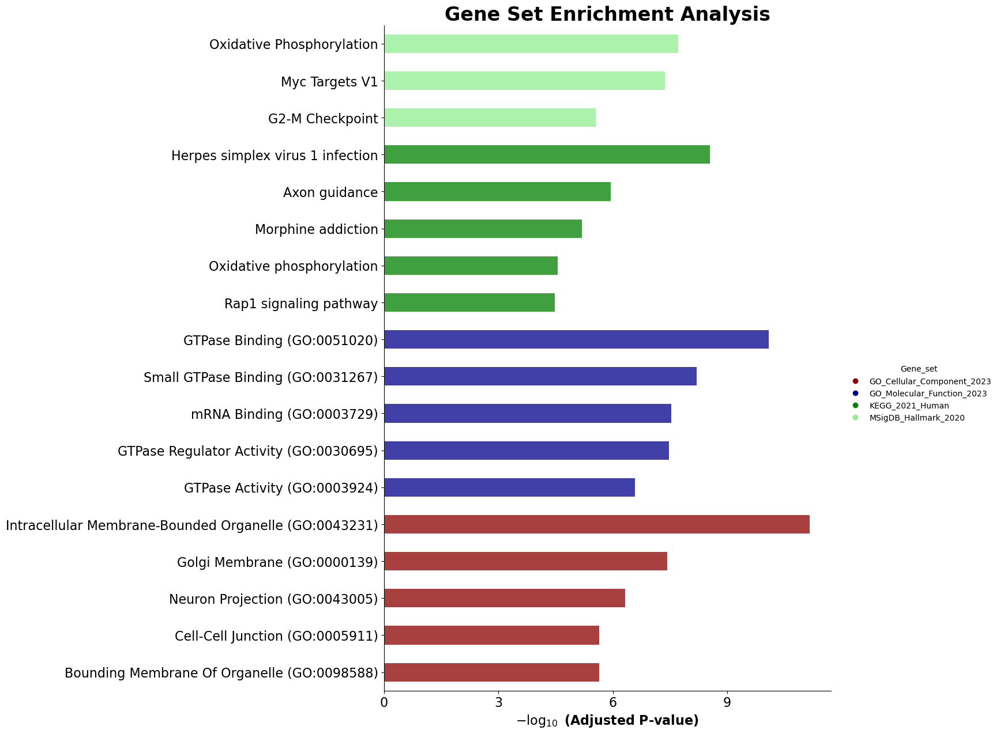

In [559]:
ax = barplot(curated_df[~curated_df['Term'].duplicated()],
              column="Adjusted P-value",
              group='Gene_set', # set group, so you could do a multi-sample/library comparsion
              size=20,
              top_term=5,
              figsize=(10,15),
              color=['darkred', 'darkblue','GREEN','lightgreen'], # set colors for group
              title = 'Gene Set Enrichment Analysis'
             )



# Show the plot
plt.show()


In [551]:
curated_df[~curated_df['Term'].duplicated()]

,Gene_set,Term,Overlap,P-value,Adjusted P-value,Old P-value,Old Adjusted P-value,Odds Ratio,Combined Score,Genes
750,GO_Cellular_Component_2023,Intracellular Membrane-Bounded Organelle (GO:0...,285/5175,4.860897e-14,6.902474e-12,0,0,1.807881,55.420546,EIF4A1;CCNK;MAML1;DCAF8;SMC3;NUDT3;ALKBH8;CCAR...
0,GO_Molecular_Function_2023,GTPase Binding (GO:0051020),98/225,7.708245e-14,8.047408e-11,0,0,2.861549,86.401313,USP6NL;CYFIP1;NCKAP1;DENND5B;STK19;ENO1;FNBP1L...
225,KEGG_2021_Human,Herpes simplex virus 1 infection,27/498,1.856336e-11,2.877320e-09,0,0,5.532420,136.705176,ZNF132;ZNF891;ZNF791;ZNF529;ZNF548;ZNF304;ZNF4...
1,GO_Molecular_Function_2023,Small GTPase Binding (GO:0031267),85/199,1.200965e-11,6.269040e-09,0,0,2.758754,69.369731,USP6NL;CYFIP1;NCKAP1;DOCK5;DOCK3;DENND5B;C15OR...
459,MSigDB_Hallmark_2020,Oxidative Phosphorylation,29/200,4.061605e-10,1.908954e-08,0,0,4.500638,97.323034,COX7B;MRPS11;MRPS12;HTRA2;NDUFB1;MRPS30;COX6A1...
1,GO_Molecular_Function_2023,mRNA Binding (GO:0003729),36/282,1.284133e-10,2.947085e-08,0,0,3.906413,88.971546,EIF4A1;DDX6;RBM25;DDX3X;RBM8A;CELF1;MRPS11;SRS...
2,GO_Molecular_Function_2023,GTPase Regulator Activity (GO:0030695),148/424,9.572158e-11,3.331111e-08,0,0,1.993232,45.983021,USP6NL;ERRFI1;TRIO;FAM13B;DENND5B;KNDC1;RAPGEF...
1410,GO_Cellular_Component_2023,Golgi Membrane (GO:0000139),149/427,8.494673e-11,3.763140e-08,0,0,1.992485,46.203728,SLC35B3;PI4K2B;SLC35B2;GALNT14;SLC35B4;GALNT13...
460,MSigDB_Hallmark_2020,Myc Targets V1,28/200,1.835290e-09,4.312931e-08,0,0,4.313953,86.779762,YWHAE;EIF4A1;SF3B3;KARS1;SRSF1;NOLC1;EEF1B2;SY...
3,GO_Molecular_Function_2023,GTPase Activity (GO:0003924),100/265,9.929445e-10,2.591585e-07,0,0,2.243059,46.499400,RAB3B;RAB3A;RAB3D;EFTUD2;RAB43;RGS6;RGS7;RAB2A...


In [400]:
len(set(df.Term))

1113

In [426]:
curated_dff.Term.tolist()

['Oxidative Phosphorylation',
 'Axon guidance',
 'Unfolded Protein Response',
 'GABAergic synapse',
 'Autophagy',
 'Pathways of neurodegeneration',
 'Protein Secretion',
 'Synaptic vesicle cycle',
 'Peroxisome']